In [1]:
# Load libraries.

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib as mpl

import seaborn as sns

import time

import datetime as dt
import re

from itertools import combinations
import itertools

import plotly.express as px

import pandas_datareader.data as web
from pandas_datareader import data as pdr

import yfinance as yf

(
    yf
    .pdr_override()
)

import warnings
warnings.filterwarnings("ignore")

# Setting baseline seed
np.random.seed(230926)

# Set print options.

np.set_printoptions(precision = 3)

plt.style.use("ggplot") # Grammar of Graphics Theme

mpl.rcParams["axes.grid"] = True
mpl.rcParams["grid.color"] = "grey"
mpl.rcParams["grid.alpha"] = 0.25

mpl.rcParams["axes.facecolor"] = "white"

mpl.rcParams["legend.fontsize"] = 14

from tabulate import tabulate

%matplotlib inline

In [2]:
# Loading Algorithm

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression

# Regularization
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet

# Decision Tree
from sklearn.tree import DecisionTreeRegressor

# ENSEMBLE

## Bagging
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor

## Boosting
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor

# Support Vector Machine
from sklearn.svm import SVR

# K-Nearest Neighbor
from sklearn.neighbors import KNeighborsRegressor

# Multi-layer Perceptron (Neural Networks)
from sklearn.neural_network import MLPRegressor

In [3]:
# for data split
from sklearn.model_selection import train_test_split

# for cross-validation
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV

# for assessment
from sklearn.metrics import mean_squared_error
from sklearn import metrics
from sklearn.metrics import mean_squared_error
from sklearn.metrics import roc_curve, auc

# for Feature Selection
from sklearn.feature_selection import chi2, f_regression
from sklearn.feature_selection import SelectKBest
from sklearn.preprocessing import PolynomialFeatures

from sklearn.decomposition import PCA
from sklearn.decomposition import KernelPCA

In [4]:
import statsmodels.tsa.arima.model as stats
import statsmodels.api as sm

In [5]:
from pandas.plotting import scatter_matrix

# for Pre-processing (Feature Engineering)
from sklearn.preprocessing import StandardScaler

# assumption checks for Time-Series
from statsmodels.graphics.tsaplots import plot_acf

#### We have defined a Backtesting Class below which is used across strategies for Backtesting and generate stats

In [6]:
class Backtest:
    def __init__(self,data, base_, tradingexp_):
        self.data=data
        self.base=base_
        self.tradingexp = tradingexp_
        ## Write any processing that needs to be done on the data
        self.data['Buy_Sell']= self.data['Position'] - self.data['Position'].shift(1)
        self.data['log_return']=np.log(self.data['Adj Close']/self.data['Adj Close'].shift(1))
        self.data['Strategy_return']=self.data['Position'].shift(1)*self.data['log_return']
        self.data['Expense']=np.where(abs(self.data['Buy_Sell'])> 0, self.tradingexp, 0)
        self.data['Capital']= self.base*self.data['Strategy_return'].cumsum().apply(np.exp)
        self.data['Adj Capital'] = self.base*self.data['Strategy_return'].cumsum().apply(np.exp) - self.data['Expense'].shift(1).cumsum()
        self.data['Adj return'] = np.log(self.data['Adj Capital']/self.data['Adj Capital'].shift(1))
        self.data['drawdown']=self.data['Adj return'].cumsum() - self.data['Adj return'].cumsum().cummax()

                
    def plot_backtest_buy_sell(self): 
        ax=\
        (
            self.data[['Adj Close',
                       'Position']]
            .plot(figsize=(18,8),
                  secondary_y=["Position"],
                  style=["red","b--"],
                  alpha=0.5
                 )
        )

        (
            ax.legend(loc="upper center"
                      ,shadow=True
                      ,fancybox=True
                      ,bbox_to_anchor=(0.55,1.10)
                      ,ncol=4
                     )
        )

        bx=\
        (
            self.data[self.data['Buy_Sell']>0]['Adj Close']
            .plot(style="g^",
                  markersize=12,
                  label='Buy')
        )

        bx.legend()

        cx=\
        (
            self.data[self.data['Buy_Sell']<0]['Adj Close']
            .plot(style="rv",
                  markersize=12,
                  label="Sell")
        )
        
        cx.legend()
        plt.title(f"Backtest Buy Sell Signals")
        plt.show()
      
    def calculate_cumm_return(self):
        res=100*(np.exp(self.data['Adj return'].sum()) -1)
        return res
    
    def calculate_max_drawdown(self):
        res=100* (np.exp(self.data['drawdown'].min()) - 1)
        return res
    
    def calculate_max_drawdown_duration(self):
        periods =\
        self.data[self.data['drawdown'] == 0].index[ 1 :   ].to_pydatetime() \
        - self.data[self.data['drawdown'] == 0].index[   : -1].to_pydatetime()
        print(f"Max Drawdown Duration: {periods.max()}")

    def calculate_return_byyear(self):
        grpByYear=self.data.groupby(self.data.index.year)
        return grpByYear['Adj return'].sum().apply(np.exp) -1

    def calculate_sharpe_ratio(self):
        res = np.sqrt(252) * (self.data['Adj return'].dropna().apply(np.exp).add(-1).mean()) / (self.data['Adj return'].dropna().apply(np.exp).add(-1).std())
        return res
    
    def calculate_sortino_ratio(self):
        res= np.sqrt(252) * (self.data['Adj return'].dropna().apply(np.exp).add(-1).mean()) / np.minimum(self.data['Adj return'].dropna().apply(np.exp).add(-1),0).std()
        return res

    def calculate_cagr(self):
        days =(self.data.index[-1] - self.data.index[0]).days
        CAGR =100*(((np.exp(self.data['Adj return'].sum()))**(365.0/days)) - 1)
        return CAGR
        
    def generate_quarterly_returns(self):
        self.data['quarter'] = self.data.index.quarter
        self.data['year'] = self.data.index.year
        result =\
        (
            self.data
            .groupby(['quarter', 'year'])['Adj return']
            .sum()
            .apply(np.exp)
            .add(-1)
            .multiply(100)
            .reset_index(name='Cumulative Return')
        )

        pivot=result.pivot(index='year', columns='quarter', values='Cumulative Return')
        pivot.columns=pivot.columns.map(lambda x: 'Q' + str(x))
        pivot=pivot.round(decimals=5)
        return pivot
        
    def plot_backtest_returns(self):
        ax =\
        (
            self.data[["log_return", "Adj return"]]
            .dropna()
            .cumsum()
            .apply(np.exp)
            .add(-1)
            .plot(figsize = [18, 7])
        )
        
        ax.set_title(f"Back Test Strategy vs Buy & Hold Return")
        ax.legend(["Buy & Hold Cumm Return","Strategy Cumm Return"])
        bx =\
        (
            self.data['Adj return']
            .cumsum()
            .cummax()
            .apply(np.exp)
            .add(-1)
            .plot(ax=ax)
        )
        plt.show()
    
    def plot_all_stats(self):
    
        portfolio_stats = pd.DataFrame({
            'Final Account Balance': f"$ {self.data['Adj Capital'].iloc[-1]:,.2f}",
            'Cummulative return': f"{self.calculate_cumm_return():.2f}%",
            'Strategy CAGR': f"{self.calculate_cagr():.2f}%",
            'Max Drawdown': f"{self.calculate_max_drawdown():.2f}%",
            'Sharpe Ratio': f"{self.calculate_sharpe_ratio():.3f}",
            'Sortino Ratio': f"{self.calculate_sortino_ratio():.3f}"
        }, index=['Value'])

        portfolio_stats.columns.name='Statistic'
        print(tabulate(portfolio_stats.transpose(), headers='keys', tablefmt='pretty', showindex=True,stralign='right'))
        self.plot_backtest_returns()
        print('% Return by Quarter:')
        print(tabulate(self.generate_quarterly_returns(), headers='keys', tablefmt='pretty', showindex=True,stralign='right'))
        self.plot_backtest_buy_sell()


# Table of Contents

# Part 1
## [Strategy 1](#strategy_1)
## [Strategy 2](#strategy_2)
## [Strategy 3](#strategy_3)
## [Strategy 4](#strategy_4)
## [Strategy 5](#strategy_5)

# Part 2
## [Strategy analysis and its evaluation metrics(#Part_2)

## [Part 4 Analysis Survivorship Bias](#Part_4_Analysis_Survivorship_Bias)
## [Part 4 Analysis Market Regime Change](#Part_4_Analysis_MarketRegime)

<a id='strategy_1'></a>

# Strategy 1: Supervised Machine Learning using CART

### Supervised learning of logistic regression and decision tree (CART). Focusing on feature engineering and hyperparameter tuning with long & short directional bets

In [7]:
capital = 1e5
start_date = dt.datetime(2004,11,1)
end_date = dt.datetime(2023,11,1)
spy = pdr.get_data_yahoo("SPY", start = start_date, end = end_date)

Y = np.log(spy["Adj Close"]).diff(1).shift(-1)            
Y.name = "Y_pred"

tnx_ticker = "^TNX" # CBOE 10 Year Treasury Note Yield Index
tnx_data = yf.download(tnx_ticker, start=start_date, end=end_date)

X1 = np.log(tnx_data['Adj Close'])
X1 = X1.ffill()
X1.name='10years futures'

vix_ticker = "^VIX"
vix = yf.download(vix_ticker, start=start_date, end=end_date)
X2 = np.log(vix['Adj Close'])
X2 = X2.ffill()
X2.name='vix'

X3 = np.log(spy['Volume'])

X4 = pd.concat([X1.shift(i) for i in [3,6,12]], axis=1)
X4.columns = ["Volume_3", "Volume_6", "Volume_12"]

X5 = pd.concat([Y.diff(i) for i in [3,6,12]], axis=1)
X5.columns = ["SPY_3", "SPY_6", "SPY_12"]

X = pd.concat([X1, X2, X3, X4, X5], axis=1)

X_traintest = X.loc[pd.to_datetime('2004-11-17'):]
X_traintest = X_traintest.ffill()

Y_traintest = Y.loc[pd.to_datetime('2004-11-17'):]

Y_traintest_binary = (Y_traintest > 0).astype(int)
index_ = Y_traintest_binary.index

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


<Axes: >

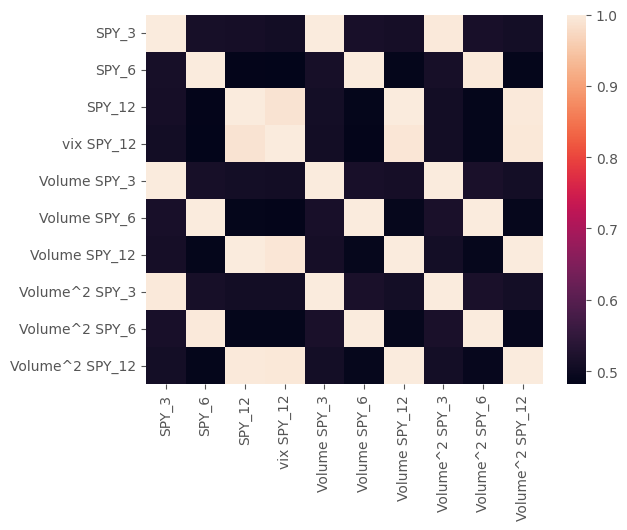

In [8]:
def get_polynomial_features(X_traintest, Y_traintest, *args):
    
    k = arg[0] if args else "all"
    
    Y_traintest_binary = (Y_traintest > 0).astype(int)
    
    poly = PolynomialFeatures(degree=3)
    X_poly = poly.fit_transform(X_traintest)

    feature_names = poly.get_feature_names_out(input_features=['10years futures', 'vix', 'Volume', 'Volume_3', 'Volume_6', 'Volume_12', 'SPY_3', 'SPY_6', 'SPY_12'])
    X_poly_df = pd.DataFrame(X_poly, columns=feature_names)
    X_poly_df.index = index_
    
    selector = SelectKBest(score_func=f_regression, k=k) 

    X_selected = selector.fit_transform(X_poly_df, Y_traintest_binary) #Y_traintest_binary
    X_columns = selector.get_feature_names_out()
    X_selected_df = pd.DataFrame(X_selected, columns = X_columns, index = index_)
    
#from sklearn.preprocessing import PolynomialFeatures
poly = PolynomialFeatures(degree=3)
X_poly = poly.fit_transform(X_traintest)

feature_names = poly.get_feature_names_out(input_features=['10years futures', 'vix', 'Volume', 'Volume_3', 'Volume_6', 'Volume_12', 'SPY_3', 'SPY_6', 'SPY_12'])
X_poly_df = pd.DataFrame(X_poly, columns=feature_names, index = index_)

# select the top 10 features based on the F-scores, arbitrary user-input before optimization
selector = SelectKBest(score_func=f_regression, k=10) 

X_selected = selector.fit_transform(X_poly_df, Y_traintest_binary) #Y_traintest_binary
X_columns = selector.get_feature_names_out()
X_selected_df = pd.DataFrame(X_selected, columns = X_columns, index = index_)

sns.heatmap(X_selected_df.corr())

In [9]:
X_selected_df.head()

,SPY_3,SPY_6,SPY_12,vix SPY_12,Volume SPY_3,Volume SPY_6,Volume SPY_12,Volume^2 SPY_3,Volume^2 SPY_6,Volume^2 SPY_12
Date,,,,,,,,,,
2004-11-17,-0.001105,0.000579,0.000997,0.002573,-0.019681,0.010317,0.017755,-0.350596,0.183778,0.316285
2004-11-18,-0.003994,-0.018759,-0.023694,-0.060739,-0.069010,-0.324089,-0.409361,-1.192272,-5.599182,-7.072407
2004-11-19,-0.001163,-0.003102,-0.008804,-0.022915,-0.020704,-0.055249,-0.156803,-0.368733,-0.983964,-2.792604
2004-11-22,0.000176,-0.000929,-0.004719,-0.012092,0.003062,-0.016208,-0.082300,0.053410,-0.282691,-1.435436
2004-11-23,0.013546,0.009551,0.003817,0.009692,0.237759,0.167648,0.066994,4.173258,2.942623,1.175907


In [10]:
#from sklearn.tree import DecisionTreeRegressor
#from sklearn.metrics import mean_squared_error

DT_model = DecisionTreeRegressor(criterion='squared_error')
get_polynomial_features(X_traintest, Y_traintest)

DT_model.fit(X_selected_df, Y_traintest.ffill())
DT_pred_train2 = DT_model.predict(X_selected_df)
train_result_mse = mean_squared_error(Y_traintest.ffill(), DT_pred_train2)
print('Mean Squared Error = ', train_result_mse)

DT_pred_train2_df = pd.DataFrame(DT_pred_train2, index=index_, )

X_traintest_dt = X_selected_df.copy()
X_traintest_dt['signal'] = DT_pred_train2_df
X_traintest_dt['signal'] = np.sign(X_traintest_dt['signal'])

Mean Squared Error =  0.0


strategy final balance =  1.3545067742602092e+21


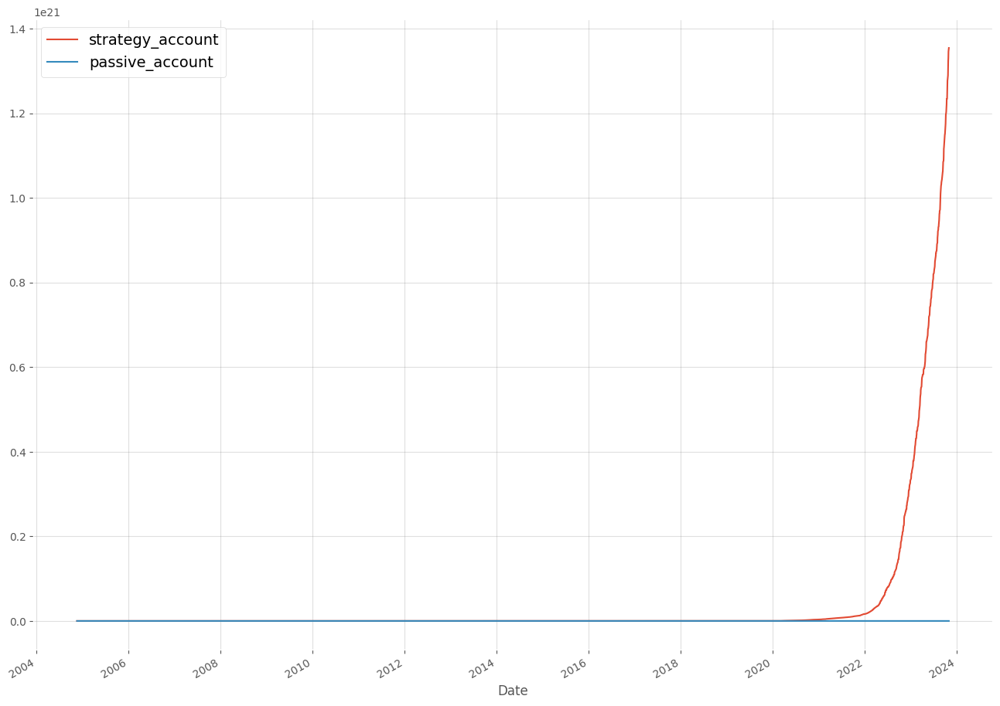

In [11]:
X_traintest_dt['strategy_return'] = X_traintest_dt["signal"] * Y
X_traintest_dt['strategy_account'] = X_traintest_dt['strategy_return'].cumsum().apply(np.exp) * capital
X_traintest_dt['passive_account'] = Y.cumsum().apply(np.exp) * capital

fig, ax1 = plt.subplots(figsize = [16,12])
X_traintest_dt['strategy_account'].plot(ax=ax1, label='strategy_account')
X_traintest_dt['passive_account'].plot(ax=ax1, label='passive_account')
ax1.legend()

print('strategy final balance = ', X_traintest_dt['strategy_account'].dropna()[-1])

In [12]:
reporting_df4=pd.concat([spy["Adj Close"],X_traintest_dt["signal"]],axis=1)
reporting_df4.columns=['Adj Close','Position']

+-----------------------+------------------------------------+
|             Statistic |                              Value |
+-----------------------+------------------------------------+
| Final Account Balance | $ 1,354,506,774,260,141,785,088.00 |
|    Cummulative return |            1352680735556469248.00% |
|         Strategy CAGR |                            605.74% |
|          Max Drawdown |                              0.00% |
|          Sharpe Ratio |                             12.964 |
|         Sortino Ratio |                                inf |
+-----------------------+------------------------------------+


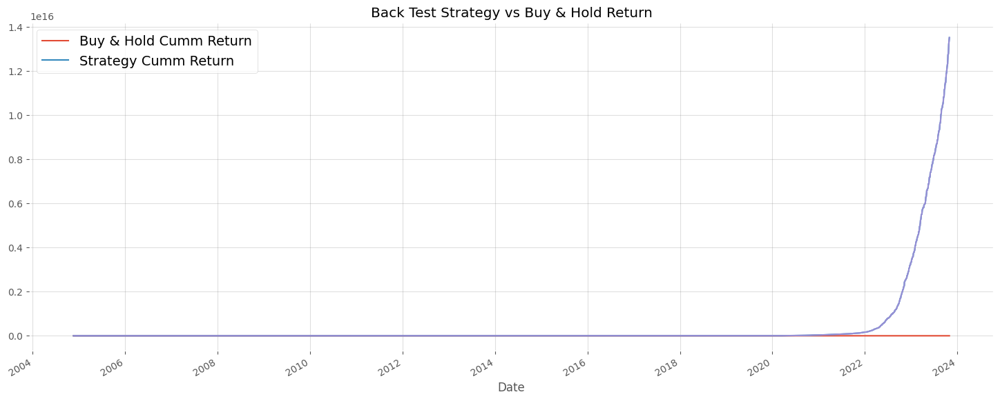

% Return by Quarter:
+------+-----------+-----------+-----------+-----------+
| year |        Q1 |        Q2 |        Q3 |        Q4 |
+------+-----------+-----------+-----------+-----------+
| 2004 |       nan |       nan |       nan |  10.85107 |
| 2005 |  38.12162 |  43.07671 |  33.83778 |  38.30602 |
| 2006 |  33.17752 |   48.6362 |  32.10229 |  24.20786 |
| 2007 |  36.36084 |  37.58499 |  75.12356 |  85.72676 |
| 2008 | 101.93905 |  60.72449 | 159.72742 | 773.38583 |
| 2009 | 236.27802 | 122.46951 |  67.35043 |   65.4733 |
| 2010 |  49.76747 | 107.80561 |  70.23891 |  38.60092 |
| 2011 |  47.73956 |   48.3395 |  165.8824 | 130.16306 |
| 2012 |  33.99653 |  66.75982 |  37.55491 |  43.38707 |
| 2013 |  33.45987 |  58.42374 |  33.11571 |  38.61103 |
| 2014 |  41.01289 |  32.54733 |  32.09403 |   51.3649 |
| 2015 |   54.2541 |  36.02143 |  79.92571 |  59.85247 |
| 2016 |  72.08254 |  48.09708 |  30.88477 |  28.91051 |
| 2017 |  22.44906 |  22.92286 |  19.96177 |   19.0595 |
| 2018 |  

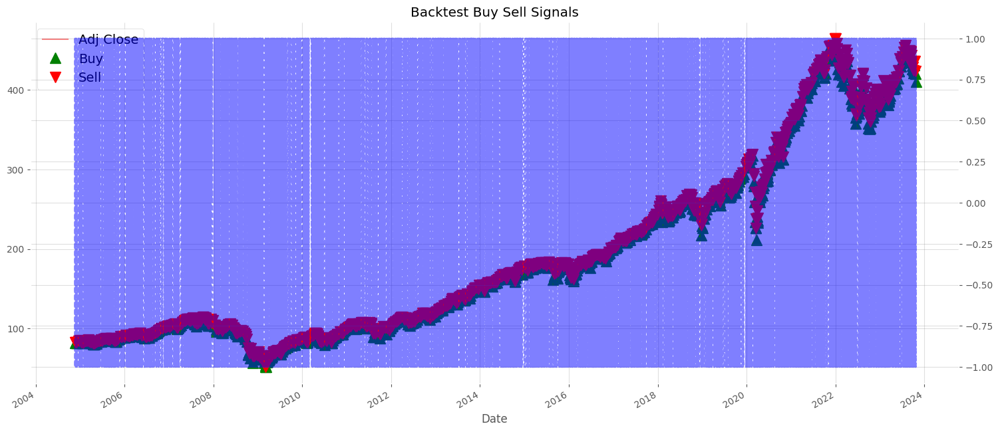

In [13]:
#Generate Stats
Backtest_Strategy4=Backtest(reporting_df4,100000,0)
Backtest_Strategy4.plot_all_stats()

### ~Strategy 1 Ends

<a id='strategy_2'></a>

# Strategy 2: Supervised Machine Learning using ERT and LASSO
### Using Other global indices together with Crude Oil Prices, Bond and S&P futures to fit Machine Learning models to predict and trade on SPY.

### 1. Data Sourcing

In [14]:
start="2004-11-1"
end="2023-11-1"

stock_ticker = ["SPY",'^VIX','ES=F','CL=F','IEF','ZB=F']

currency_ticker = ["DEXJPUS", "DEXUSUK"]

index_ticker = ["^IXIC", "DJIA", "^GDAXI","^HSI","^N225"]


stock_data = pdr.get_data_yahoo(stock_ticker,start=start,end=end)
#currency_data = pdr.get_data_fred(currency_ticker)
index_data = pdr.get_data_yahoo(index_ticker,start=start,end=end)

[*********************100%***********************]  6 of 6 completed
[*********************100%***********************]  5 of 5 completed


In [15]:
stock_data

Adj Close                                                         \
                 CL=F     ES=F        IEF         SPY        ZB=F       ^VIX   
Date                                                                           
2004-11-01  50.130001  1130.75  52.784016   78.617935  113.125000  16.270000   
2004-11-02  49.619999  1130.50  52.913227   78.645638  113.250000  16.180000   
2004-11-03  50.880001  1145.00  52.894760   79.636078  113.437500  14.040000   
2004-11-04  48.820000  1160.50  52.863995   80.723495  113.593803  13.970000   
2004-11-05  49.610001  1167.75  52.470142   81.229050  112.250000  13.840000   
...               ...      ...        ...         ...         ...        ...   
2023-10-25  85.389999  4209.75  89.011925  417.549988  108.406250  20.190001   
2023-10-26  83.209999  4156.50  89.690033  412.549988  109.875000  20.680000   
2023-10-27  85.540001  4137.75  89.829643  410.679993  109.500000  21.270000   
2023-10-30  82.309998  4185.75  89.530472  415.589996  109.281250  19.750000   
2023-10-31  81.019997  4212.25  89.340996  418.200012  109.437500  18.139999   

                Close                                  ...       Open  \
                 CL=F     ES=F        IEF         SPY  ...        IEF   
Date                                                   ...              
2004-11-01  50.130001  1130.75  85.779999  113.510002  ...  86.059998   
2004-11-02  49.619999  1130.50  85.989998  113.550003  ...  85.809998   
2004-11-03  50.880001  1145.00  85.959999  114.980003  ...  85.519997   
2004-11-04  48.820000  1160.50  85.910004  116.550003  ...  86.099998   
2004-11-05  49.610001  1167.75  85.269997  117.279999  ...  85.309998   
...               ...      ...        ...         ...  ...        ...   
2023-10-25  85.389999  4209.75  89.260002  417.549988  ...  89.580002   
2023-10-26  83.209999  4156.50  89.940002  412.549988  ...  89.349998   
2023-10-27  85.540001  4137.75  90.080002  410.679993  ...  89.870003   
2023-10-30  82.309998  4185.75  89.779999  415.589996  ...  89.639999   
2023-10-31  81.019997  4212.25  89.589996  418.200012  ...  89.830002   

                                                 Volume             \
                   SPY        ZB=F       ^VIX      CL=F       ES=F   
Date                                                                 
2004-11-01  113.559998  113.875000  16.430000  133138.0   494666.0   
2004-11-02  113.669998  113.250000  15.990000   82754.0   831105.0   
2004-11-03  115.029999  113.625000  15.050000  143701.0   981514.0   
2004-11-04  114.779999  113.312500  13.830000  121094.0   897586.0   
2004-11-05  117.050003  113.531303  13.670000  115766.0   833448.0   
...                ...         ...        ...       ...        ...   
2023-10-25  421.890015  110.281250  19.389999  429459.0  1981633.0   
2023-10-26  416.450012  108.406250  21.780001  341792.0  2419407.0   
2023-10-27  414.190002  109.781250  20.389999  333760.0  2195767.0   
2023-10-30  413.559998  109.687500  21.129999  356928.0  1904610.0   
2023-10-31  416.179993  109.000000  19.860001  346007.0  1836212.0   

                                                    
                   IEF          SPY      ZB=F ^VIX  
Date                                                
2004-11-01    128800.0   36720900.0  147349.0  0.0  
2004-11-02    191300.0   56210000.0  427746.0  0.0  
2004-11-03    139800.0   76960200.0  269523.0  0.0  
2004-11-04    435100.0   55350300.0  420930.0  0.0  
2004-11-05    886400.0   63287200.0  190298.0  0.0  
...                ...          ...       ...  ...  
2023-10-25  15170200.0   94223200.0  506995.0  0.0  
2023-10-26  15901300.0  115156800.0  596519.0  0.0  
2023-10-27  11628200.0  107367700.0  394682.0  0.0  
2023-10-30  11022500.0   86562700.0  441993.0  0.0  
2023-10-31  11574700.0   79665200.0  725179.0  0.0  

[4792 rows x 36 columns]

In [16]:
index_data.tail()

Adj Close                                                          \
                 DJIA        ^GDAXI          ^HSI         ^IXIC         ^N225   
Date                                                                            
2023-10-25  20.980000  14892.179688  17085.330078  12821.219727  31269.919922   
2023-10-26  20.950001  14731.049805  17044.609375  12595.610352  30601.779297   
2023-10-27  20.820000  14687.410156  17398.730469  12643.009766  30991.689453   
2023-10-30  20.990000  14716.540039  17406.359375  12789.480469  30696.960938   
2023-10-31  21.200001  14810.339844  17112.480469  12851.240234  30858.849609   

                Close                                                          \
                 DJIA        ^GDAXI          ^HSI         ^IXIC         ^N225   
Date                                                                            
2023-10-25  20.980000  14892.179688  17085.330078  12821.219727  31269.919922   
2023-10-26  20.950001  14731.049805  17044.609375  12595.610352  30601.779297   
2023-10-27  20.820000  14687.410156  17398.730469  12643.009766  30991.689453   
2023-10-30  20.990000  14716.540039  17406.359375  12789.480469  30696.960938   
2023-10-31  21.200001  14810.339844  17112.480469  12851.240234  30858.849609   

            ...       Open                                            \
            ...       DJIA        ^GDAXI          ^HSI         ^IXIC   
Date        ...                                                        
2023-10-25  ...  21.010000  14870.629883  17465.429688  13039.860352   
2023-10-26  ...  21.059999  14696.219727  17085.119141  12768.969727   
2023-10-27  ...  20.990000  14757.110352  17160.230469  12718.690430   
2023-10-30  ...  20.910000  14770.950195  17225.650391  12750.469727   
2023-10-31  ...  21.049999  14741.440430  17337.699219  12786.620117   

                           Volume                                           \
                   ^N225     DJIA       ^GDAXI          ^HSI         ^IXIC   
Date                                                                         
2023-10-25  31302.509766   6600.0   88086100.0  2.499934e+09  4.599850e+09   
2023-10-26  30902.919922  43600.0  121803600.0  1.967216e+09  4.894900e+09   
2023-10-27  30713.789062  15400.0   86539200.0  2.452090e+09  4.172100e+09   
2023-10-30  30663.480469  16100.0   76179000.0  2.665231e+09  4.149320e+09   
2023-10-31  30694.960938   9300.0   75370200.0  2.112804e+09  4.315630e+09   

                         
                  ^N225  
Date                     
2023-10-25   78700000.0  
2023-10-26   85600000.0  
2023-10-27   89100000.0  
2023-10-30  187000000.0  
2023-10-31  134300000.0  

[5 rows x 30 columns]

In [17]:
## We optimized return period by running an iteration for different values of return period from 5 to 50 
## in multiples of 5

return_period = 5

In [18]:
Y =\
    (stock_data.loc[ : , ("Adj Close", "SPY")]
     .diff(return_period)
     .shift(-return_period)
    )
Y

Date
2004-11-01    2.493378
2004-11-02    2.306381
2004-11-03    1.378288
2004-11-04    0.907242
2004-11-05    1.045853
                ...   
2023-10-25         NaN
2023-10-26         NaN
2023-10-27         NaN
2023-10-30         NaN
2023-10-31         NaN
Name: (Adj Close, SPY), Length: 4792, dtype: float64

In [19]:
Y.name =\
    (Y
     .name[-1]
     +
     "_pred")

Y

Date
2004-11-01    2.493378
2004-11-02    2.306381
2004-11-03    1.378288
2004-11-04    0.907242
2004-11-05    1.045853
                ...   
2023-10-25         NaN
2023-10-26         NaN
2023-10-27         NaN
2023-10-30         NaN
2023-10-31         NaN
Name: SPY_pred, Length: 4792, dtype: float64

In [20]:
X1 =\
    (stock_data.loc[ : , ("Adj Close", ("CL=F", "ES=F","IEF","ZB=F","^VIX")
                             )
                       ]
     .diff(return_period)
    )

X1.columns =\
    (X1
     .columns
     .droplevel()
    )

X1

,CL=F,ES=F,IEF,ZB=F,^VIX
Date,,,,,
2004-11-01,NaN,NaN,NaN,NaN,NaN
2004-11-02,NaN,NaN,NaN,NaN,NaN
2004-11-03,NaN,NaN,NaN,NaN,NaN
2004-11-04,NaN,NaN,NaN,NaN,NaN
2004-11-05,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2023-10-25,-2.930000,-132.50,-0.129631,-0.87500,0.970001
2023-10-26,-6.160004,-146.50,0.987259,2.03125,-0.719999
2023-10-27,-3.209999,-110.75,0.608307,1.03125,-0.439999


In [21]:
X2 =\
    (index_data.loc[ : , ("Adj Close", ("^GDAXI","^HSI","^IXIC","^N225")
                             )
                       ]
     .diff(return_period)
    )

X2.columns =\
    (X2
     .columns
     .droplevel()
    )

X2

,^GDAXI,^HSI,^IXIC,^N225
Date,,,,
2004-11-01,NaN,NaN,NaN,NaN
2004-11-02,NaN,NaN,NaN,NaN
2004-11-03,NaN,NaN,NaN,NaN
2004-11-04,NaN,NaN,NaN,NaN
2004-11-05,NaN,NaN,NaN,NaN
...,...,...,...,...
2023-10-25,-202.730469,-647.189453,-493.080078,-772.330078
2023-10-26,-314.180664,-251.281250,-590.569336,-828.839844
2023-10-27,-111.059570,226.599609,-340.799805,-267.669922


In [22]:
index_data

Adj Close                                                          \
                 DJIA        ^GDAXI          ^HSI         ^IXIC         ^N225   
Date                                                                            
2004-11-01        NaN   4012.639893  13094.250000   1979.869995  10734.709961   
2004-11-02        NaN   4037.570068  13308.740234   1984.790039  10887.809570   
2004-11-03        NaN   4039.040039  13397.669922   2004.329956           NaN   
2004-11-04        NaN   4041.379883  13369.089844   2023.630005  10946.269531   
2004-11-05        NaN   4063.580078  13494.950195   2038.939941  11061.769531   
...               ...           ...           ...           ...           ...   
2023-10-25  20.980000  14892.179688  17085.330078  12821.219727  31269.919922   
2023-10-26  20.950001  14731.049805  17044.609375  12595.610352  30601.779297   
2023-10-27  20.820000  14687.410156  17398.730469  12643.009766  30991.689453   
2023-10-30  20.990000  14716.540039  17406.359375  12789.480469  30696.960938   
2023-10-31  21.200001  14810.339844  17112.480469  12851.240234  30858.849609   

                Close                                                          \
                 DJIA        ^GDAXI          ^HSI         ^IXIC         ^N225   
Date                                                                            
2004-11-01        NaN   4012.639893  13094.250000   1979.869995  10734.709961   
2004-11-02        NaN   4037.570068  13308.740234   1984.790039  10887.809570   
2004-11-03        NaN   4039.040039  13397.669922   2004.329956           NaN   
2004-11-04        NaN   4041.379883  13369.089844   2023.630005  10946.269531   
2004-11-05        NaN   4063.580078  13494.950195   2038.939941  11061.769531   
...               ...           ...           ...           ...           ...   
2023-10-25  20.980000  14892.179688  17085.330078  12821.219727  31269.919922   
2023-10-26  20.950001  14731.049805  17044.609375  12595.610352  30601.779297   
2023-10-27  20.820000  14687.410156  17398.730469  12643.009766  30991.689453   
2023-10-30  20.990000  14716.540039  17406.359375  12789.480469  30696.960938   
2023-10-31  21.200001  14810.339844  17112.480469  12851.240234  30858.849609   

            ...       Open                                            \
            ...       DJIA        ^GDAXI          ^HSI         ^IXIC   
Date        ...                                                        
2004-11-01  ...        NaN   3961.179932  13039.400391   1975.479980   
2004-11-02  ...        NaN   4017.830078  13160.080078   1981.469971   
2004-11-03  ...        NaN   4061.409912  13316.120117   2014.449951   
2004-11-04  ...        NaN   4032.610107  13485.889648   1998.150024   
2004-11-05  ...        NaN   4075.010010  13497.950195   2035.040039   
...         ...        ...           ...           ...           ...   
2023-10-25  ...  21.010000  14870.629883  17465.429688  13039.860352   
2023-10-26  ...  21.059999  14696.219727  17085.119141  12768.969727   
2023-10-27  ...  20.990000  14757.110352  17160.230469  12718.690430   
2023-10-30  ...  20.910000  14770.950195  17225.650391  12750.469727   
2023-10-31  ...  21.049999  14741.440430  17337.699219  12786.620117   

                           Volume                                           \
                   ^N225     DJIA       ^GDAXI          ^HSI         ^IXIC   
Date                                                                         
2004-11-01  10731.019531      NaN   65754300.0  1.984324e+08  1.522820e+09   
2004-11-02  10775.000000      NaN   88857800.0  3.862780e+08  1.845080e+09   
2004-11-03           NaN      NaN  112707800.0  3.527140e+08  1.957400e+09   
2004-11-04  10990.700195      NaN   85037600.0  3.084676e+08  1.823490e+09   
2004-11-05  11040.059570      NaN  123958100.0  3.623888e+08  1.908970e+09   
...                  ...      ...          ...           ...           ...   
2023-10-25  31302.509766   6600

In [23]:
X3 =\
    (
    pd
    .concat([np
             .log(stock_data.loc[ : , ("Adj Close", "SPY")
                                ]
                 )
             .diff(i) for i in [return_period, 
                                return_period * 3, 
                                return_period * 6, 
                                return_period * 12]
            ],
           axis = 1
           )
    .dropna()
)

X3.columns = ["SPY_DT", "SPY_3DT", "SPY_6DT", "SPY_12DT"]

In [24]:
X3

,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
Date,,,,
2005-01-26,-0.008409,-0.013556,-0.021719,0.039919
2005-01-27,-0.000596,-0.004927,-0.023499,0.041271
2005-01-28,0.005551,-0.009999,-0.024243,0.028756
2005-01-31,0.013720,-0.002366,-0.017466,0.021391
2005-02-01,0.017219,-0.000757,-0.004447,0.021475
...,...,...,...,...
2023-10-25,-0.029869,-0.016885,-0.063536,-0.085620
2023-10-26,-0.033091,-0.028555,-0.084169,-0.083658
2023-10-27,-0.025270,-0.044901,-0.076590,-0.085331


In [25]:
X=\
(
    pd
    .concat([X1, X2, X3],
            axis = 1)
)

X

,CL=F,ES=F,IEF,ZB=F,^VIX,^GDAXI,^HSI,^IXIC,^N225,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
Date,,,,,,,,,,,,,
2004-11-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-11-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-11-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-11-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-11-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-10-25,-2.930000,-132.50,-0.129631,-0.87500,0.970001,-202.730469,-647.189453,-493.080078,-772.330078,-0.029869,-0.016885,-0.063536,-0.085620
2023-10-26,-6.160004,-146.50,0.987259,2.03125,-0.719999,-314.180664,-251.281250,-590.569336,-828.839844,-0.033091,-0.028555,-0.084169,-0.083658
2023-10-27,-3.209999,-110.75,0.608307,1.03125,-0.439999,-111.059570,226.599609,-340.799805,-267.669922,-0.025270,-0.044901,-0.076590,-0.085331


In [26]:
X[60:70]

,CL=F,ES=F,IEF,ZB=F,^VIX,^GDAXI,^HSI,^IXIC,^N225,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
Date,,,,,,,,,,,,,
2005-01-24,0.430000,-17.50,0.204334,1.281303,2.219999,-43.619629,-234.660156,NaN,-197.609375,NaN,NaN,NaN,NaN
2005-01-25,1.259998,-26.00,0.024780,0.031197,1.590000,-16.759766,-20.160156,-86.090088,-146.349609,NaN,NaN,NaN,NaN
2005-01-26,1.230000,-10.25,0.006161,-0.031303,0.259999,-31.429688,-54.950195,-27.500122,-28.769531,-0.008409,-0.013556,-0.021719,0.039919
2005-01-27,1.930000,-1.75,-0.167149,-0.281303,-0.590000,-4.020020,85.320312,1.270020,56.540039,-0.000596,-0.004927,-0.023499,0.041271
2005-01-28,-1.349998,6.25,0.000000,0.281303,-1.120000,-11.890137,169.040039,1.559937,82.209961,0.005551,-0.009999,-0.024243,0.028756
2005-01-31,-0.610001,15.50,0.024761,0.125000,-1.830000,52.959961,334.700195,53.709961,98.099609,0.013720,-0.002366,-0.017466,0.021391
2005-02-01,-2.520000,19.50,0.186283,0.875000,-2.030001,46.020020,-5.799805,48.750000,107.490234,0.017219,-0.000757,-0.004447,0.021475
2005-02-02,-2.090000,20.00,0.180141,0.937500,-1.780000,82.189941,-67.879883,28.970093,30.569336,0.017252,0.009181,-0.001676,0.025948
2005-02-03,-2.389999,14.75,0.173645,0.937500,-1.450000,65.229980,-113.580078,10.489868,48.040039,0.012945,0.003284,-0.011949,0.025312


In [27]:
Y

Date
2004-11-01    2.493378
2004-11-02    2.306381
2004-11-03    1.378288
2004-11-04    0.907242
2004-11-05    1.045853
                ...   
2023-10-25         NaN
2023-10-26         NaN
2023-10-27         NaN
2023-10-30         NaN
2023-10-31         NaN
Name: SPY_pred, Length: 4792, dtype: float64

In [28]:
data =\
(
pd
.concat([Y, X],
        axis = 1)
.dropna()
.iloc[ : :return_period, :]
)

data

,SPY_pred,CL=F,ES=F,IEF,ZB=F,^VIX,^GDAXI,^HSI,^IXIC,^N225,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
Date,,,,,,,,,,,,,,
2005-01-26,1.423775,1.230000,-10.25,0.006161,-0.031303,0.259999,-31.429688,-54.950195,-27.500122,-28.769531,-0.008409,-0.013556,-0.021719,0.039919
2005-02-02,0.027916,-2.090000,20.00,0.180141,0.937500,-1.780000,82.189941,-67.879883,28.970093,30.569336,0.017252,0.009181,-0.001676,0.025948
2005-02-14,-1.451729,2.160000,5.50,-0.024918,-0.250000,-0.209999,20.049805,222.230469,0.879883,132.339844,0.005067,0.034822,-0.001574,0.020918
2005-03-01,0.767754,0.529999,25.25,-0.309975,-0.750000,-1.100000,60.410156,-29.369141,40.930054,182.820312,0.021933,0.009615,0.024973,0.020509
2005-03-08,-1.528526,2.910000,10.50,-0.037354,0.281197,0.360000,12.879883,-179.440430,2.300049,106.379883,0.009033,0.013580,0.048402,0.030549
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-09-14,-17.386993,3.290001,49.75,-0.109406,-0.250000,-1.580000,86.629883,-154.150391,177.219727,177.023438,0.012310,0.016410,0.000511,0.029702
2023-09-26,-4.290009,-0.809998,-175.25,-1.104027,-4.000000,4.830001,-408.610352,-530.269531,-614.580078,-927.539062,-0.038757,-0.049879,-0.047360,-0.036523
2023-10-04,11.660004,-9.459999,-15.75,-0.649895,-2.000000,0.360001,-117.530273,-416.029297,143.160156,-1845.019531,-0.003268,-0.046652,-0.027751,-0.037540


In [29]:
data

,SPY_pred,CL=F,ES=F,IEF,ZB=F,^VIX,^GDAXI,^HSI,^IXIC,^N225,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
Date,,,,,,,,,,,,,,
2005-01-26,1.423775,1.230000,-10.25,0.006161,-0.031303,0.259999,-31.429688,-54.950195,-27.500122,-28.769531,-0.008409,-0.013556,-0.021719,0.039919
2005-02-02,0.027916,-2.090000,20.00,0.180141,0.937500,-1.780000,82.189941,-67.879883,28.970093,30.569336,0.017252,0.009181,-0.001676,0.025948
2005-02-14,-1.451729,2.160000,5.50,-0.024918,-0.250000,-0.209999,20.049805,222.230469,0.879883,132.339844,0.005067,0.034822,-0.001574,0.020918
2005-03-01,0.767754,0.529999,25.25,-0.309975,-0.750000,-1.100000,60.410156,-29.369141,40.930054,182.820312,0.021933,0.009615,0.024973,0.020509
2005-03-08,-1.528526,2.910000,10.50,-0.037354,0.281197,0.360000,12.879883,-179.440430,2.300049,106.379883,0.009033,0.013580,0.048402,0.030549
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-09-14,-17.386993,3.290001,49.75,-0.109406,-0.250000,-1.580000,86.629883,-154.150391,177.219727,177.023438,0.012310,0.016410,0.000511,0.029702
2023-09-26,-4.290009,-0.809998,-175.25,-1.104027,-4.000000,4.830001,-408.610352,-530.269531,-614.580078,-927.539062,-0.038757,-0.049879,-0.047360,-0.036523
2023-10-04,11.660004,-9.459999,-15.75,-0.649895,-2.000000,0.360001,-117.530273,-416.029297,143.160156,-1845.019531,-0.003268,-0.046652,-0.027751,-0.037540


In [30]:
Y = data.loc[ : , Y.name]
Y

Date
2005-01-26     1.423775
2005-02-02     0.027916
2005-02-14    -1.451729
2005-03-01     0.767754
2005-03-08    -1.528526
                ...    
2023-09-14   -17.386993
2023-09-26    -4.290009
2023-10-04    11.660004
2023-10-12    -7.230011
2023-10-20   -10.510010
Name: SPY_pred, Length: 725, dtype: float64

In [31]:
X = data.loc[ : , X.columns]
X

,CL=F,ES=F,IEF,ZB=F,^VIX,^GDAXI,^HSI,^IXIC,^N225,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
Date,,,,,,,,,,,,,
2005-01-26,1.230000,-10.25,0.006161,-0.031303,0.259999,-31.429688,-54.950195,-27.500122,-28.769531,-0.008409,-0.013556,-0.021719,0.039919
2005-02-02,-2.090000,20.00,0.180141,0.937500,-1.780000,82.189941,-67.879883,28.970093,30.569336,0.017252,0.009181,-0.001676,0.025948
2005-02-14,2.160000,5.50,-0.024918,-0.250000,-0.209999,20.049805,222.230469,0.879883,132.339844,0.005067,0.034822,-0.001574,0.020918
2005-03-01,0.529999,25.25,-0.309975,-0.750000,-1.100000,60.410156,-29.369141,40.930054,182.820312,0.021933,0.009615,0.024973,0.020509
2005-03-08,2.910000,10.50,-0.037354,0.281197,0.360000,12.879883,-179.440430,2.300049,106.379883,0.009033,0.013580,0.048402,0.030549
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-09-14,3.290001,49.75,-0.109406,-0.250000,-1.580000,86.629883,-154.150391,177.219727,177.023438,0.012310,0.016410,0.000511,0.029702
2023-09-26,-0.809998,-175.25,-1.104027,-4.000000,4.830001,-408.610352,-530.269531,-614.580078,-927.539062,-0.038757,-0.049879,-0.047360,-0.036523
2023-10-04,-9.459999,-15.75,-0.649895,-2.000000,0.360001,-117.530273,-416.029297,143.160156,-1845.019531,-0.003268,-0.046652,-0.027751,-0.037540


In [32]:
data.describe()

,SPY_pred,CL=F,ES=F,IEF,ZB=F,^VIX,^GDAXI,^HSI,^IXIC,^N225,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
count,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000
mean,0.526179,0.123559,2.700800,0.019039,-0.043276,0.059297,7.694437,-0.532026,9.515702,15.787591,0.001665,0.004148,0.009890,0.021729
std,5.182232,3.465219,60.877004,0.769193,2.081091,3.708021,274.924075,665.642937,205.389983,514.516503,0.026282,0.041535,0.056479,0.076961
min,-51.242493,-14.400002,-546.500000,-3.903259,-7.562500,-25.580002,-2783.589844,-4307.169922,-1536.790039,-2769.488281,-0.198077,-0.306063,-0.352248,-0.440878
25%,-1.224106,-1.879997,-17.500000,-0.412186,-1.218697,-1.600002,-119.850098,-379.660156,-46.600098,-222.830078,-0.009717,-0.011404,-0.011036,-0.005915
50%,0.580978,0.290001,6.500000,0.079796,0.031250,-0.210000,25.419922,39.419922,14.669922,33.291016,0.003974,0.010227,0.017276,0.034306
75%,2.360832,2.190002,28.750000,0.448051,1.125000,1.280001,148.050293,415.898438,76.030029,311.980469,0.014739,0.026802,0.042280,0.064735
max,20.989624,14.860001,390.750000,3.175758,18.187500,35.850002,1307.689453,2534.169922,913.479980,2197.191406,0.177339,0.159500,0.194368,0.325572


## 2. Full In-Sample Backtesting

In [33]:
X

,CL=F,ES=F,IEF,ZB=F,^VIX,^GDAXI,^HSI,^IXIC,^N225,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
Date,,,,,,,,,,,,,
2005-01-26,1.230000,-10.25,0.006161,-0.031303,0.259999,-31.429688,-54.950195,-27.500122,-28.769531,-0.008409,-0.013556,-0.021719,0.039919
2005-02-02,-2.090000,20.00,0.180141,0.937500,-1.780000,82.189941,-67.879883,28.970093,30.569336,0.017252,0.009181,-0.001676,0.025948
2005-02-14,2.160000,5.50,-0.024918,-0.250000,-0.209999,20.049805,222.230469,0.879883,132.339844,0.005067,0.034822,-0.001574,0.020918
2005-03-01,0.529999,25.25,-0.309975,-0.750000,-1.100000,60.410156,-29.369141,40.930054,182.820312,0.021933,0.009615,0.024973,0.020509
2005-03-08,2.910000,10.50,-0.037354,0.281197,0.360000,12.879883,-179.440430,2.300049,106.379883,0.009033,0.013580,0.048402,0.030549
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-09-14,3.290001,49.75,-0.109406,-0.250000,-1.580000,86.629883,-154.150391,177.219727,177.023438,0.012310,0.016410,0.000511,0.029702
2023-09-26,-0.809998,-175.25,-1.104027,-4.000000,4.830001,-408.610352,-530.269531,-614.580078,-927.539062,-0.038757,-0.049879,-0.047360,-0.036523
2023-10-04,-9.459999,-15.75,-0.649895,-2.000000,0.360001,-117.530273,-416.029297,143.160156,-1845.019531,-0.003268,-0.046652,-0.027751,-0.037540


### 2.1 Feature Engineering

#### 2.1.1 Standardize

In [34]:
# # Standardize the features (important for PCA)
# scaler =\
# (
#     StandardScaler()
#     .fit(X)
# )

# X =\
# (
#     pd
#     .DataFrame(scaler.fit_transform(X),
#                columns = X.columns,
#                index = X.index)
# )

# X

## Try divide by max-min

In [35]:
X.describe()

,CL=F,ES=F,IEF,ZB=F,^VIX,^GDAXI,^HSI,^IXIC,^N225,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
count,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000,725.000000
mean,0.123559,2.700800,0.019039,-0.043276,0.059297,7.694437,-0.532026,9.515702,15.787591,0.001665,0.004148,0.009890,0.021729
std,3.465219,60.877004,0.769193,2.081091,3.708021,274.924075,665.642937,205.389983,514.516503,0.026282,0.041535,0.056479,0.076961
min,-14.400002,-546.500000,-3.903259,-7.562500,-25.580002,-2783.589844,-4307.169922,-1536.790039,-2769.488281,-0.198077,-0.306063,-0.352248,-0.440878
25%,-1.879997,-17.500000,-0.412186,-1.218697,-1.600002,-119.850098,-379.660156,-46.600098,-222.830078,-0.009717,-0.011404,-0.011036,-0.005915
50%,0.290001,6.500000,0.079796,0.031250,-0.210000,25.419922,39.419922,14.669922,33.291016,0.003974,0.010227,0.017276,0.034306
75%,2.190002,28.750000,0.448051,1.125000,1.280001,148.050293,415.898438,76.030029,311.980469,0.014739,0.026802,0.042280,0.064735
max,14.860001,390.750000,3.175758,18.187500,35.850002,1307.689453,2534.169922,913.479980,2197.191406,0.177339,0.159500,0.194368,0.325572


<Axes: title={'center': 'Correlation Matrix'}>

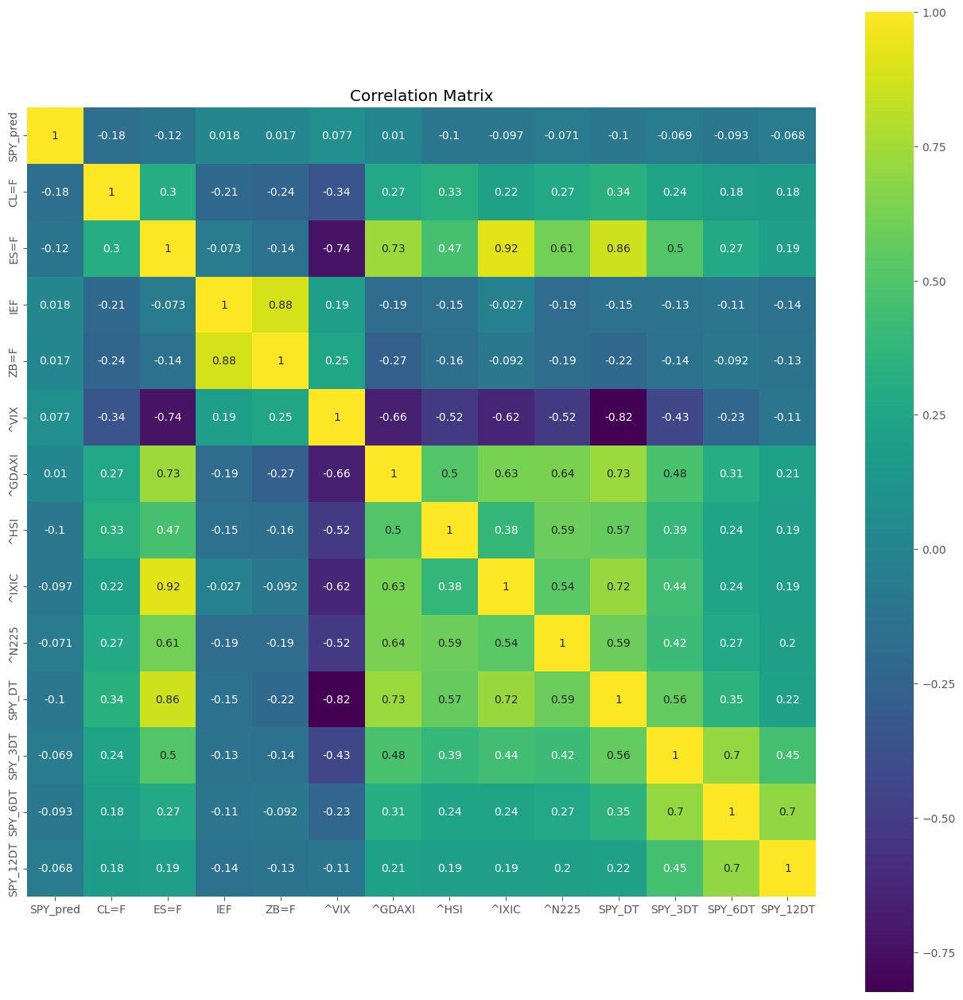

In [36]:
correlation = data.corr()

plt.figure(figsize =[16, 16]
          )

plt.title("Correlation Matrix")

sns.heatmap(correlation,
            vmax = 1,
            square = True,
            cmap = "viridis",
            annot = True)

#### 2.1.2 Add Polynomial Features

In [37]:
# from sklearn.preprocessing import PolynomialFeatures

# poly = PolynomialFeatures(degree=3)
# X_poly = poly.fit_transform(X)

# columns = [f"Feature{i+1}" for i in range(X_poly.shape[1])]
# df_poly = pd.DataFrame(data=X_poly, columns=columns,index=X.index)

# X=df_poly

#### 2.1.3 PCA Check

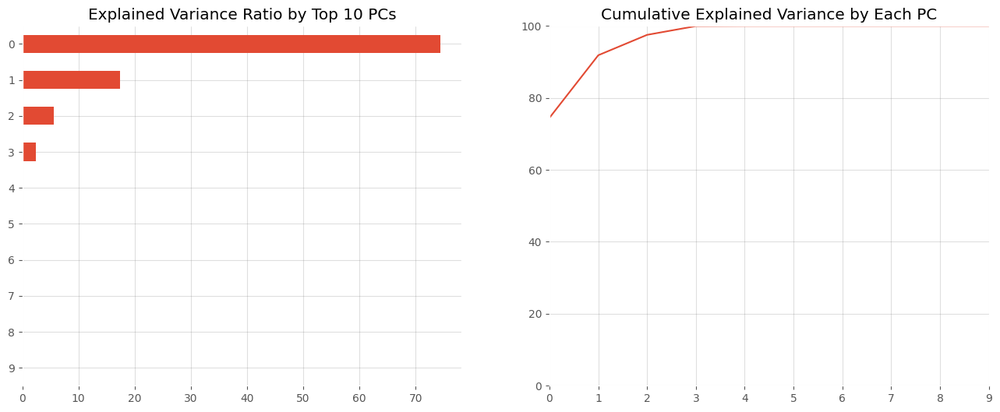

In [38]:
X_full=X.copy()

NumEigenValues = 10

pca = PCA()
PrincipalComponent = pca.fit(X_full)

fig, axes =\
(
    plt
    .subplots(ncols = 2,
              figsize = [16, 6]
             )
)

# Plot on the left panel

Series1 =\
(
    pd
    .Series(pca
            .explained_variance_ratio_[ :NumEigenValues]
           )
    .sort_values()
    * 100
)

# Plot on the right panel

Series2 =\
(
    pd
    .Series(pca
            .explained_variance_ratio_[ :NumEigenValues]
           )
    .cumsum()
    * 100
)

(
    Series1
    .plot
    .barh(ylim = (0, 9),
          title = "Explained Variance Ratio by Top 10 PCs",
          ax = axes[0]
         )
)

(
    Series2
    .plot(ylim = (0, 100),
          xlim = (0, 9),
          title = "Cumulative Explained Variance by Each PC",
          ax = axes[1]
         )
)
plt.show()

#### 2.1.4 Dimensionality Reduction using PCA

In [39]:
# Apply PCA

pca = PCA(n_components=5)  # You can adjust the number of components based on your requirements
X_full_pca = pca.fit_transform(X_full)

# Create a DataFrame with the principal components
columns = [f"PC{i+1}" for i in range(X_full_pca.shape[1])]
df_full_pca = pd.DataFrame(data=X_full_pca, columns=columns,index=X_full.index)

X_full=df_full_pca

### 2.2 Model specification

In [40]:
num_folds = 10
seed = 230926
scoring = "neg_mean_squared_error"

In [41]:
models = []

In [42]:
models.append(("LR", LinearRegression()
             )
            )

models.append(("LASSO", Lasso()
             )
            )

models.append(("EN", ElasticNet()
             )
            )

models.append(("CART", DecisionTreeRegressor()
             )
            )

models.append(("KNN", KNeighborsRegressor()
             )
            )

models.append(("SVR", SVR()
             )
            )

In [43]:
# Bagging (Boostrap Aggregation)

models.append(("RFR", RandomForestRegressor()
              )
             )

models.append(("ETR", ExtraTreesRegressor()
              )
             )

# Boosting

models.append(("GBR", GradientBoostingRegressor()
              )
             )

models.append(("ABR", AdaBoostRegressor()
              )
             )

In [44]:
# Gift for you

# Team, let me guide you through this step-by-step

### Initialization of Lists:

names = []

kfold_results = []

train_results = []
test_results = []

# Four empty lists are initialized. 
# names will store the names of the models, 
# kfold_results will store the cross-validation results, 
# train_results and test_results 
# will store the performance of the models 
# on the training and testing datasets, respectively.

### Looping through Models:

# Let's iterate over a list of models. 

# Each element in the models list is a tuple 
# containing the name of the model (name) and the model object (model).

for name, model in models:
    
### Appending Model Names:

# The name of the current model is appended to the names list.

    names.append(name)
    
### Let's run K-fold Cross-Validation
    
    kfold =\
        (KFold(n_splits = num_folds,
               random_state = seed,
               shuffle = True)
        )
    
# A KFold object is created with a specified number of splits (num_folds), 
# a random seed (seed), 
# and shuffling enabled.
    
### Running Cross-Validation:
# Let's convert MSE to positive (Here, now it becomes lower the better; See below)

    cv_results =\
        (
         -1
         *
         cross_val_score(model, X_full, Y,
                         cv = kfold,
                         scoring = scoring)
        )
        
# Cross-validation is performed on the training data (X_train, Y_train) using the current model. 
# The negative mean squared error is used 
# as the scoring metric 
# (hence multiplied by -1 to make it positive, 
# as the convention is that higher scores are better).

# Storing Cross-Validation Results:
 
### The cross-validation results for the current model are appended to the kfold_results list.    
    
    kfold_results.append(cv_results)

# Fitting the Model on the Entire Training Set:
  
    res = model.fit(X_full, Y) # The model is trained on the entire training dataset.

### Evaluating Model on Training Set:

# The trained model’s predictions on the training set are evaluated 
# using the mean squared error, and the result is appended to train_results.

    train_result = mean_squared_error(res.predict(X_full), Y)
    
    train_results.append(train_result)

## Evaluating Model on Testing Set:    
    
# Similarly, the model’s performance is evaluated 
# on the testing set and appended to test_results.
    
#     test_result = mean_squared_error(res.predict(X_test), Y_test)
    
#     test_results.append(test_result)
    
# Printing the Results:

# The name of the model, 
# the average cross-validation score, 
# the standard deviation of the cross-validation scores, 
# the training set performance, 
# and the testing set performance are printed out.

    message = "%s: %f (%f) %f" % (name, cv_results.mean(), 
                                     cv_results.std(), 
                                     train_result)
    print(message)

LR: 26.175316 (9.230059) 25.503861
LASSO: 26.174957 (9.279160) 25.506543
EN: 26.174264 (9.255291) 25.504576
CART: 53.343468 (16.622837) 0.000000
KNN: 30.545519 (10.174830) 20.595079
SVR: 27.503214 (11.132248) 26.241237
RFR: 28.284790 (7.757616) 3.657466
ETR: 28.681411 (7.878018) 0.000000
GBR: 31.116394 (8.378616) 9.330926
ABR: 34.203500 (8.381436) 26.068972


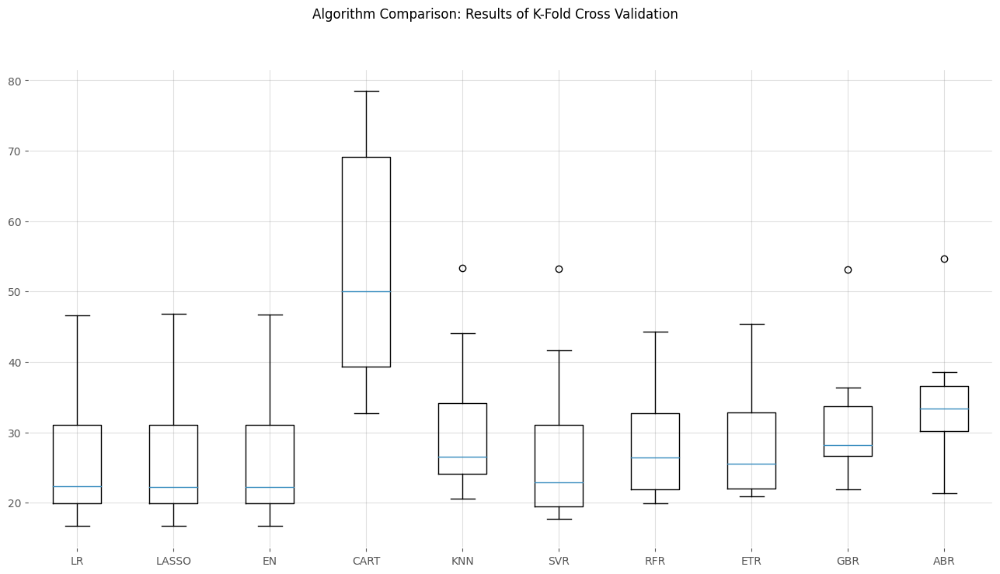

In [45]:
fig = plt.figure(figsize = [16, 8]
                )

fig.suptitle("Algorithm Comparison: Results of K-Fold Cross Validation")

ax = fig.add_subplot(111)

plt.boxplot(kfold_results)

ax.set_xticklabels(names)

plt.show()

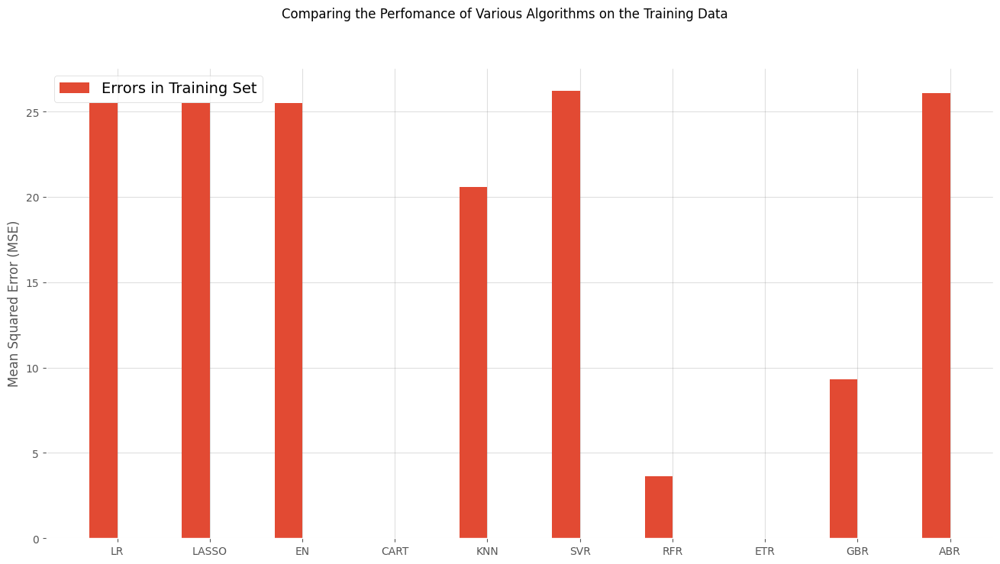

In [46]:
fig = plt.figure(figsize = [16, 8])

ind = np.arange(len(names)
               )

width = 0.30

fig.suptitle("Comparing the Perfomance of Various Algorithms on the Training Data")

ax = fig.add_subplot(111)

(plt
 .bar(ind - width/2,
    
      # Team, this line calculates the starting x position of the bars 
      # representing "Errors in Training Set". 
      # The width/2 term is used to shift the bars to the left, 
      # so they are centered around the tick mark for each group (algorithm) on the x-axis.
      
      # The bar chart will have two sets of bars for each algorithm: 
      # one for training errors and one for testing errors. 
      
      # By subtracting width/2 from ind, 
      # the training error bars are positioned to the left of the center of the tick marks. 
      
      train_results,
      width = width,
      label = "Errors in Training Set")
)

# (plt
#  .bar(ind + width/2,
#       test_results,
#       width = width,
#       label = "Errors in Testing Set")
# )

plt.legend()

ax.set_xticks(ind)
ax.set_xticklabels(names)

plt.ylabel("Mean Squared Error (MSE)")

plt.show()

### 2.3 Result (Full In Sample)

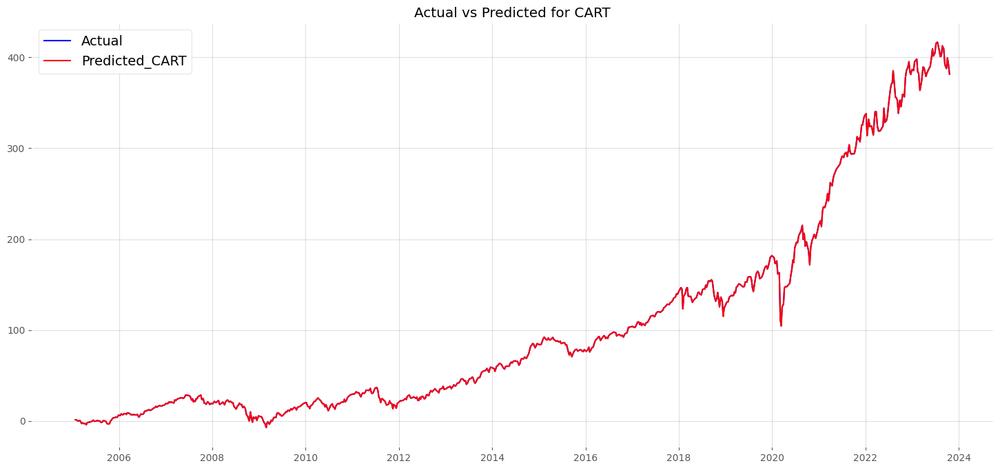

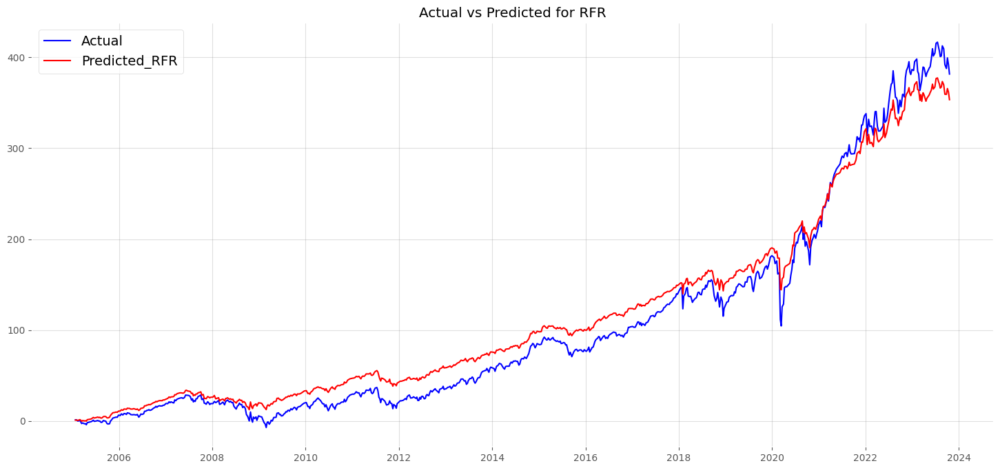

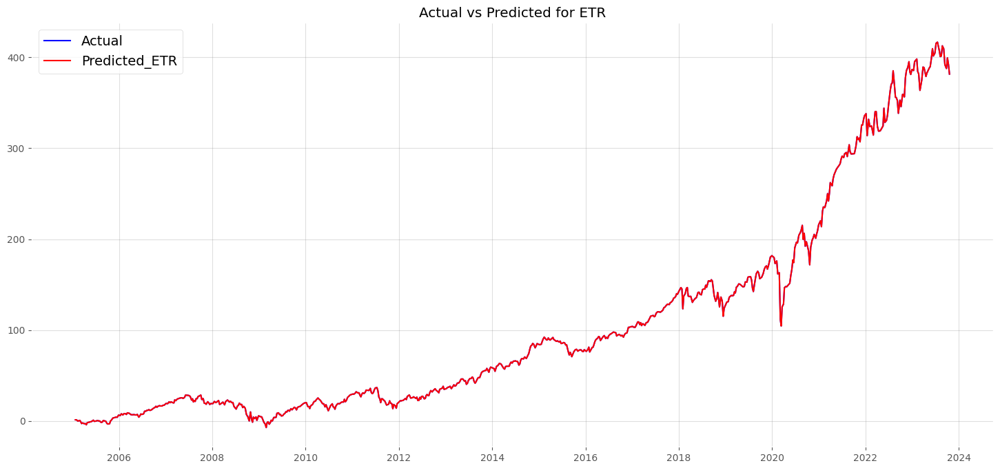

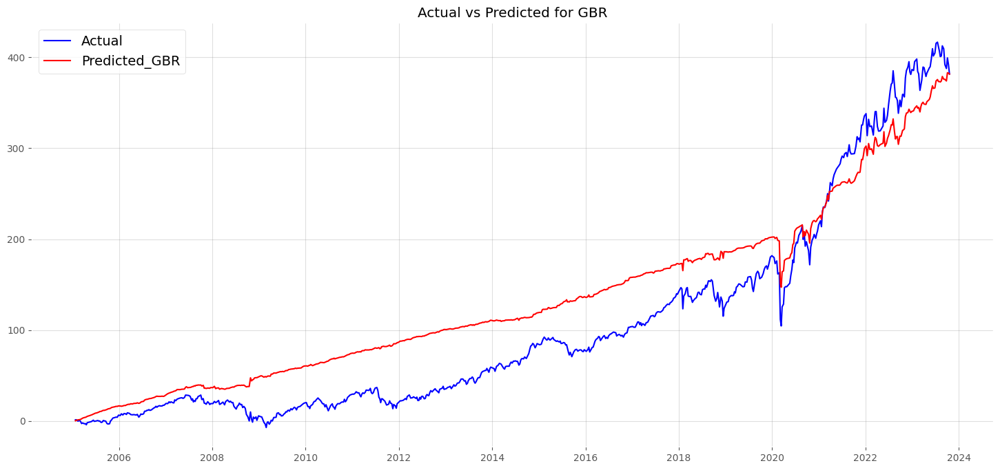

In [47]:
models_to_consider=['CART','RFR','ETR','GBR']
for name,model in models:
    if (name in models_to_consider):
        plt.figure(figsize=[18,8])
        fitted_model = model.fit(X_full, Y)
        predicted_y = model.predict(X_full)
        predicted_y=pd.DataFrame(predicted_y)
        predicted_y.index=Y.index
        plt.plot(Y.cumsum(),color='b',label='Actual')
        plt.plot(predicted_y.cumsum(),color='r',label=f"Predicted_{name}")
        plt.legend()
        plt.title(f"Actual vs Predicted for {name}")
        plt.show()

In [48]:
models_to_consider=['ETR']
for name,model in models:
    if (name in models_to_consider):
        fitted_model = model.fit(X_full, Y)
        predicted_y = model.predict(X_full)
        predicted_y=pd.DataFrame(predicted_y)
        predicted_y.columns=['prediction']
        predicted_y.index=Y.index
        print(name)
        print(np.sign(Y*predicted_y['prediction']).value_counts())
        print(f"Accuracy = {100*(np.sign(Y*predicted_y['prediction']).value_counts()[1]+np.sign(Y*predicted_y['prediction']).value_counts()[0])/np.sign(Y*predicted_y['prediction']).value_counts().sum():.1f}%")

ETR
1.0    723
0.0      2
Name: count, dtype: int64
Accuracy = 100.0%


In [49]:
predicted_y['Position']=np.where(predicted_y['prediction']>0,1,-1)
test_data=(stock_data.loc[ : , ("Adj Close", "SPY")])
test_data.name='Adj Close'
test_data=test_data.to_frame()
final_data=pd.concat([test_data,predicted_y['Position']],axis=1)
#final_data=final_data[final_data.index<=predicted_y.index[-1]]
final_data=final_data.fillna(method='ffill')
final_data=final_data.dropna()

+-----------------------+---------------------+
|             Statistic |               Value |
+-----------------------+---------------------+
| Final Account Balance | $ 19,138,365,279.13 |
|    Cummulative return |        19105677.28% |
|         Strategy CAGR |              91.13% |
|          Max Drawdown |             -12.79% |
|          Sharpe Ratio |               3.487 |
|         Sortino Ratio |               6.864 |
+-----------------------+---------------------+


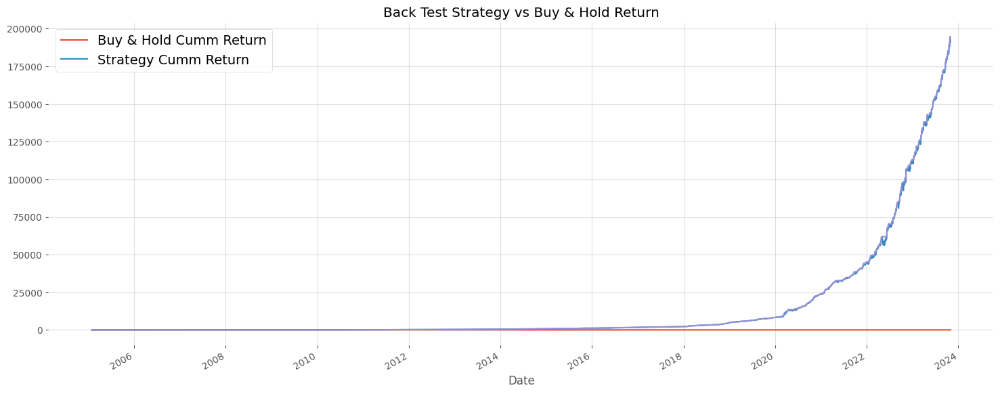

% Return by Quarter:
+------+----------+----------+----------+-----------+
| year |       Q1 |       Q2 |       Q3 |        Q4 |
+------+----------+----------+----------+-----------+
| 2005 |  8.39222 | 13.07737 | 10.83436 |   12.1542 |
| 2006 | 14.11658 |  0.52577 | 10.60659 |   7.75186 |
| 2007 |  7.41878 |  9.21552 |  17.9157 |  27.15952 |
| 2008 |  1.57103 | 28.20023 | 20.52197 | 153.22943 |
| 2009 | 42.28912 | 25.18488 | 23.58582 |    21.814 |
| 2010 | 21.87913 | 27.38335 | 22.44161 |  13.72261 |
| 2011 | 19.93791 |  18.9098 | 32.18039 |  24.53917 |
| 2012 | 10.67717 | 10.69819 | 14.52553 |  12.76463 |
| 2013 |  6.46745 | 15.41988 | 14.92852 |  14.29194 |
| 2014 | 12.63554 |  9.79073 |   5.6519 |  18.41223 |
| 2015 |  8.33775 |   4.3446 | 20.37789 |    8.3384 |
| 2016 |  6.74585 |  14.0399 |  8.78977 |  10.61841 |
| 2017 |  8.71157 |  4.70234 |   8.1859 |   7.70321 |
| 2018 | 25.20402 | 13.71888 |  9.99955 |  36.84868 |
| 2019 | 16.01885 | 13.58643 | 16.38915 |   12.0638 |
| 2020 

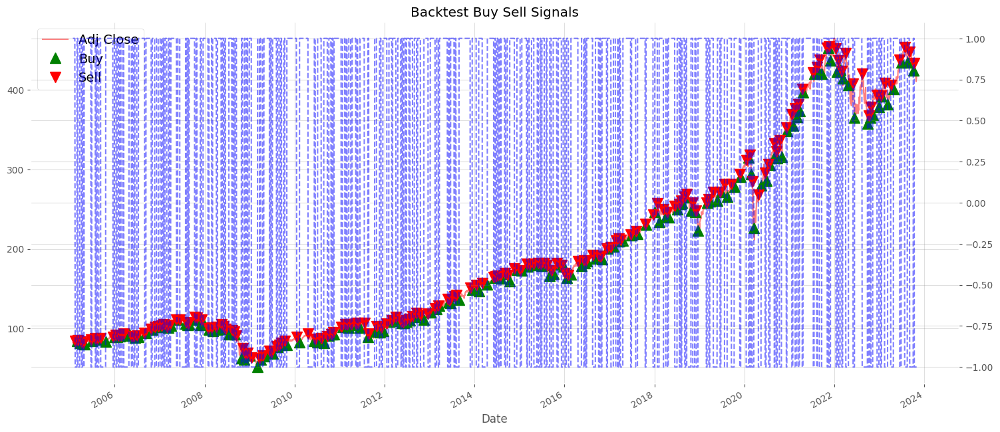

In [50]:
Backtest_ML_Strategy=Backtest(final_data,100000,0)
Backtest_ML_Strategy.plot_all_stats()

## 3. Including Out of Sample Backtesting (Extra Work for Validating the model)

### 3.1 Feature Engineering

#### 3.1.1 Data Split

In [51]:
validation_size = 0.2  ## This is not the conventional validation set -- this is testing set

train_size =\
    int(len(X) 
        * 
        (1 - validation_size)
       )

X_train, X_test =\
    (X[0         :train_size], 
     X[train_size:len(X)    ]
    )

Y_train, Y_test =\
    (Y[0         :train_size], 
     Y[train_size:len(X)    ]
    )

In [52]:
X_train

,CL=F,ES=F,IEF,ZB=F,^VIX,^GDAXI,^HSI,^IXIC,^N225,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
Date,,,,,,,,,,,,,
2005-01-26,1.230000,-10.25000,0.006161,-0.031303,0.259999,-31.429688,-54.950195,-27.500122,-28.769531,-0.008409,-0.013556,-0.021719,0.039919
2005-02-02,-2.090000,20.00000,0.180141,0.937500,-1.780000,82.189941,-67.879883,28.970093,30.569336,0.017252,0.009181,-0.001676,0.025948
2005-02-14,2.160000,5.50000,-0.024918,-0.250000,-0.209999,20.049805,222.230469,0.879883,132.339844,0.005067,0.034822,-0.001574,0.020918
2005-03-01,0.529999,25.25000,-0.309975,-0.750000,-1.100000,60.410156,-29.369141,40.930054,182.820312,0.021933,0.009615,0.024973,0.020509
2005-03-08,2.910000,10.50000,-0.037354,0.281197,0.360000,12.879883,-179.440430,2.300049,106.379883,0.009033,0.013580,0.048402,0.030549
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-03,-1.910000,-41.75000,0.394669,0.812500,4.090000,-247.129883,-522.619141,-127.290039,6.490234,-0.012265,0.003884,0.031370,0.041962
2019-12-11,0.329998,32.00000,-0.169037,0.187500,0.190000,6.169922,582.869141,87.379883,256.628906,0.009459,0.007951,0.036304,0.048492
2019-12-18,2.170002,51.75000,-0.976692,-2.843750,-2.410000,75.419922,1238.781250,173.690430,542.570312,0.016309,0.017391,0.040094,0.077119


#### 3.1.2 Add Polynomial Features to capture non-linear relationships

In [53]:
# from sklearn.preprocessing import PolynomialFeatures

# poly = PolynomialFeatures(degree=3)
# X_train_poly = poly.fit_transform(X_train)

# columns = [f"Feature{i+1}" for i in range(X_train_poly.shape[1])]
# df_train_poly = pd.DataFrame(data=X_train_poly, columns=columns,index=X_train.index)

# X_train=df_train_poly

# X_test_poly = poly.transform(X_test)

# columns = [f"Feature{i+1}" for i in range(X_test_poly.shape[1])]
# df_test_poly = pd.DataFrame(data=X_test_poly, columns=columns,index=X_test.index)

# X_test=df_test_poly

In [54]:
X_train

,CL=F,ES=F,IEF,ZB=F,^VIX,^GDAXI,^HSI,^IXIC,^N225,SPY_DT,SPY_3DT,SPY_6DT,SPY_12DT
Date,,,,,,,,,,,,,
2005-01-26,1.230000,-10.25000,0.006161,-0.031303,0.259999,-31.429688,-54.950195,-27.500122,-28.769531,-0.008409,-0.013556,-0.021719,0.039919
2005-02-02,-2.090000,20.00000,0.180141,0.937500,-1.780000,82.189941,-67.879883,28.970093,30.569336,0.017252,0.009181,-0.001676,0.025948
2005-02-14,2.160000,5.50000,-0.024918,-0.250000,-0.209999,20.049805,222.230469,0.879883,132.339844,0.005067,0.034822,-0.001574,0.020918
2005-03-01,0.529999,25.25000,-0.309975,-0.750000,-1.100000,60.410156,-29.369141,40.930054,182.820312,0.021933,0.009615,0.024973,0.020509
2005-03-08,2.910000,10.50000,-0.037354,0.281197,0.360000,12.879883,-179.440430,2.300049,106.379883,0.009033,0.013580,0.048402,0.030549
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-03,-1.910000,-41.75000,0.394669,0.812500,4.090000,-247.129883,-522.619141,-127.290039,6.490234,-0.012265,0.003884,0.031370,0.041962
2019-12-11,0.329998,32.00000,-0.169037,0.187500,0.190000,6.169922,582.869141,87.379883,256.628906,0.009459,0.007951,0.036304,0.048492
2019-12-18,2.170002,51.75000,-0.976692,-2.843750,-2.410000,75.419922,1238.781250,173.690430,542.570312,0.016309,0.017391,0.040094,0.077119


#### 3.1.3 PCA check

<Axes: title={'center': 'Cumulative Explained Variance by Each PC'}>

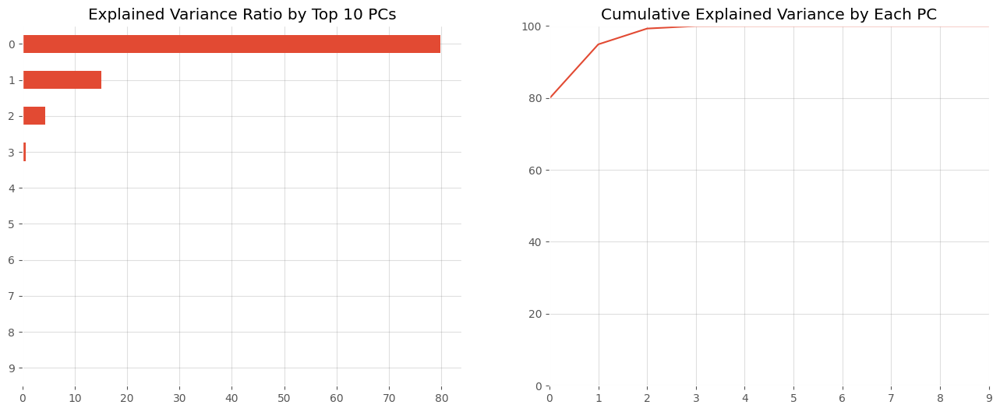

In [55]:
NumEigenValues = 10

pca = PCA()
PrincipalComponent = pca.fit(X_train)

fig, axes =\
(
    plt
    .subplots(ncols = 2,
              figsize = [16, 6]
             )
)

# Plot on the left panel

Series1 =\
(
    pd
    .Series(pca
            .explained_variance_ratio_[ :NumEigenValues]
           )
    .sort_values()
    * 100
)

# Plot on the right panel

Series2 =\
(
    pd
    .Series(pca
            .explained_variance_ratio_[ :NumEigenValues]
           )
    .cumsum()
    * 100
)

(
    Series1
    .plot
    .barh(ylim = (0, 9),
          title = "Explained Variance Ratio by Top 10 PCs",
          ax = axes[0]
         )
)

(
    Series2
    .plot(ylim = (0, 100),
          xlim = (0, 9),
          title = "Cumulative Explained Variance by Each PC",
          ax = axes[1]
         )
)

In [56]:
pca.explained_variance_ratio_

array([7.986e-01, 1.502e-01, 4.387e-02, 7.047e-03, 2.748e-04, 1.384e-05,
       5.629e-06, 5.438e-06, 1.288e-07, 1.001e-08, 1.913e-09, 6.346e-10,
       1.027e-10])

#### 3.1.4 Dimension reduction using PCA

In [57]:
# Apply PCA

pca = PCA(n_components=5)  # You can adjust the number of components based on your requirements
X_train_pca = pca.fit_transform(X_train)

# Create a DataFrame with the principal components
columns = [f"PC{i+1}" for i in range(X_train_pca.shape[1])]
df_train_pca = pd.DataFrame(data=X_train_pca, columns=columns,index=X_train.index)

X_train=df_train_pca

X_test_pca = pca.transform(X_test)

# Create a DataFrame with the principal components
columns = [f"PC{i+1}" for i in range(X_test_pca.shape[1])]
df_test_pca = pd.DataFrame(data=X_test_pca, columns=columns,index=X_test.index)

X_test=df_test_pca

# # Print the DataFrame with principal components
# print("DataFrame with Principal Components:")
# print(df_pca.head())

# # Get the feature importances (loadings) from PCA
# feature_importances = pca.components_

# # Create a DataFrame with feature importances
# df_feature_importances = pd.DataFrame(data=feature_importances, columns=X.columns, index=columns)

# # Print the DataFrame with feature importances
# print("\nDataFrame with Feature Importances:")
# print(df_feature_importances)

In [58]:
pca.explained_variance_ratio_

array([7.986e-01, 1.502e-01, 4.387e-02, 7.047e-03, 2.748e-04])

### 3.2 Model Specification

In [59]:
num_folds = 10
seed = 230926
scoring = "neg_mean_squared_error"

In [60]:
models = []

In [61]:
models.append(("LR", LinearRegression()
             )
            )

models.append(("LASSO", Lasso()
             )
            )

models.append(("EN", ElasticNet()
             )
            )

models.append(("CART", DecisionTreeRegressor()
             )
            )

models.append(("KNN", KNeighborsRegressor()
             )
            )

models.append(("SVR", SVR()
             )
            )

In [62]:
# Bagging (Boostrap Aggregation)

models.append(("RFR", RandomForestRegressor()
              )
             )

models.append(("ETR", ExtraTreesRegressor()
              )
             )

# Boosting

models.append(("GBR", GradientBoostingRegressor()
              )
             )

models.append(("ABR", AdaBoostRegressor()
              )
             )

In [63]:
### Initialization of Lists:

names = []

kfold_results = []

train_results = []
test_results = []

# Four empty lists are initialized. 
# names will store the names of the models, 
# kfold_results will store the cross-validation results, 
# train_results and test_results 
# will store the performance of the models 
# on the training and testing datasets, respectively.

### Looping through Models:

# Let's iterate over a list of models. 

# Each element in the models list is a tuple 
# containing the name of the model (name) and the model object (model).

for name, model in models:
    
### Appending Model Names:

# The name of the current model is appended to the names list.

    names.append(name)
    
### Let's run K-fold Cross-Validation
    
    kfold =\
        (KFold(n_splits = num_folds,
               random_state = seed,
               shuffle = True)
        )
    
# A KFold object is created with a specified number of splits (num_folds), 
# a random seed (seed), 
# and shuffling enabled.
    
### Running Cross-Validation:
# Let's convert MSE to positive (Here, now it becomes lower the better; See below)

    cv_results =\
        (
         -1
         *
         cross_val_score(model, X_train, Y_train,
                         cv = kfold,
                         scoring = scoring)
        )
        
# Cross-validation is performed on the training data (X_train, Y_train) using the current model. 
# The negative mean squared error is used 
# as the scoring metric 
# (hence multiplied by -1 to make it positive, 
# as the convention is that higher scores are better).

# Storing Cross-Validation Results:
 
### The cross-validation results for the current model are appended to the kfold_results list.    
    
    kfold_results.append(cv_results)

# Fitting the Model on the Entire Training Set:
  
    res = model.fit(X_train, Y_train) # The model is trained on the entire training dataset.

### Evaluating Model on Training Set:

# The trained model’s predictions on the training set are evaluated 
# using the mean squared error, and the result is appended to train_results.

    train_result = mean_squared_error(res.predict(X_train), Y_train)
    
    train_results.append(train_result)

## Evaluating Model on Testing Set:    
    
# Similarly, the model’s performance is evaluated 
# on the testing set and appended to test_results.
    
    test_result = mean_squared_error(res.predict(X_test), Y_test)
    
    test_results.append(test_result)
    
# Printing the Results:

# The name of the model, 
# the average cross-validation score, 
# the standard deviation of the cross-validation scores, 
# the training set performance, 
# and the testing set performance are printed out.

    message = "%s: %f (%f) %f %f" % (name, cv_results.mean(), 
                                     cv_results.std(), 
                                     train_result, 
                                     test_result)
    print(message)

LR: 9.037584 (4.328838) 8.502316 96.182280
LASSO: 9.023288 (4.308722) 8.508183 96.479459
EN: 9.028531 (4.317993) 8.503827 96.323008
CART: 20.880192 (7.475723) 0.000000 125.431379
KNN: 10.567029 (5.183416) 6.860591 104.434941
SVR: 9.153504 (4.342568) 8.489959 100.987763
RFR: 10.073888 (4.184145) 1.438404 98.387023
ETR: 9.803691 (4.158617) 0.000000 98.445491
GBR: 9.796693 (4.401678) 3.534335 105.185034
ABR: 9.498414 (4.040720) 6.226551 104.382373


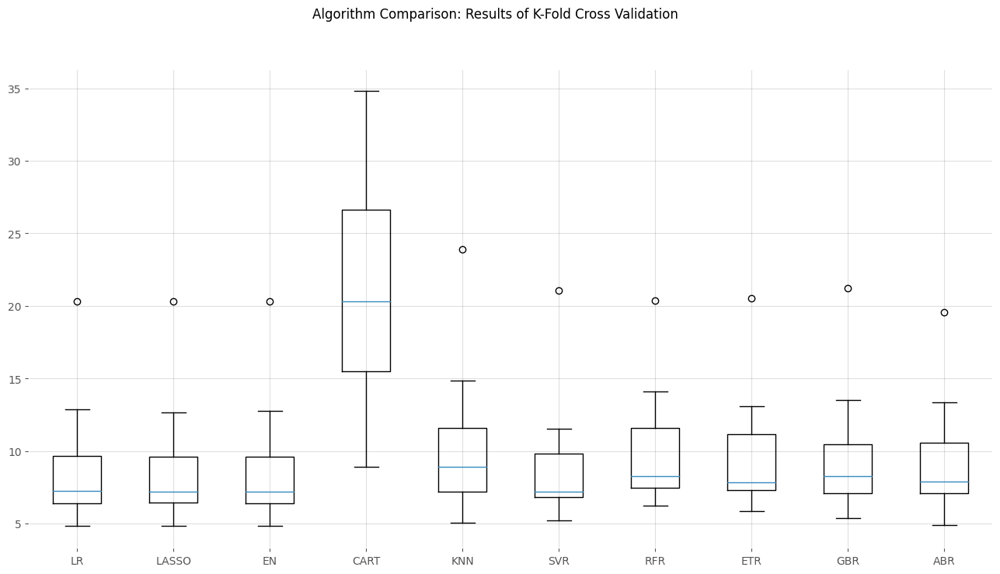

In [64]:
fig = plt.figure(figsize = [16, 8]
                )

fig.suptitle("Algorithm Comparison: Results of K-Fold Cross Validation")

ax = fig.add_subplot(111)

plt.boxplot(kfold_results)

ax.set_xticklabels(names)

plt.show()

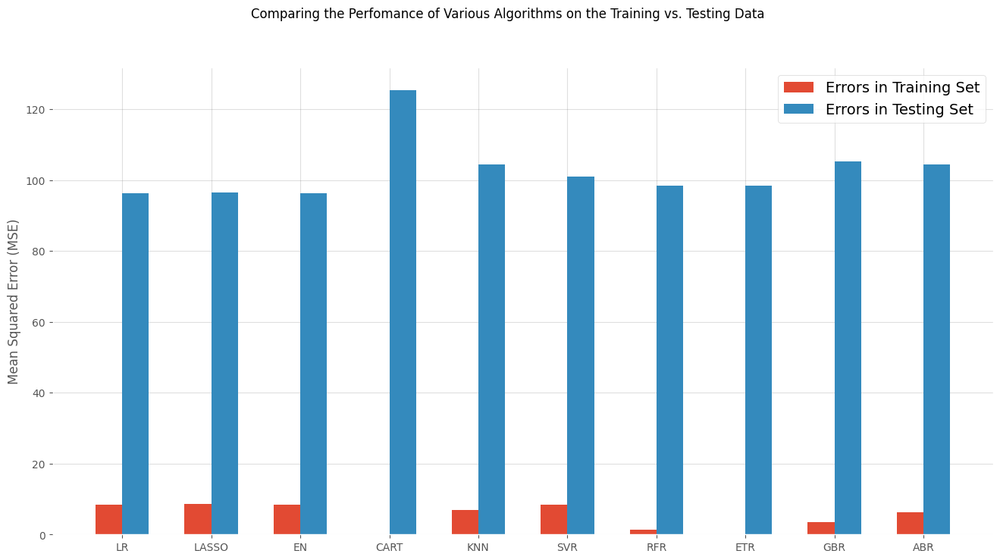

In [65]:
fig = plt.figure(figsize = [16, 8])

ind = np.arange(len(names)
               )

width = 0.30

fig.suptitle("Comparing the Perfomance of Various Algorithms on the Training vs. Testing Data")

ax = fig.add_subplot(111)

(plt
 .bar(ind - width/2,
    
      # Team, this line calculates the starting x position of the bars 
      # representing "Errors in Training Set". 
      # The width/2 term is used to shift the bars to the left, 
      # so they are centered around the tick mark for each group (algorithm) on the x-axis.
      
      # The bar chart will have two sets of bars for each algorithm: 
      # one for training errors and one for testing errors. 
      
      # By subtracting width/2 from ind, 
      # the training error bars are positioned to the left of the center of the tick marks. 
      
      train_results,
      width = width,
      label = "Errors in Training Set")
)

(plt
 .bar(ind + width/2,
      test_results,
      width = width,
      label = "Errors in Testing Set")
)

plt.legend()

ax.set_xticks(ind)
ax.set_xticklabels(names)

plt.ylabel("Mean Squared Error (MSE)")

plt.show()

### 3.3 Results

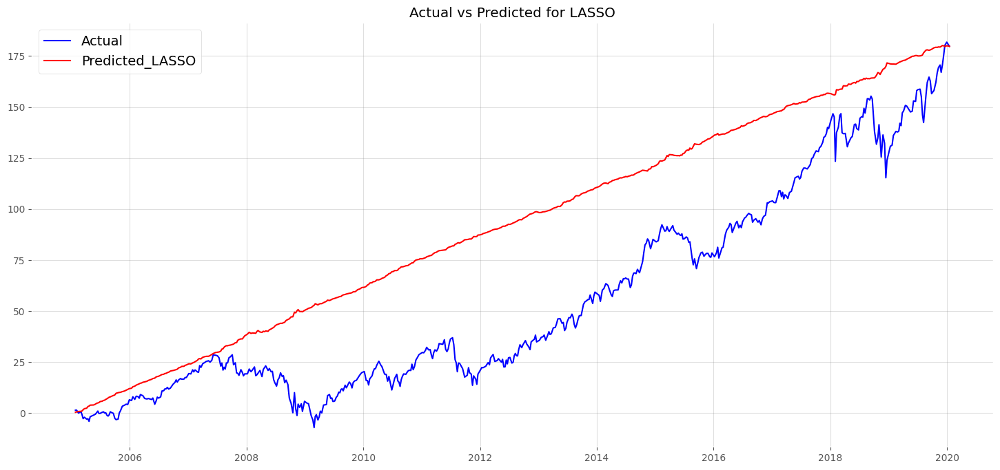

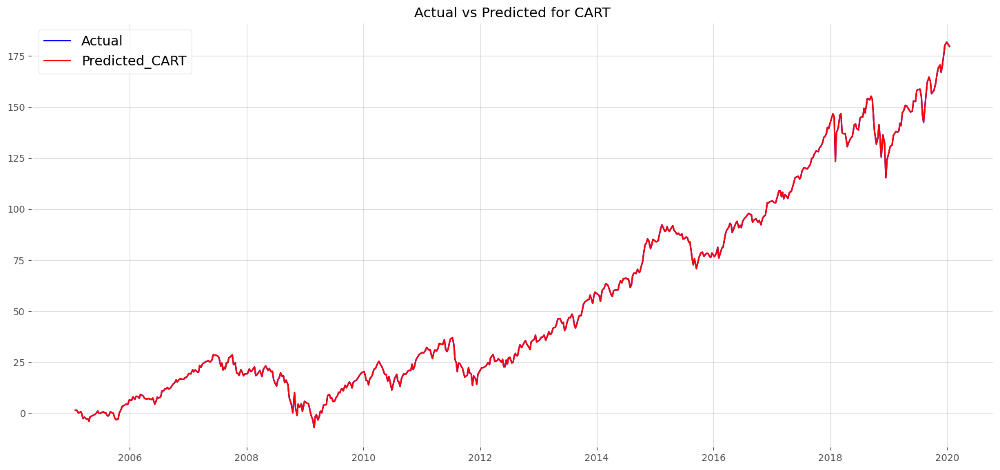

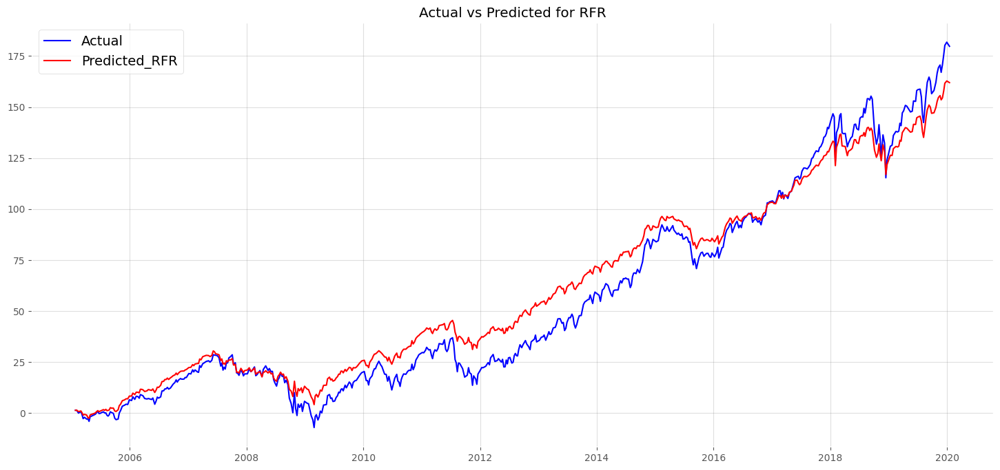

In [66]:
models_to_consider=['CART','LASSO','RFR']
for name,model in models:
    if (name in models_to_consider):
        plt.figure(figsize=[18,8])
        fitted_model = model.fit(X_train, Y_train)
        predicted_y = model.predict(X_train)
        predicted_y=pd.DataFrame(predicted_y)
        predicted_y.index=Y_train.index
        plt.plot(Y_train.cumsum(),color='b',label='Actual')
        plt.plot(predicted_y.cumsum(),color='r',label=f"Predicted_{name}")
        plt.legend()
        plt.title(f"Actual vs Predicted for {name}")
        plt.show()

### 3.3.1 Result In Sample

In [67]:
models_to_consider=['CART']
for name,model in models:
    if (name in models_to_consider):
        fitted_model = model.fit(X_train, Y_train)
        predicted_y = model.predict(X_train)
        predicted_y=pd.DataFrame(predicted_y)
        predicted_y.columns=['prediction']
        predicted_y.index=Y_train.index
        print(name)
        print(np.sign(Y_train*predicted_y['prediction']).value_counts())

CART
1.0    578
0.0      2
Name: count, dtype: int64


In [68]:
predicted_y['Position']=np.where(predicted_y['prediction']>0,1,-1)
test_data=(stock_data.loc[ : , ("Adj Close", "SPY")])
test_data.name='Adj Close'
test_data=test_data.to_frame()
final_data=pd.concat([test_data,predicted_y['Position']],axis=1)
final_data=final_data[final_data.index<=predicted_y.index[-1]]
final_data=final_data.fillna(method='ffill')
final_data=final_data.dropna()

+-----------------------+------------------+
|             Statistic |            Value |
+-----------------------+------------------+
| Final Account Balance | $ 851,038,122.58 |
|    Cummulative return |       849489.01% |
|         Strategy CAGR |           82.93% |
|          Max Drawdown |          -12.79% |
|          Sharpe Ratio |            3.439 |
|         Sortino Ratio |            6.718 |
+-----------------------+------------------+


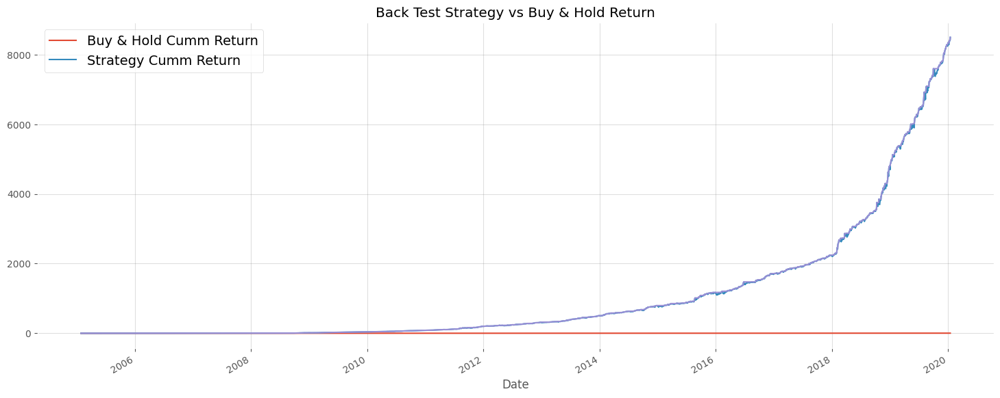

% Return by Quarter:
+------+----------+----------+----------+-----------+
| year |       Q1 |       Q2 |       Q3 |        Q4 |
+------+----------+----------+----------+-----------+
| 2005 |  8.39222 | 13.07737 | 10.83436 |   12.1542 |
| 2006 | 14.11658 |  0.52577 | 10.60659 |   7.75186 |
| 2007 |  7.41878 |  9.21552 |  17.9157 |  27.15952 |
| 2008 |  1.57103 | 28.20023 | 20.52197 | 153.22943 |
| 2009 | 42.28912 | 25.18488 | 23.58582 |    21.814 |
| 2010 | 21.87913 | 27.38335 | 22.44161 |  13.72261 |
| 2011 | 19.93791 |  18.9098 | 32.18039 |  24.53917 |
| 2012 | 10.67717 | 10.69819 | 14.52553 |  12.76463 |
| 2013 |  6.46745 | 15.41988 | 14.92852 |  14.29194 |
| 2014 | 12.63554 |  9.79073 |   5.6519 |  18.41223 |
| 2015 |  8.33775 |   4.3446 | 20.37789 |    8.3384 |
| 2016 |  6.74585 |  14.0399 |  8.78977 |  10.61841 |
| 2017 |  8.71157 |  4.70234 |   8.1859 |   7.70321 |
| 2018 | 25.20402 | 13.71888 |  9.99955 |  36.84868 |
| 2019 | 16.01885 | 13.58643 | 16.38915 |   12.0638 |
| 2020 

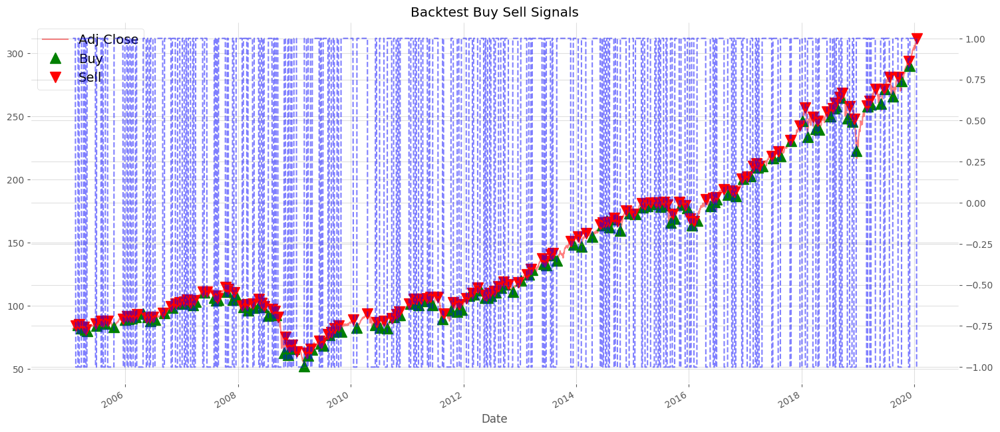

In [69]:
Backtest_ML_Strategy=Backtest(final_data,100000,0)
Backtest_ML_Strategy.plot_all_stats()

## 3.3.2 Result Out of Sample

In [70]:
models_to_consider=['LASSO']
for name,model in models:
    if (name in models_to_consider):
        fitted_model = model.fit(X_train, Y_train)
        predicted_y = model.predict(X_test)
        predicted_y=pd.DataFrame(predicted_y)
        predicted_y.columns=['prediction']
        predicted_y.index=Y_test.index
        print(name)
        print(np.sign(Y_test*predicted_y['prediction']).value_counts())

LASSO
 1.0    86
-1.0    59
Name: count, dtype: int64


In [71]:
predicted_y['Position']=np.where(predicted_y['prediction']>0,1,-1)
test_data=(stock_data.loc[ : , ("Adj Close", "SPY")])
test_data.name='Adj Close'
test_data=test_data.to_frame()
final_data=pd.concat([test_data,predicted_y['Position']],axis=1)
final_data=final_data.fillna(method='ffill')
final_data=final_data.dropna()

+-----------------------+--------------+
|             Statistic |        Value |
+-----------------------+--------------+
| Final Account Balance | $ 230,509.15 |
|    Cummulative return |      134.26% |
|         Strategy CAGR |       25.33% |
|          Max Drawdown |      -20.28% |
|          Sharpe Ratio |        1.088 |
|         Sortino Ratio |        1.876 |
+-----------------------+--------------+


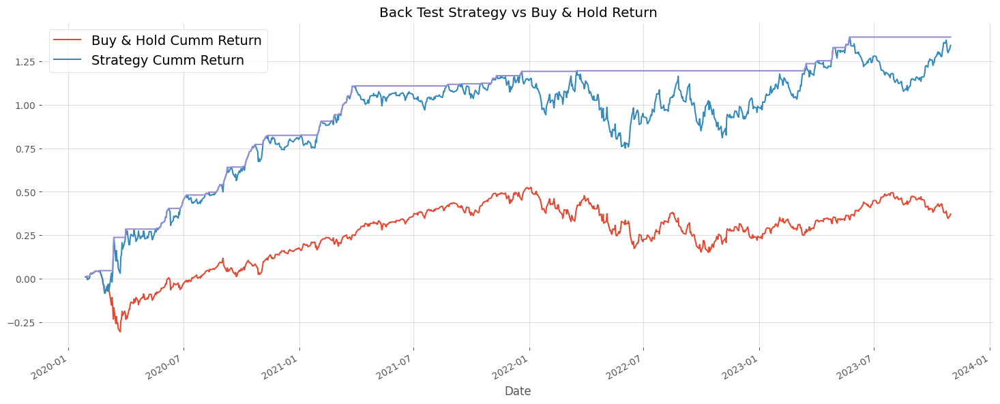

% Return by Quarter:
+------+----------+----------+----------+----------+
| year |       Q1 |       Q2 |       Q3 |       Q4 |
+------+----------+----------+----------+----------+
| 2020 | 22.73325 | 17.35051 | 12.72557 | 10.94824 |
| 2021 | 17.10353 | -2.28306 | -1.06593 |  4.94765 |
| 2022 | -0.07244 | -8.76102 | -5.13464 |  7.36054 |
| 2023 | 13.00885 |  1.48058 | -0.88641 |  3.70767 |
+------+----------+----------+----------+----------+


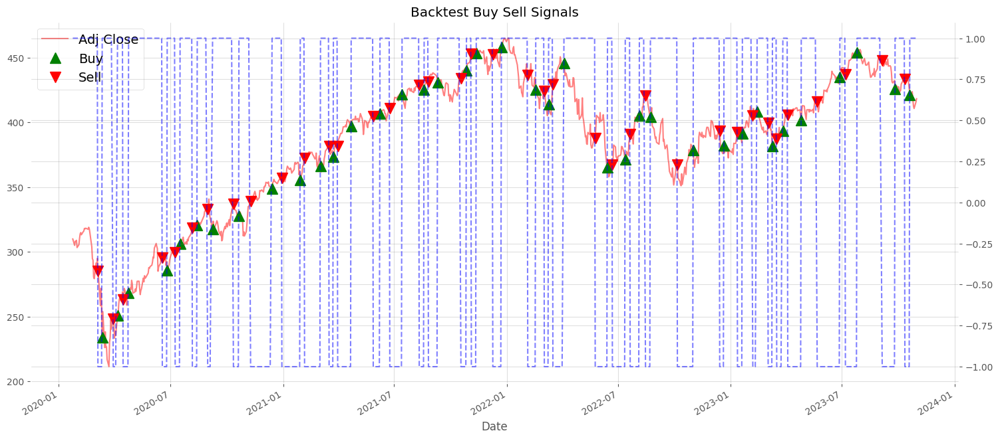

In [72]:
Backtest_ML_Strategy=Backtest(final_data,100000,0)
Backtest_ML_Strategy.plot_all_stats()

### ~Strategy 2 Ends

<a id='strategy_3'></a>

# Strategy 3: 

## Results without hyperparameter tuning

In [73]:
#using the features engineered from Strategy 1
#Group 6 has actually attempted PCA on the exogenous variables but results were inferior. 
#Therefore, we stuck to polynomial features engineering with the original features

Linear regression has intercept of 0.560 and coefficients of [-2.075e+01  5.206e+02  8.927e+02 -1.516e+01  9.685e+00 -5.004e+01
 -9.355e+01 -4.318e-01  1.208e+00  2.609e+00]
 
Logistic regression has intercept of 3.896 and coefficients of [ 0.005  0.005  0.004 -0.013  0.053  0.048  0.044  0.134  0.1    0.133]
 
Accuracy of model is : 0.568
 
Precision of model is : 0.559
 
Recall of model is : 0.999
 


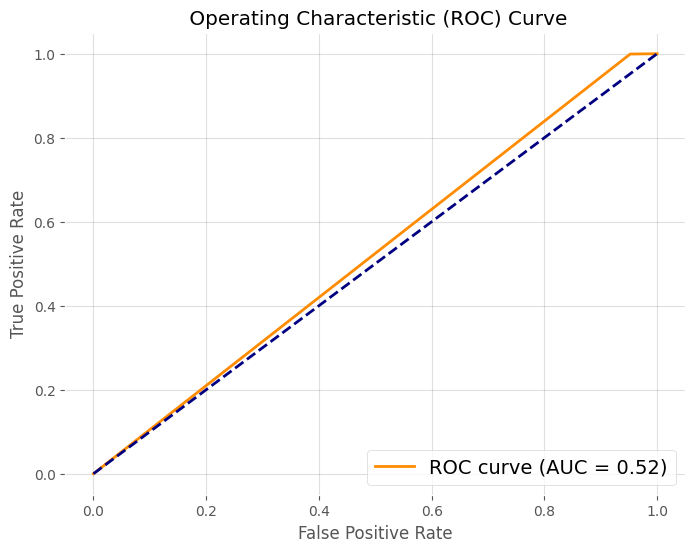

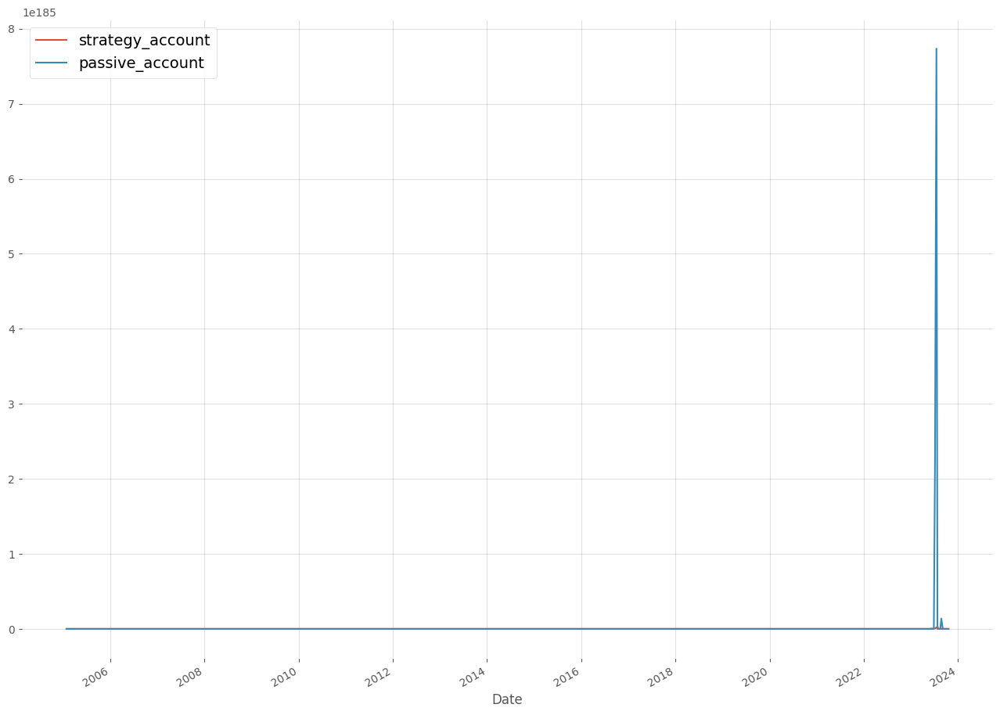

In [74]:
LR = LinearRegression()
LR.fit(X_selected_df, Y_traintest_binary)

print("=================================================================================")

print("Linear regression has intercept of {:.3f} and coefficients of {}".format(LR.intercept_, LR.coef_))
print(" ")

#linear regression
LR_pred_train = LR.predict(X_selected_df)
LR_pred_train_df = pd.DataFrame(LR_pred_train, columns = ['predicted'], index = index_)

#turn all linear regression predictions into binary response of 1 or 0
Y_pred_binary = (LR_pred_train_df > 0).astype(int)

#logistic regression
logreg_sk = LogisticRegression(penalty='elasticnet', l1_ratio=0, solver='saga')
logreg_sk.fit(X_selected_df, Y_pred_binary)

print("Logistic regression has intercept of {:.3f} and coefficients of {}".format(logreg_sk.intercept_[0], logreg_sk.coef_[0]))
print(" ")

Y_pred_logistic = logreg_sk.predict(X_selected_df)
Y_pred_logistic_df = pd.DataFrame(Y_pred_logistic, columns=['predicted'], index = index_)

print("=================================================================================")

print("Accuracy of model is : {:.3f}".format(metrics.accuracy_score(Y_traintest_binary,Y_pred_logistic_df)))
print(" ")
print("Precision of model is : {:.3f}".format(metrics.precision_score(Y_traintest_binary,Y_pred_logistic_df)))
print(" ")
print("Recall of model is : {:.3f}".format(metrics.recall_score(Y_traintest_binary,Y_pred_logistic_df)))
print(" ")

# Compute ROC curve and AUC
fpr, tpr, thresholds = roc_curve(Y_traintest_binary, Y_pred_logistic)
roc_auc = auc(fpr, tpr)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (AUC = {:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title(' Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()

print("=================================================================================")

X_traintest1 = X.copy()
X_traintest1["signal"] =  Y_pred_logistic_df
X_traintest1 = X_traintest1.loc[pd.to_datetime('2004-11-17'):]
X_traintest1 = X_traintest1.ffill()

X_traintest1['strategy_return'] = X_traintest1["signal"] * Y
capital = 100000
X_traintest1['strategy_account'] = X_traintest1['strategy_return'].cumsum().apply(np.exp) * capital
X_traintest1['passive_account'] = Y.cumsum().apply(np.exp) * capital


fig, ax1 = plt.subplots(figsize = [16,12])
X_traintest1['strategy_account'].plot(ax=ax1, label='strategy_account')
X_traintest1['passive_account'].plot(ax=ax1, label='passive_account')
ax1.legend()

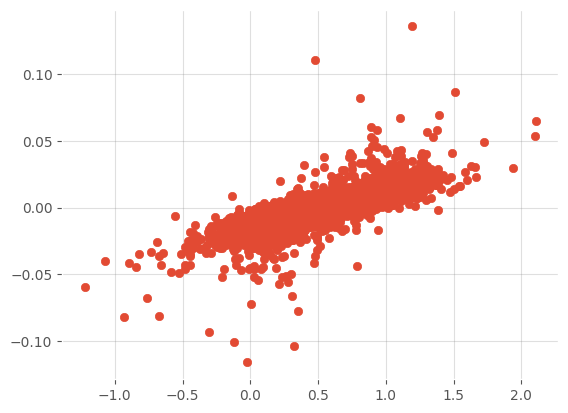

In [75]:
plt.scatter(LR_pred_train, Y_traintest)

# positive linear relationship predictions are close to actual values

+-----------------------+--------------+
|             Statistic |        Value |
+-----------------------+--------------+
| Final Account Balance | $ 284,920.15 |
|    Cummulative return |      184.92% |
|         Strategy CAGR |        5.66% |
|          Max Drawdown |      -11.01% |
|          Sharpe Ratio |        0.843 |
|         Sortino Ratio |        1.629 |
+-----------------------+--------------+


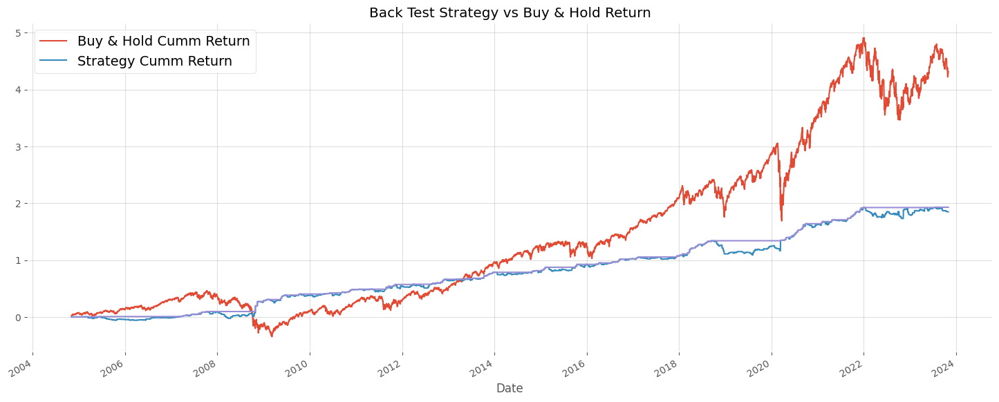

% Return by Quarter:
+------+----------+----------+----------+----------+
| year |       Q1 |       Q2 |       Q3 |       Q4 |
+------+----------+----------+----------+----------+
| 2004 |      nan |      nan |      nan |      0.0 |
| 2005 | -1.60504 |  0.26964 | -3.80314 |  0.37793 |
| 2006 |  -1.2162 |  2.22794 |  2.68274 | -0.49295 |
| 2007 |  2.72228 |  3.24711 |  3.80213 |  0.72944 |
| 2008 | -10.5164 |  3.49361 |  4.62076 | 21.79962 |
| 2009 | -2.94511 | 10.50541 | -0.10357 |  0.09494 |
| 2010 |  0.81727 | -1.20359 |  4.05926 |  3.62561 |
| 2011 | -0.15777 | -2.49867 |  4.43328 |  1.95877 |
| 2012 |  2.53672 | -4.16014 |   5.8914 |  2.66562 |
| 2013 |  0.88476 | -0.68039 |  2.43614 |  5.99574 |
| 2014 | -3.01068 |  0.92435 |  2.15943 |  0.23802 |
| 2015 |  0.81534 |  1.75274 |  1.40849 |  3.38107 |
| 2016 |  0.21331 |  0.70522 |   3.7994 |  0.32853 |
| 2017 |   0.6538 |  0.27079 | -1.17883 |  2.74604 |
| 2018 |  5.63857 |  2.90007 |  3.78659 | -9.79451 |
| 2019 |  1.35153 | -0.07

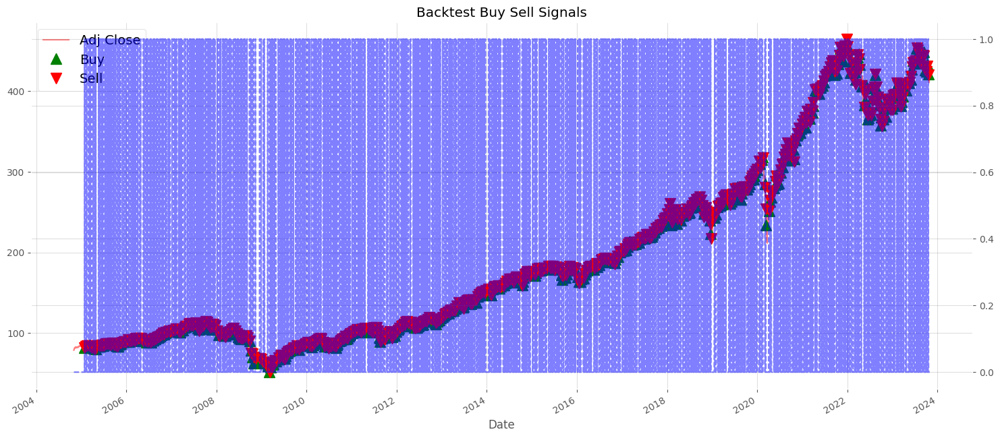

In [76]:
#create dataframe suitable for backtest Class 
reporting_df=pd.concat([spy["Adj Close"],X_traintest1["signal"].fillna(0)],axis=1)
reporting_df.columns=['Adj Close','Position']

#Generate Stats
reporting_df["Position"] = reporting_df["Position"].fillna(0)
Backtest_Strategy1=Backtest(reporting_df,100000,0)
Backtest_Strategy1.plot_all_stats()

## Results from hyperparameters optimization

In [77]:
"""Hyperparameters: 
1) Degree of polynomial features, 
2) Number of variables that could explained most variance 
3) Elastic Net's L1ratio"""

"Hyperparameters: \n1) Degree of polynomial features, \n2) Number of variables that could explained most variance \n3) Elastic Net's L1ratio"

In [78]:
#initialise dataframe to store results of optimization
res1 = pd.DataFrame(columns =['balance', 'degree', 'k', 'penalty_'])

def optimise2(X_traintest, Y_traintest, long_short=True, get_backtest = False, res = res1, degree=3, k=10, penalty_=0, solver= 'saga', capital = 100000): 
        
    Y_traintest_binary = (Y_traintest > 0).astype(int)
    
    poly = PolynomialFeatures(degree=degree)
    X_poly = poly.fit_transform(X_traintest)
    
    index_ = X_traintest.index

    feature_names = poly.get_feature_names_out(input_features=['10years futures', 'vix', 'Volume', 'Volume_3', 'Volume_6', 'Volume_12', 'SPY_3', 'SPY_6', 'SPY_12']) 
    X_poly_df = pd.DataFrame(X_poly, columns=feature_names, index = index_)
    
     # select the top 10 features based on the F-scores
    selector = SelectKBest(score_func=f_regression, k=k) 
    X_selected = selector.fit_transform(X_poly_df, Y_traintest_binary) #Y_traintest_binary
    X_columns = selector.get_feature_names_out()
    X_selected_df = pd.DataFrame(X_selected, columns = X_columns, index = index_)
    
    LN = LinearRegression()
    LN.fit(X_selected_df, Y_traintest_binary)
    LN_pred_train = LN.predict(X_selected_df)
    LN_pred_train_df = pd.DataFrame(LN_pred_train, columns = ['predicted'], index = index_) 
    Y_pred_binary = (LN_pred_train_df > 0).astype(int)
    
    if len(Y_pred_binary['predicted'].unique()) == 1:
        return print("Combination: degree = {degree}, polynomial HP {k}, regularization's L1ratio {penalty_}, output only has 1 class of predictions!".format(degree, k, penalty_))
    
    logreg_sk = LogisticRegression(penalty='elasticnet', l1_ratio=penalty_, solver=solver)
    
    logreg_sk.fit(X_selected_df, Y_pred_binary)
    
    Y_pred_logistic = logreg_sk.predict(X_selected_df)
    
    if long_short: 
        signal = Y_pred_logistic
        short_signal = (signal == 0) * -1 
        signals = short_signal + signal

    Y_pred_logistic_df = pd.DataFrame(Y_pred_logistic, columns=['predicted'])
    Y_pred_logistic_df.index = index_
    
    X_traintest3 = X.iloc[12:].copy()
    X_traintest3["signal"] = signals
    X_traintest3['strategy_return'] = X_traintest3["signal"] * Y
    X_traintest3['strategy_account'] = X_traintest3['strategy_return'].cumsum().apply(np.exp) * capital
    X_traintest3['passive_account'] = Y.cumsum().apply(np.exp) * capital

    balance3 = X_traintest3['strategy_account'].dropna()[-1]
    res.loc[len(res)] = [balance3, degree, k, penalty_]
    
    if get_backtest:
        reporting_df2 = pd.concat([spy["Adj Close"], X_traintest3["signal"].fillna(0)],axis=1)
        reporting_df2.columns=['Adj Close','Position']

        return reporting_df2, X_traintest3["signal"]

In [79]:
degree_list = [2,3]
k_list = np.arange(5, 15)
penalty_list = [0, 0.1, 0.2]

combi = [(degree, k, penalty_)
        for degree in degree_list
        for k in k_list
        for penalty_ in penalty_list]

res2 = pd.DataFrame(columns =['account_balance', 'degree', 'k', 'penalty_'])

for degree, k, penalty_ in combi:
    (
    optimise2(X_traintest, 
              Y_traintest, 
              long_short=True, 
              get_backtest = False, 
              res = res2, 
              degree=degree, 
              k=k, 
              penalty_=penalty_, 
              solver= 'saga', 
              capital = 100000)
    )
    
res2.sort_values('account_balance', ascending=False).head(5)

ValueError: Length of values (4771) does not match length of index (713)

In [ ]:
#unpacking the optimized params
account_balance2, degree2, k2, penalty_2 = res2.sort_values('account_balance', ascending=False).iloc[0]

#fit the optimized params into the function to get backtest results
reporting_df2, signal2 =\
(optimise2(X_traintest, 
           Y_traintest, 
           get_backtest = True, 
           res= res2, 
           degree=int(degree2), 
           k=int(k2), 
           penalty_=penalty_2, 
           solver= 'saga', 
           capital = 100000)
)



#Generate Stats
reporting_df2["Position"] = reporting_df2["Position"].fillna(0)
Backtest_Strategy2=Backtest(reporting_df2,100000,0)
Backtest_Strategy2.plot_all_stats()

### ~Strategy 3 Ends

<a id='strategy_4'></a>

# Strategy 4: 
In the strategy, we test the performance of a mean-reversion strategy on this highly trended data. 
We also would like to try optimize the perforamnce of the stratgy by optimizing some parameters in the strategy.

In [ ]:
#fetch data and adj close
start_date = dt.datetime(2004,11,1)
end_date = dt.datetime(2023,11,1)
spy = \
    pdr.get_data_yahoo\
    ("SPY", start = start_date, end = end_date)

initial_capital = 100000
data = pd.DataFrame(spy["Adj Close"])

### Strategy 4a:
We start the exploration of mean reversion part with the bsic simple mean reversion strategy.
We use full capital to long the index when a buy signal is triggered, and exit when the exit signal is triggered.

In [ ]:
def simple_mean_reversion(MR_days,threshold):
    
    SMR_data = data.copy()
    
    # MA for MR_days
    SMR_data['MA'] = SMR_data['Adj Close'].rolling(window = MR_days).mean()
    # Moving standard deviation for MR_days
    SMR_data['MSD'] = SMR_data['Adj Close'].rolling(window = MR_days).std()
    
    SMR_data['z_score'] = (SMR_data['Adj Close'] - SMR_data['MA']) / SMR_data['MSD']
    
    SMR_data["Position"] = np.where(SMR_data["z_score"] < -threshold, 1, np.nan)
    SMR_data["Position"] = np.where(SMR_data["z_score"] * SMR_data["z_score"].shift(1) < 0, 0, SMR_data["Position"])
    SMR_data["Position"] = (SMR_data["Position"].ffill())
    
    return SMR_data

MR_days=9
threshold = 1

simple_mean_reversion_data = simple_mean_reversion(MR_days,threshold)

print(simple_mean_reversion_data)

### Strategy 4a: 
Below we try to add in another signal, which is RSI indicator.
Use n capital to long when a SMR buy signal is triggered, and exit when the SMR exit signal is triggered.
Use 1-n capital to long when a RSI buy signal is triggered, and exit when the RSI exit signal is triggered.

In [ ]:
from ta.momentum import RSIIndicator

def SMR_with_rsi(MR_days, threshold, rsi_period, rsi_oversold, n):

    SMR_RSI_data = simple_mean_reversion_data.copy()
    SMR_RSI_data.rename(columns={'Position': 'SMR_Position'}, inplace=True)
    SMR_RSI_data["SMR_Position"]=SMR_RSI_data["SMR_Position"]*n
    

    # Calculate RSI
    rsi_indicator = RSIIndicator(SMR_RSI_data['Adj Close'], window=rsi_period)
    SMR_RSI_data['RSI'] = rsi_indicator.rsi()

    # Generate RSI-based signals
    SMR_RSI_data["RSI_Long_Signal"] = np.where(SMR_RSI_data["RSI"] < rsi_oversold, 1-n, np.nan)
    SMR_RSI_data["RSI_Long_Signal"] = np.where(SMR_RSI_data["RSI"] > 50, 0, SMR_RSI_data["RSI_Long_Signal"])
    SMR_RSI_data["RSI_Long_Signal"] = (SMR_RSI_data["RSI_Long_Signal"].ffill())

    # Combine RSI signals with existing MR signals
    SMR_RSI_data["Position"] = SMR_RSI_data["SMR_Position"].fillna(0) + SMR_RSI_data["RSI_Long_Signal"]

    return SMR_RSI_data

MR_days=9
threshold = 1
rsi_period = 14
rsi_oversold = 30
n = 0.8

SMR_withRSI_data = \
SMR_with_rsi(MR_days, threshold, rsi_period, rsi_oversold, n)

print(SMR_withRSI_data)

### Strategy 4b:
We then design a multi-position mean reversion strategy. 
We use magnitude of z score to determine the degree of overselling. 
When z-score < -1, it indicates that the asset might be undervalued, and we use 1/3 of capital to long.
When z-score < -2, it indicates that the asset might be more undervalued, and we use 2/3 of capital to long.
When z-score < -3, it indicates that the asset might be significantly undervalued, and we use full capital to long

In [ ]:
def multiposition_mean_reversion(MR_days,threshold):
    
    MMR_data = data.copy()
    
    MMR_data['MA'] = MMR_data['Adj Close'].rolling(window = MR_days).mean()
    MMR_data['MSD'] = MMR_data['Adj Close'].rolling(window = MR_days).std()
    
    MMR_data['z_score'] = (MMR_data['Adj Close'] - MMR_data['MA']) / MMR_data['MSD']
    
    MMR_data["Position"] = np.where(MMR_data["z_score"] < -threshold, 1/3, np.nan)
    MMR_data["Position"] = np.where(MMR_data["z_score"] < -2 * threshold, 2/3, MMR_data["Position"])
    MMR_data["Position"] = np.where(MMR_data["z_score"] < -3 * threshold, 1, MMR_data["Position"])
    MMR_data["Position"] = np.where(MMR_data["z_score"] * MMR_data["z_score"].shift(1) < 0, 0, MMR_data["Position"])
    MMR_data["Position"] = (MMR_data["Position"].ffill())
    
    return MMR_data

MR_days=34
threshold = 1

multiposition_mean_reversion_data = multiposition_mean_reversion(MR_days,threshold)

print(multiposition_mean_reversion_data)

### Strategy 4b:
We then try the multi-position mean reversion strategy with RSI signals embedded.
We split the capital for multi-position mean reversion and RSI trading separately. 
We use k capital to trade strategy 3. Use 1-k capital to trade RSI signals.

In [ ]:
from ta.momentum import RSIIndicator

def MMR_with_rsi(MR_days, threshold, rsi_period, rsi_oversold, k):

    MMR_RSI_data = multiposition_mean_reversion_data.copy()
    MMR_RSI_data.rename(columns={'Position': 'MMR_Position'}, inplace=True)
    MMR_RSI_data["MMR_Position"]=MMR_RSI_data["MMR_Position"]*k
    
    rsi_indicator = RSIIndicator(MMR_RSI_data['Adj Close'], window=rsi_period)
    MMR_RSI_data['RSI'] = rsi_indicator.rsi()

    MMR_RSI_data["RSI_Long_Signal"] = np.where(MMR_RSI_data["RSI"] < rsi_oversold, 1-k, np.nan)
    MMR_RSI_data["RSI_Long_Signal"] = np.where(MMR_RSI_data["RSI"] > 50, 0, MMR_RSI_data["RSI_Long_Signal"])
    MMR_RSI_data["RSI_Long_Signal"] = (MMR_RSI_data["RSI_Long_Signal"].ffill())

    MMR_RSI_data["Position"] = MMR_RSI_data["MMR_Position"].fillna(0) + MMR_RSI_data["RSI_Long_Signal"]

    return MMR_RSI_data

MR_days=34
threshold = 1
rsi_period = 14
rsi_oversold = 30
k=0.8

MMR_withRSI_data = \
MMR_with_rsi(MR_days, threshold, rsi_period, rsi_oversold, k)

print(MMR_withRSI_data)

### Define a back-testing function, which would be used for parameter optimization

In [ ]:
def calculate_sharpe_ratio(strategy_returns):
        sharpe_ratio = strategy_returns.mean() / strategy_returns.std() * np.sqrt(252)
        return sharpe_ratio

def calculate_remaining_capital(cumulative_returns):
        remaining_capital = initial_capital * cumulative_returns.iloc[-1]
        return remaining_capital

def calculate_cagr(sample_data):
        start_value = initial_capital
        end_value = calculate_remaining_capital(sample_data['Cumulative_Return'])
        days =((sample_data.index[-1] - sample_data.index[0]).days)
        cagr = (end_value / start_value) ** (365.0/days) - 1
        return cagr

def calculate_max_drawdown(cumulative_returns):
        max_drawdown = (cumulative_returns / cumulative_returns.cummax() - 1).min()
        return max_drawdown

def backtest_strategy(sample_data):

    # Calculate daily returns
    sample_data['Daily_Return'] = sample_data['Adj Close'].pct_change()

    # Apply position to returns
    sample_data['Strategy_Return'] = sample_data['Position'].shift(1) * sample_data['Daily_Return']

    # Calculate cumulative returns
    sample_data['Cumulative_Return'] = (1 + sample_data['Strategy_Return']).cumprod()

    # Calculate other performance metrics (Sharpe ratio, Remaining Capital, CAGR, Max Drawdown.)
    sharpe_ratio = calculate_sharpe_ratio(sample_data['Strategy_Return'])
    ending_capital = calculate_remaining_capital(sample_data['Cumulative_Return'])
    cagr = calculate_cagr(sample_data)
    max_drawdown = calculate_max_drawdown(sample_data['Cumulative_Return'])

    result_table = pd.DataFrame({
        'Sharpe': [sharpe_ratio],
        'CAGR': [cagr],
        'Max_Drawdown': [max_drawdown],
        'Remaining_Capital': [ending_capital]
    })

    return result_table

## Find the optimal mean reversion period in simple mean reversion strategy (strategy 4a). The result is 9-day.

In [ ]:
MR_days_values = np.arange(5, 70, 1)

strategy1_performance_metrics = {}

for MR_days in MR_days_values:
    strategy1_data = simple_mean_reversion(MR_days, threshold)
    strategy1_performance_metrics[MR_days] = backtest_strategy(strategy1_data)
    
MR_days_values = list(strategy1_performance_metrics.keys())
Remaining_Capital_1 = [metrics['Remaining_Capital'] for metrics in strategy1_performance_metrics.values()]

plt.figure(figsize=(10, 6))
plt.plot(MR_days_values, Remaining_Capital_1, marker='o', linestyle='-', color='b')
plt.title('Remaining_Capital_Strategy_4a vs. MR_days')
plt.xlabel('MR_days')
plt.ylabel('Remaining_Capital')
plt.grid(True)
plt.show()

### Now we look to find the optimal value of n and 1-n, which is the split of capital in the simple mean reversion strategy and RSI trading.

In [ ]:
MR_days = 9

n_values = np.arange(0, 1.1, 0.1)

strategy2_performance_metrics = {}

for n in n_values:
    strategy2_data = SMR_with_rsi(MR_days, threshold, rsi_period, rsi_oversold, n)
    strategy2_performance_metrics[n] = backtest_strategy(strategy2_data)
    
n = list(strategy2_performance_metrics.keys())
Remaining_Capital_2 = [metrics['Remaining_Capital'] for metrics in strategy2_performance_metrics.values()]

plt.figure(figsize=(10, 6))
plt.plot(n, Remaining_Capital_2, marker='o', linestyle='-', color='b')
plt.title('Remaining_Capital_Strategy_4a vs. MR_days')
plt.xlabel('MR_days')
plt.ylabel('Remaining_Capital')
plt.grid(True)
plt.show()

##### The straight line plot indicates that the strategy return is maximised when n=1.0, which indicates that full capitals are deployed for mean-reversion components. This suggests that the RSI trading component is dominated by the MR trading component, and therefore it should be excluded to optimise the returns, unfortunately.¶

### Therefore, we backtest the simple mean reversion strategy with MR_days = 9 and n=1

In [ ]:
Backtest_Simple_Mean_Reversion_Strategy=Backtest(simple_mean_reversion_data,100000,0)
Backtest_Simple_Mean_Reversion_Strategy.plot_all_stats()

### We use similar approach for strategy 4b, multi-position mean reversion strategy, by looking for the optimal mean-reversion period first. The result is 34-day. 

In [ ]:
MR_days_values = np.arange(5, 70, 1)

strategy3_performance_metrics = {}

for MR_days in MR_days_values:
    strategy3_data = multiposition_mean_reversion(MR_days, threshold)
    strategy3_performance_metrics[MR_days] = backtest_strategy(strategy3_data)
    
MR_days_values = list(strategy3_performance_metrics.keys())
Remaining_Capital_3 = [metrics['Remaining_Capital'] for metrics in strategy3_performance_metrics.values()]

### We also attempt to find the optimal value of k and 1-k, which is the split of capital in the multi-position mean reversion strategy and RSI trading.

In [ ]:
k_values = np.arange(0, 1.1, 0.1)

strategy4_performance_metrics = {}

# Iterate through each k value
for k in k_values:
    strategy4_data = MMR_with_rsi(MR_days, threshold, rsi_period, rsi_oversold, k)
    strategy4_performance_metrics[k] = backtest_strategy(strategy4_data)
    
k = list(strategy4_performance_metrics.keys())
Remaining_Capital_4 = [metrics['Remaining_Capital'] for metrics in strategy4_performance_metrics.values()]

plt.figure(figsize=(10, 6))
plt.plot(k, Remaining_Capital_4, marker='o', linestyle='-', color='b')
plt.title('Remaining_Capital_Strategy_4b vs. k')
plt.xlabel('k')
plt.ylabel('Remaining_Capital')
plt.grid(True)
plt.show()

##### The straight line plot indicates that the strategy return is maximised when k=1.0, which indicates that full capitals are deployed for the multi-position mean-reversion components. This suggests that the RSI trading component is dominated by the MR trading component, and therefore it should be excluded to optimise the returns, unfortunately as well.

### Therefore, we backtest the multi-position mean reversion strategy with MR_days = 34 and n=1

In [ ]:
Backtest_Multiposition_Mean_Reversion_Strategy=Backtest(multiposition_mean_reversion_data,100000,0)
Backtest_Multiposition_Mean_Reversion_Strategy.plot_all_stats()

### We observe a trade-off in performance and risks in the simple VS multi-position mean reversion strategy, as different proportion of capitals were used at different stage of trading. Nonetheless, the simple mean reversion strategy with long-only component seems to be more appealing at the first glance, given the higher Sharpe and Sortino Ratio.

### ~Strategy 4 Ends

<a id='strategy_5'></a>

# Strategy 5: 

### Import Data

In [ ]:
ticker = 'SPY'
start_date = '2003-11-01'
end_date = '2022-10-31'
sp500 =  pdr.get_data_yahoo(ticker, start_date, end_date)

### Define Functions 
- Function to calculate cumulative return 
    - cum_function()
- Function to calculate the 'final_action' column when combining 2 indicators
    - check_row()
- Functions to calculate the 'action' column for 13 momentum indicators
    - rsi()  <font color = 'red'> *note: RSI strategy is modified into a momentum strategy
    - sma_strategy()
    - threshold_strategy()
      <font color = 'red'> *note: Threshold strategy is modified into a momentum strategy
    - macd()
    - ADX_signal()
    - Aroon_signal()
    - WilliamsR_signal()
    - CCI_signal() <font color = 'red'> *note: CCI strategy is modified into a momentum strategy
    - EFI_signal()
    - KC_signal()
    - TEMA_signal()
    - TRIX_signal()

In [ ]:
def cum_return(price, action):
    df = price.copy()
    df['action'] = action.copy()
    df['passive_log_return'] = np.log(df['Adj Close'] / df['Adj Close'].shift(1))
    df['strategy_log_return'] = df['action'].shift(1)*df['passive_log_return']
    df['cum_return'] = df['strategy_log_return'].cumsum().apply(np.exp)
    #df['cum_return'].plot(title='cum return (%)')
    return df

def check_row(row):
    if all(r == 1 for r in row):
        return 1
    elif all(r == -1 for r in row):
        return -1
    else:
        return 0

def rsi(price, window, buy, sell): # modified RSI indicator to make it into a momentum indicator
    df = pd.DataFrame()
    df['Adj Close'] = price[['Adj Close']].copy()
    delta = df['Adj Close'].diff()
    gain = delta.where(delta > 0, 0)
    loss = -delta.where(delta < 0, 0)
    average_gain = gain.rolling(window=window).mean()
    average_loss = loss.rolling(window=window).mean()
    rs = average_gain  / average_loss
    df['RSI'] = 100 - (100 / (1 + rs))
    df["position"] = np.nan
    long  = (df["RSI"].shift(1) > buy) & (df["RSI"] >= buy) & (df["position"].shift(1) !=1)
    short = (df["RSI"].shift(1) < sell) & (df["RSI"] <= sell) & (df["position"].shift(1) != -1)
    df["position"] = np.where(long,1,df["position"])
    df["position"] = np.where(short,-1,df["position"])
    df["position"].ffill(inplace = True)
    df['position'] = df['position'].fillna(0)
    df["action"] = df["position"].diff()
    return df['action']

def sma_strategy(price, short, long):
    df = pd.DataFrame()
    df['Adj Close'] = price[['Adj Close']].copy()
    df['short_sma'] = df['Adj Close'].rolling(short).mean()
    df['long_sma'] = df['Adj Close'].rolling(long).mean()
    df['position'] = 0.0
    df['position'] = np.where(df['short_sma'] > df['long_sma'], 1, 0)
    df['action'] = df['position'].diff()
    return df['action']

def threshold_strategy(price, window, threshold):
    df = pd.DataFrame()
    df['Adj Close'] = price['Adj Close'].copy()
    df['short_sma'] = df['Adj Close'].rolling(window).mean()
    df['distance'] = abs(df['Adj Close'] - df['short_sma'])
    df['rolling_std'] = df['Adj Close'].rolling(window).std()
    df['rolling_threshold'] = threshold * df['rolling_std']
    
    df['position'] = np.where((df['distance'] > df['rolling_threshold']) & (df['Adj Close'] > df['short_sma']), -1, np.nan)
    df['position'] = np.where((df['distance'] > df['rolling_threshold']) & (df['Adj Close'] < df['short_sma']), 1, df['position'])
    df['position'] = df['position'].ffill()
    
    df['action'] = df['position'].diff()
    df['action'] = df['action'].replace(-2, -1)
    df['action'] = df['action'].replace(2, 1)
    
    return df['action']

def macd(price, short, long, signal):
    df = pd.DataFrame()
    df['Adj Close'] = price[['Adj Close']].copy()
    df['short_EMA'] = df['Adj Close'].ewm(span=short, adjust=False).mean()
    df['long_EMA'] = df['Adj Close'].ewm(span=long, adjust=False).mean()
    df['MACD'] = df['short_EMA'] - df['long_EMA']
    df['signal'] = df['MACD'].ewm(span=signal, adjust=False).mean()
    df["position"] = np.where((df['MACD'] > df['signal']), 1, -1)
    df["position"] = df["position"].shift(1)
    df["position"][:short+long] = 0 
    df["position"].fillna(0, inplace=True)
    df["action"] = df["position"].diff() 
    df["action"].fillna(0, inplace=True)
    df["action"]=np.sign(df["signal"])
    return df['action']

def ADX_signal(df, period=14):
    df = df.copy()
    df['+DM'] = np.where((df['High'] - df['High'].shift(1)) > (df['Low'].shift(1) - df['Low']), 
                         df['High'] - df['High'].shift(1), 0)
    df['+DM'] = np.where(df['+DM'] < 0, 0, df['+DM'])

    df['-DM'] = np.where((df['Low'].shift(1) - df['Low']) > (df['High'] - df['High'].shift(1)), 
                         df['Low'].shift(1) - df['Low'], 0)
    df['-DM'] = np.where(df['-DM'] < 0, 0, df['-DM'])

    tr_list = [df['High'] - df['Low'], df['High'] - df['Close'].shift(), df['Close'].shift() - df['Low']]
    df['TR'] = pd.concat(tr_list, axis=1).max(axis=1)
    df['TR'] = df['TR'].rolling(window=period).sum()

    df['+DI'] = 100 * (df['+DM'].rolling(window=period).sum() / df['TR'])
    df['-DI'] = 100 * (df['-DM'].rolling(window=period).sum() / df['TR'])

    df['ADX'] = abs((df['+DI'] - df['-DI']) / (df['+DI'] + df['-DI'])) * 100
    df['ADX'] = df['ADX'].rolling(window=period).mean()

    df['action'] = np.where((df['+DI'] > df['-DI']) & (df['ADX'] > 25), 1, 
                            np.where((df['+DI'] < df['-DI']) & (df['ADX'] > 25), -1, 0))
    return df['action']

def Aroon_signal(df, period=25):
    df = df.copy()
    df['Aroon_down'] = df['Low'].rolling(window=period, min_periods=1).apply(lambda x: (x.argmin() / (period - 1)) * 100, raw=True)
    df['Aroon_up'] = df['High'].rolling(window=period, min_periods=1).apply(lambda x: (x.argmax() / (period - 1)) * 100, raw=True)
    df['Aroon_Oscillator'] = df['Aroon_up'] - df['Aroon_down']
    df['action'] = np.where(df['Aroon_up'] > df['Aroon_down'], 1, np.where(df['Aroon_up'] < df['Aroon_down'], -1, 0))
    return df['action']

def WilliamsR_signal(df, period=14):
    df['Williams_%R'] = ((df['High'].rolling(window=period).max() - df['Close']) / 
                         (df['High'].rolling(window=period).max() - df['Low'].rolling(window=period).min())) * -100

    df['action'] = np.where(df['Williams_%R'] > -80, 1, 
                            np.where(df['Williams_%R'] < -20, -1, 0))
    return df['action']

def CCI_signal(df, period=20): # modified CCI indicator to make it into a momentum indicator
    df = df.copy()
    TP = (df['High'] + df['Low'] + df['Close']) / 3
    CCI = (TP - TP.rolling(window=period).mean()) / (0.015 * TP.rolling(window=period).std())
    df['CCI'] = CCI
    df['action'] = np.where(df['CCI'] > 100, 1, np.where(df['CCI'] < -100, -1, 0))
    return df['action']

def ROC_signal(df, period=12):
    df = df.copy()
    df['ROC'] = df['Close'].diff(period) / df['Close'].shift(period) * 100
    df['action'] = np.where(df['ROC'] > 0, 1, np.where(df['ROC'] < 0, -1, 0))
    return df['action']

def EFI_signal(df, period=13):
    df = df.copy()
    df['EFI'] = df['Close'].diff(1) * df['Volume']
    df['EFI_MA'] = df['EFI'].rolling(window=period).mean()
    df['action'] = np.where(df['EFI'] > df['EFI_MA'], 1, np.where(df['EFI'] < df['EFI_MA'], -1, 0))
    return df['action']

def KC_signal(df, period=20):
    df = df.copy()
    middle_line = df['Close'].ewm(span=period, adjust=False).mean()
    range_ma = (df['High'] - df['Low']).rolling(window=period).mean()
    df['upper_KC'] = middle_line + (2 * range_ma)
    df['lower_KC'] = middle_line - (2 * range_ma)
    
    df['action'] = np.where(df['Close'] > df['upper_KC'], 1, 
                            np.where(df['Close'] < df['lower_KC'], -1, 0))
    return df['action']

def TEMA_signal(df, period=30):
    df = df.copy()
    ema1 = df['Close'].ewm(span=period, adjust=False).mean()
    ema2 = ema1.ewm(span=period, adjust=False).mean()
    ema3 = ema2.ewm(span=period, adjust=False).mean()
    df['TEMA'] = 3 * (ema1 - ema2) + ema3
    df['action'] = np.where(df['Close'] > df['TEMA'], 1, 
                            np.where(df['Close'] < df['TEMA'], -1, 0))
    return df['action']

def TRIX_signal(df, period=15):
    df = df.copy()
    ema1 = df['Close'].ewm(span=period, adjust=False).mean()
    ema2 = ema1.ewm(span=period, adjust=False).mean()
    ema3 = ema2.ewm(span=period, adjust=False).mean()
    df['TRIX'] = ema3.pct_change() * 100
    df['signal_line'] = df['TRIX'].ewm(span=period, adjust=False).mean()
    df['action'] = np.where(df['TRIX'] > df['signal_line'], 1, 
                            np.where(df['TRIX'] < df['signal_line'], -1, 0))
    return df['action']

In [ ]:
# Optimization process for MACD
start_time = time.time()

short_range = range(5, 305, 5)
long_range = range(5, 305, 5)
signal_range = range(5, 305, 5)

param_combinations_macd = [
    (short, long, signal)
    for short in short_range
    for long in long_range
    for signal in signal_range
    if short < long
]

best_cum_return = -np.inf
best_params = None
cum_returns = []
combinations = []

for short, long, signal in param_combinations_macd:
    macd_data = macd(sp500, short, long, signal)
    net_cum_return = cum_return(sp500, macd_data)['cum_return'].iloc[-1]
    cum_returns.append(net_cum_return)
    combinations.append((short, long, signal))

    if net_cum_return > best_cum_return:
        best_cum_return = net_cum_return
        best_params = (short, long, signal)

# Plotting the results for MACD
plt.figure(figsize=(10, 6))
tick_interval = max(len(combinations) // 10, 1)
tick_positions = np.arange(0, len(combinations), tick_interval)
tick_labels = [str(combinations[i]) for i in tick_positions]

plt.plot(np.arange(len(combinations)), cum_returns, 'o-')
plt.title('Gross Cumulative Return for Different MACD Parameter Combinations')
plt.xlabel('Parameter Combinations (Short, Long, Signal)')
plt.ylabel('Gross Cumulative Return')
plt.xticks(tick_positions, tick_labels, rotation='vertical')
plt.tight_layout()
plt.grid(True)
plt.show()

end_time = time.time()
elapsed_time = end_time - start_time
print(f"Best Parameters: {best_params}, Best Cumulative Return: {best_cum_return}")
print(f"Elapsed Time: {elapsed_time:.2f} seconds")


### For convenience, the backtesting result of the other 12 indicators are added attached as image.
The possible range of paramters for each indicators are: 
- RSI : window_range = range(5, 155, 5), buy_range = range(5, 155, 5), sell_range = range(5, 155, 5)
- SMA: short_range = range(5, 505, 5), long_range = range(5, 505, 5)
- Threshold Strategy: window_range = range(5, 505, 5), threshold_range = np.arange(0.1, 6.1, 0.1)
- ADX: period_range = range(5, 4000, 5)
- Aroon : period_range = range(1, 4782, 1)
- EFI : period_range = range(1, 4782, 1)
- KC: period_range = range(1, 4782, 1)
- TEMA : period_range = range(1, 4782, 1)
- TRIX : period_range = range(1, 4782, 1)
- Williams %R : period_range = range(1, 4782, 1)
- CCI : period_range = range(1, 4782, 1)
- ROC : period_range = range(1, 4782, 1)



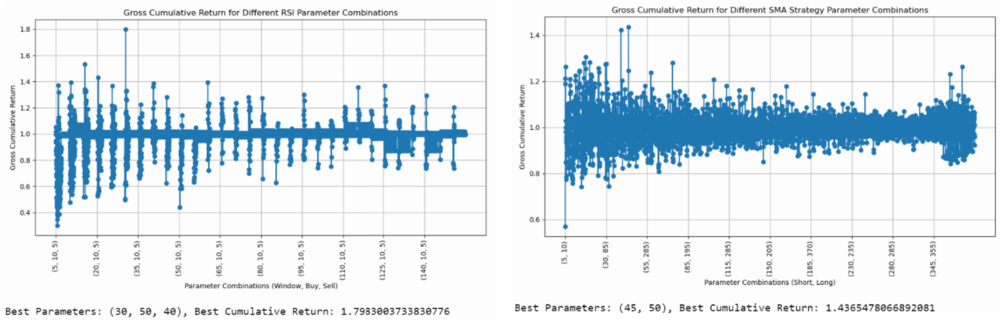
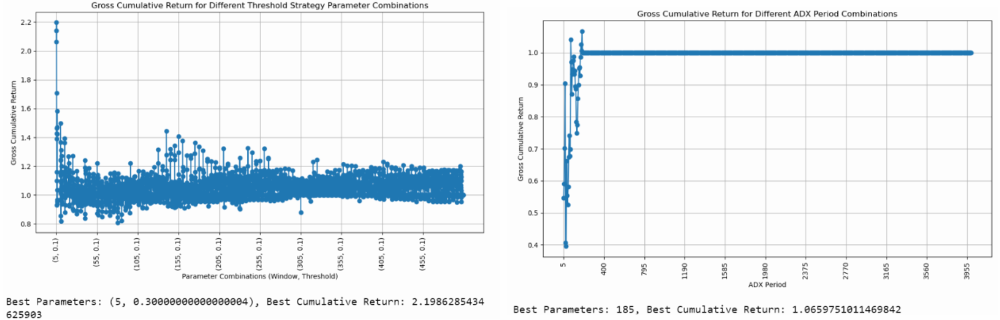
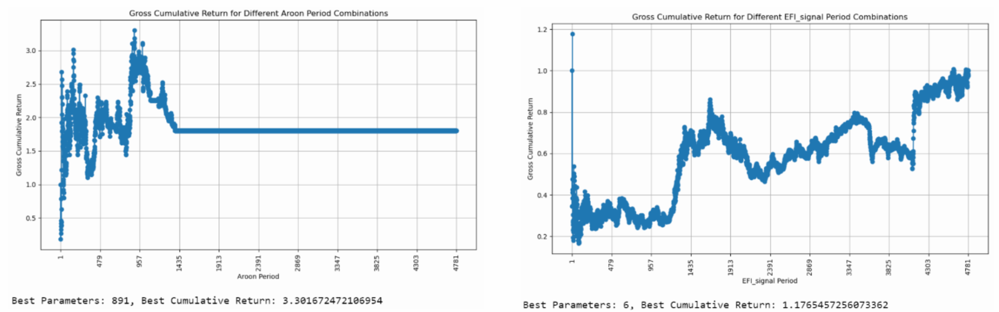
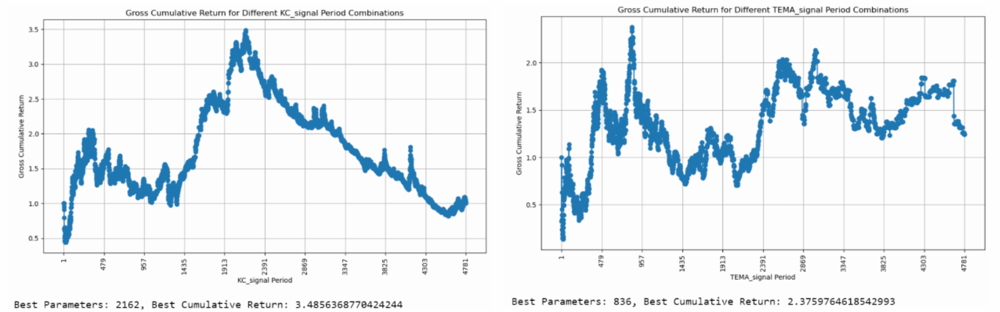
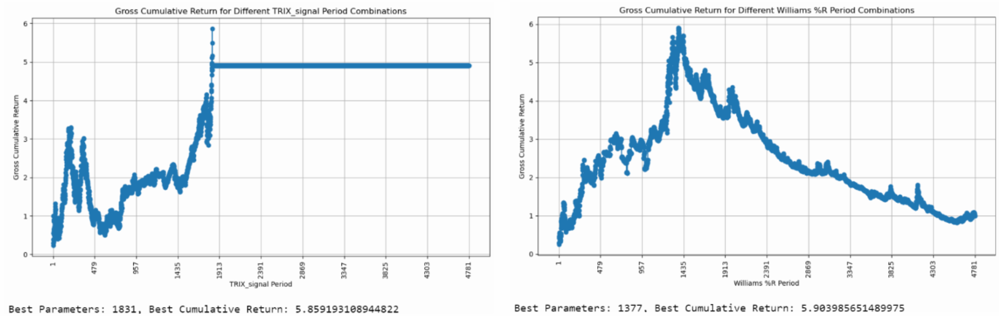
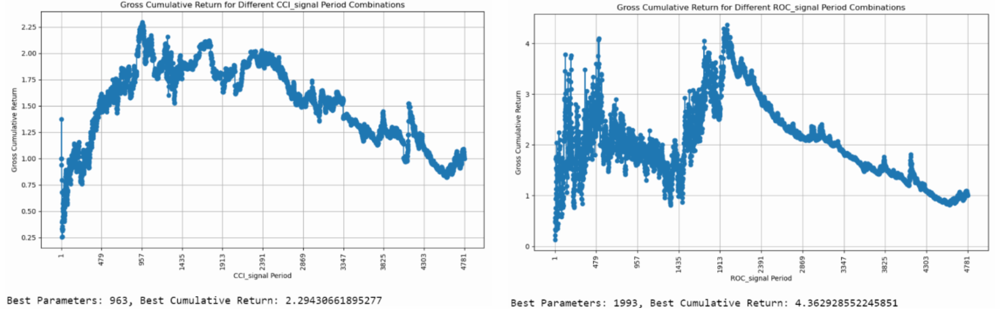

<font color='red'> (Note) </font> For single indicator, MACD generates the highest cumulative return of 774%. The paramters are: short window = 115, long iwndow = 120, singal window = 195

In [ ]:
# Store result of MACD strategy into res1
res1 = macd(sp500, 115, 120, 195)

# Does combining 2 indicators (with the respective optimal parameters) generate even higher cumulative return? 

### Optimal parameters (that generate the highest cumulative return) for each momentum indicator

In [ ]:
rsi_action = rsi(sp500, 30, 50, 40)
rsi_action.name = 'rsi_action'

sma_action = sma_strategy(sp500, 45, 50)
sma_action.name = 'sma_action'

threshold_action = threshold_strategy(sp500, 5, 0.3)
threshold_action.name = 'threshold_action'

macd_action = macd(sp500, 115, 120, 195)
macd_action.name = 'macd_action'

ADX_action = ADX_signal(sp500, 185)
ADX_action.name = 'ADX_action'

Aroon_action = Aroon_signal(sp500, 891)
Aroon_action.name = 'Aroon_action'

EFI_action = EFI_signal(sp500, 6)
EFI_action.name = 'EFI_action'

KC_action = KC_signal(sp500, 2162)
KC_action.name = 'KC_action'

TEMA_action = TEMA_signal(sp500, 836)
TEMA_action.name = 'TEMA_action'

TRIX_action = TRIX_signal(sp500, 1831)
TRIX_action.name = 'TRIX_action'

WilliamsR_action = WilliamsR_signal(sp500, 1377)
WilliamsR_action.name = 'WilliamsR_action'

CCI_action = CCI_signal(sp500, 963)
CCI_action.name = 'CCI_action'

ROC_action = ROC_signal(sp500, 1993)
ROC_action.name = 'ROC_action'

action_list = [rsi_action, sma_action, threshold_action, macd_action, ADX_action,
              Aroon_action, EFI_action, KC_action, TEMA_action, TRIX_action, 
               WilliamsR_action, CCI_action, ROC_action]

In [ ]:
combine_2 = pd.DataFrame({}, columns = ['1st Indicator','2nd Indicator','Gross Cum Return'])
for a,b in combinations(action_list,2):    
    df = pd.DataFrame()
    df[a.name]= a.copy()
    df[b.name]=b.copy()
    df['final_action'] = df.apply(check_row, axis=1)
    cum_return_res = cum_return(sp500, df['final_action'])
    net_cum_return = cum_return_res.iloc[-1]['cum_return']
    combine_2.loc[len(combine_2)] = [a.name, b.name, net_cum_return]

In [ ]:
combine_2.sort_values('Gross Cum Return')

<font color='red'> (Note) </font> For double indicators (with respective optimal paramters found previosuly), combination of MACD and TRIX generates the highest net cumulative return of 616%. The paramters for MACD are: short window = 115, long iwndow = 120, singal window = 195. The paramters for TRIX is: window = 1831

In [ ]:
# Store result of MACD + TRIX strategy into res2
res2 = pd.DataFrame()
res2[macd_action.name]= macd_action.copy()
res2[TRIX_action.name]=TRIX_action.copy()
res2['final_action'] = df.apply(check_row, axis=1)

# Choose 2 indicators and find the parameters that generate the highest cumulative return
<font color='red'> (Note) </font> Due to time constraint, we will limit the range of possible parameters for each indicator

In [ ]:
def get_rsi_params():
    window_range = range(5, 15, 5)
    buy_range = range(5, 15, 5)
    sell_range = range(5, 15, 5)

    param_combinations = [
        (window, buy, sell)
        for window in window_range
        for buy in buy_range
        for sell in sell_range
        if sell < buy
    ]
    return param_combinations


def get_sma_strategy_params():
    short_range = range(5, 15, 5)
    long_range = range(5, 15, 5)
    return [(short, long) for short in short_range for long in long_range if short < long]

def get_threshold_params():
    window_range = range(5, 15, 5)
    threshold_range = np.arange(0.1, 0.3, 0.1)
    param_combinations = list(itertools.product(window_range, threshold_range))
    return param_combinations

def get_CCI_signal_params():
    # Assuming CCI_signal has a range of parameters
    return range(1, 5, 1)

def get_WilliamsR_signal_params():
    return range(1, 5, 1)

def get_macd_params():
    short_range = range(5, 15, 5)
    long_range = range(5, 15, 5)
    signal_range = range(5, 15, 5)

    param_combinations = [
        (short, long, signal)
        for short in short_range
        for long in long_range
        for signal in signal_range
        if short < long
    ]
    return param_combinations

def get_adx_params():
    period_range = range(5, 15, 5)
    return period_range

def get_aroon_params():
    period_range = range(1, 5, 1)
    return period_range

def get_efi_params():
    period_range = range(1, 5, 1)
    return period_range

def get_kc_params():
    period_range = range(1, 5, 1)
    return period_range

def get_tema_params():
    period_range = range(1, 5, 1)
    return period_range
    
def get_trix_params():
    period_range = range(1, 5, 1)
    return period_range
    
def get_williams_params():
    period_range = range(1, 5, 1)
    return period_range

def get_cci_params():
    period_range = range(1, 5, 1)
    return period_range

def get_roc_params():
    period_range = range(1, 5, 1)
    return period_range

In [ ]:
start_time = time.time()

function_helpers = {
    "rsi": get_rsi_params,
    "sma_strategy":get_sma_strategy_params,
    "threshold_strategy":get_threshold_params,
    "macd":get_macd_params,
    "ADX_signal":get_adx_params,
    "Aroon_signal":get_aroon_params,
    "WilliamsR_signal":get_WilliamsR_signal_params,
    "CCI_signal":get_CCI_signal_params,
    "ROC_signal":get_roc_params,
    "EFI_signal":get_efi_params,
    "KC_signal":get_kc_params,
    "TEMA_signal":get_tema_params,
    "TRIX_signal":get_trix_params,
}

    
    
combine_2_b = pd.DataFrame(columns=['Gross Cum Return', '1st indicator', '2nd indicator', 'Parameters of 1st', ' Parameters of 2nd'])

for (name1, helper1), (name2, helper2) in combinations(function_helpers.items(), 2):
    param_combinations_1 = helper1()
    param_combinations_2 = helper2()

    for param1 in param_combinations_1:
        for param2 in param_combinations_2:
            
            if isinstance(param1,int): param1 = (param1,)
            if isinstance(param2,int): param2 = (param2,)
            
            func1 = globals()[name1]
            result1 = func1(sp500, *param1)

            func2 = globals()[name2]
            result2 = func2(sp500, *param2)

            df = pd.DataFrame()
            df[name1] = result1
            df[name2] = result2
            df['final_action'] = df.apply(check_row, axis=1)

            cum_return_res = cum_return(sp500, df['final_action'])
            net_cum_return = cum_return_res.iloc[-1]['cum_return']
            
            

            combine_2_b.loc[len(combine_2_b)] = [net_cum_return, name1, name2, param1, param2]
            
end_time = time.time()
elapsed_time = end_time - start_time
print(f"Best Parameters: {best_params}, Best Cumulative Return: {best_cum_return}")
print(f"Elapsed Time: {elapsed_time:.2f} seconds")

In [ ]:
combine_2_b.sort_values('Gross Cum Return')

<font color='red'> (Note) </font> For double indicators (with freely-moving paramters), combination of Threshold Strategy and ADX generates the highest net cumulative return of 84%. The paramters for Threshold Strtegy is: window = 5, threshold = 0.2. The paramters for ADX is: period = 10

In [ ]:
# Store result of Threshold + ADX strategy into res3
res3 = pd.DataFrame()
res3['threshold strategy'] = threshold_strategy(sp500, 5,0.2)
res3['adx'] = ADX_signal(sp500,10)
res3['final_action'] = res3.apply(check_row, axis=1)

# Summary
- ***(Strategy 5A)*** For single indicator, MACD generates the highest cumulative return of 774%. 
    - The paramters are: short window = 115, long iwndow = 120, singal window = 195
    
    
- ***(Strategy 5B)*** For double indicators (with respective optimal paramters found previosuly), combination of MACD and TRIX generates the highest cumulative return of 616%. 
    - The paramters for MACD are: short window = 115, long iwndow = 120, singal window = 195. 
    - The paramters for TRIX is: window = 1831

    
- ***(Strategy 5C)*** For double indicators (with freely-moving paramters), combination of Threshold Strategy and ADX generates the highest net cumulative return of 84%. 
    - The paramters for Threshold Strtegy is: window = 5, threshold = 0.2
    - The paramters for ADX is: period = 10


In [ ]:
strategy5a = pd.DataFrame({'Adj Close':sp500['Adj Close'], 'Position':res1})
strategy5b = pd.DataFrame({'Adj Close':sp500['Adj Close'], 'Position':res2['final_action']})
strategy5c = pd.DataFrame({'Adj Close':sp500['Adj Close'], 'Position':res3['final_action']})

# Strategy 5A: MACD

In [ ]:
backtest1=Backtest(strategy5a,100000,0)
backtest1.plot_all_stats()

# Strategy 5B: MACD + TRIX

In [ ]:
backtest2=Backtest(strategy5b,100000,0)
backtest2.plot_all_stats()

# Strategy 5C: Threshold + ADX

In [ ]:
backtest3=Backtest(strategy5c,100000,0)
backtest3.plot_all_stats()

### ~Strategy 5 Ends

# PART 2

## Strategy 1: Supervised learning of decision tree (CART) with feature engineering

Among all strategies, Decision tree (CART) has the most overfitted results that gave the highest final account balance at 1.35e^21, cumulative return, CAGR, Sharpe Ratio, zero drawdown and Sortino Ratio. Due to the requirement of this assignment, overfitted results are expected when backtesting is done with in-sample data.
In addition to the evaluation metrics requested, our team sought to emulate performance reporting on a “% Return by Quarter” basis. 

In [ ]:
#insert link to strategy 1

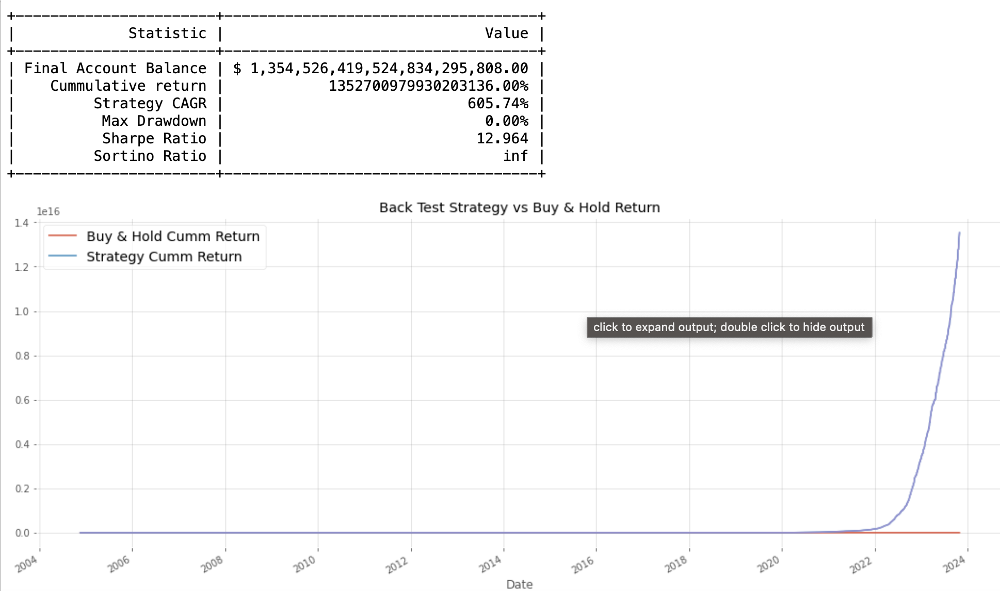

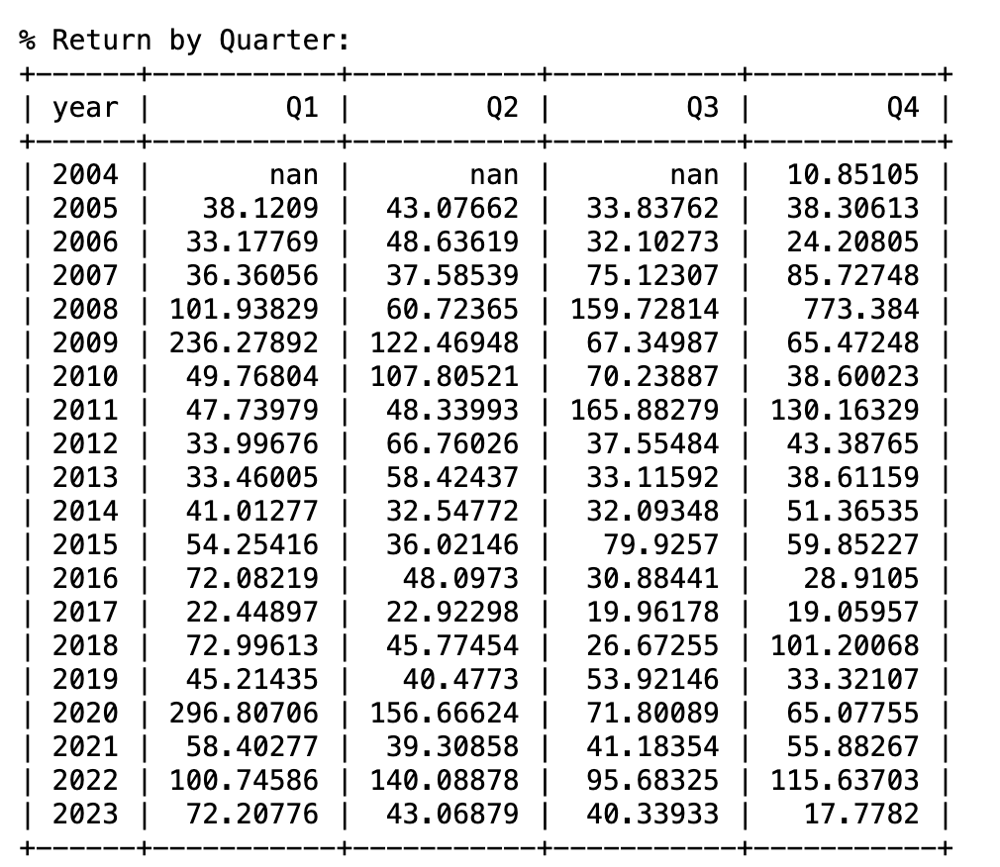

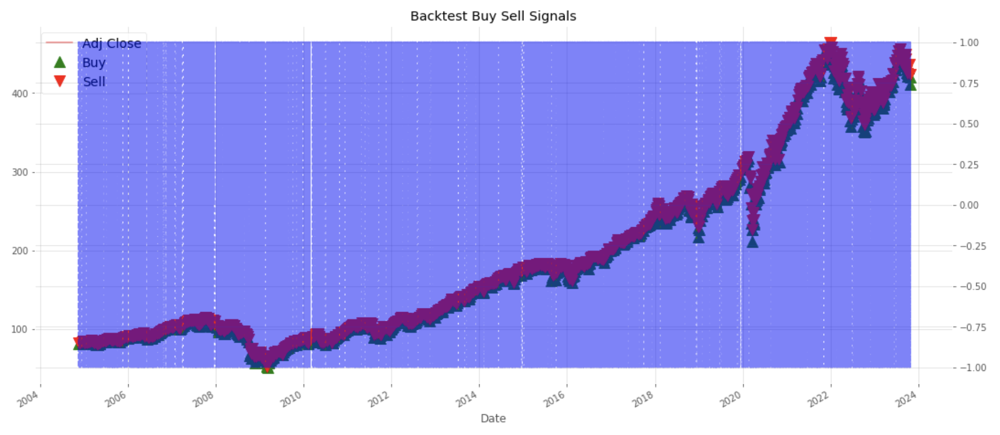

### Strategy 2: Using other global indices together with Crude Oil Prices, Bond and S&P futures and engineered features to fit Machine Learning models to predict and trade on SPY.


In [ ]:
#insert link to strategy 2

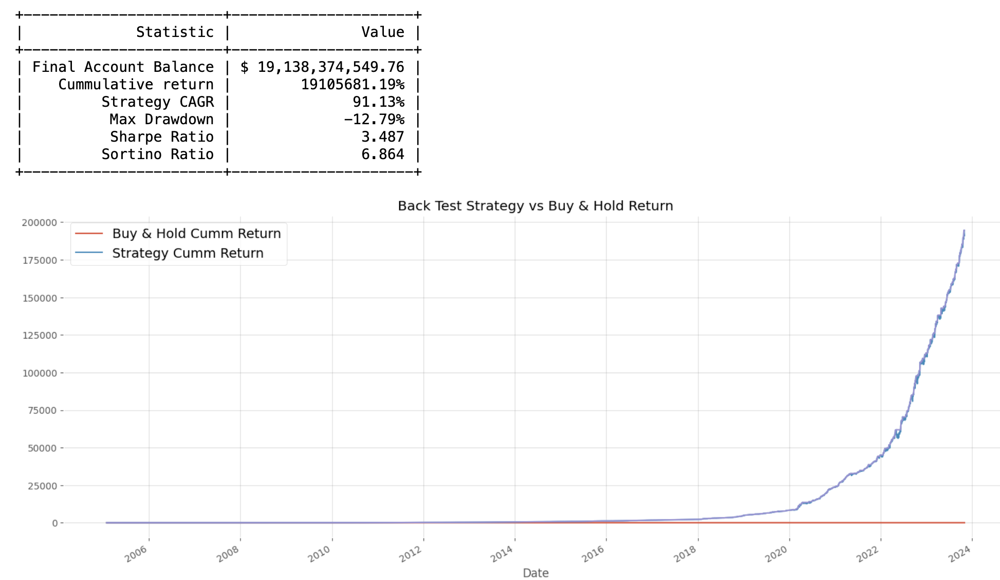

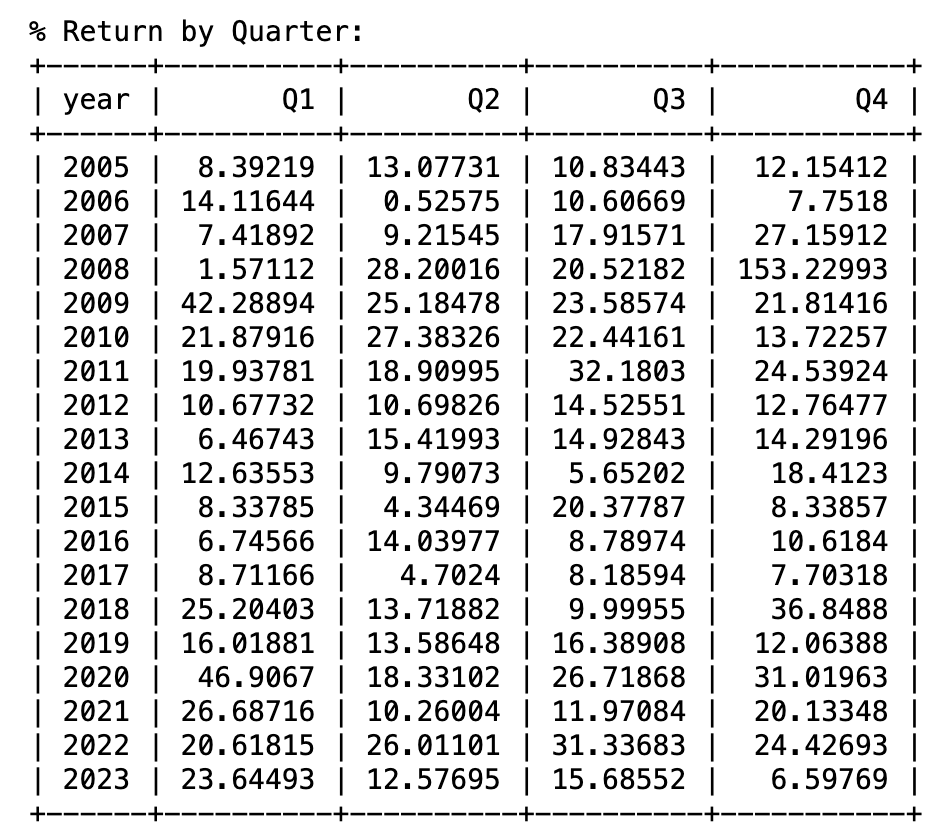

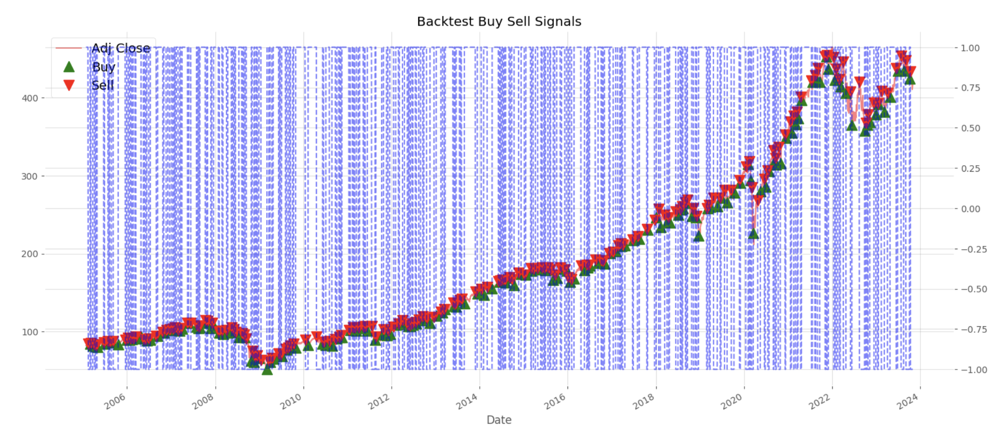

### Strategy 3: Supervised learning of linear regression(OLS) following by logistic regression, focusing on feature engineering and hyperparameter tuning with long & short directional bets

In [ ]:
#insert link to strategy 3

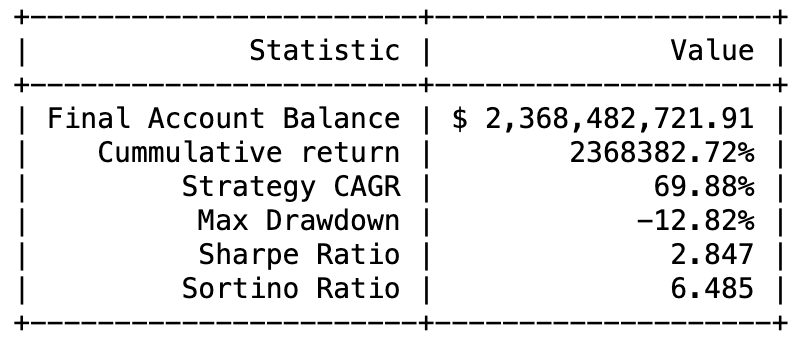

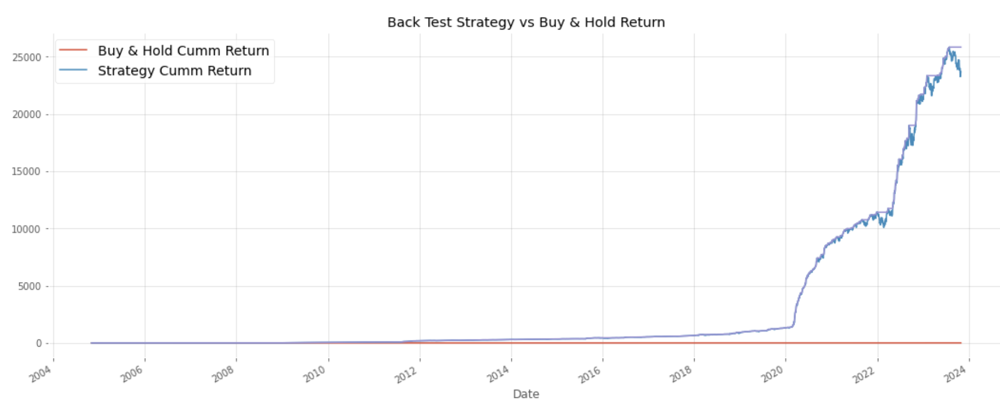

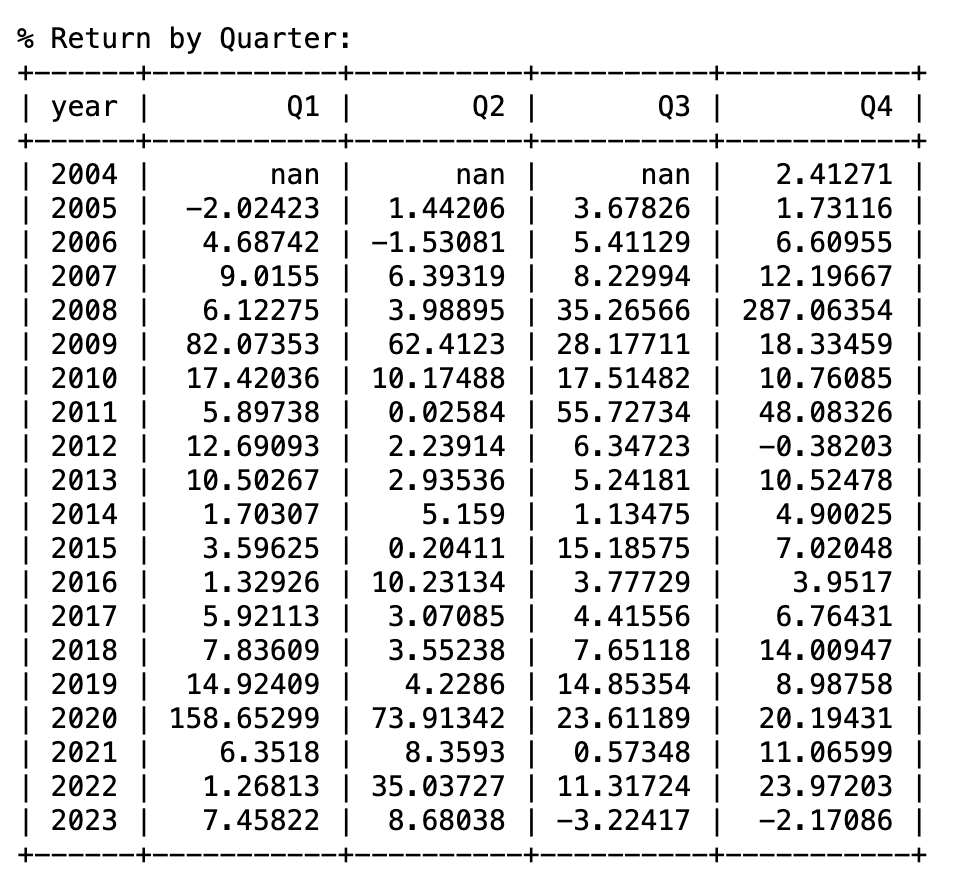

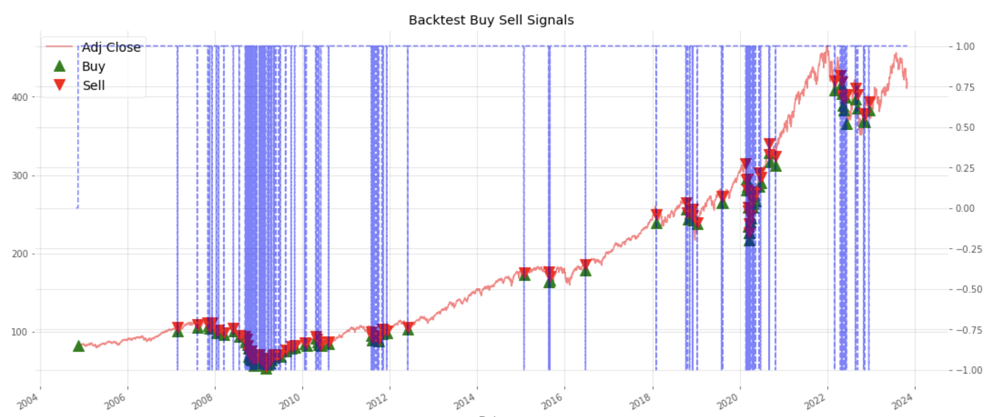

### Strategy 4a: Mean reversion strategy using simple moving average 

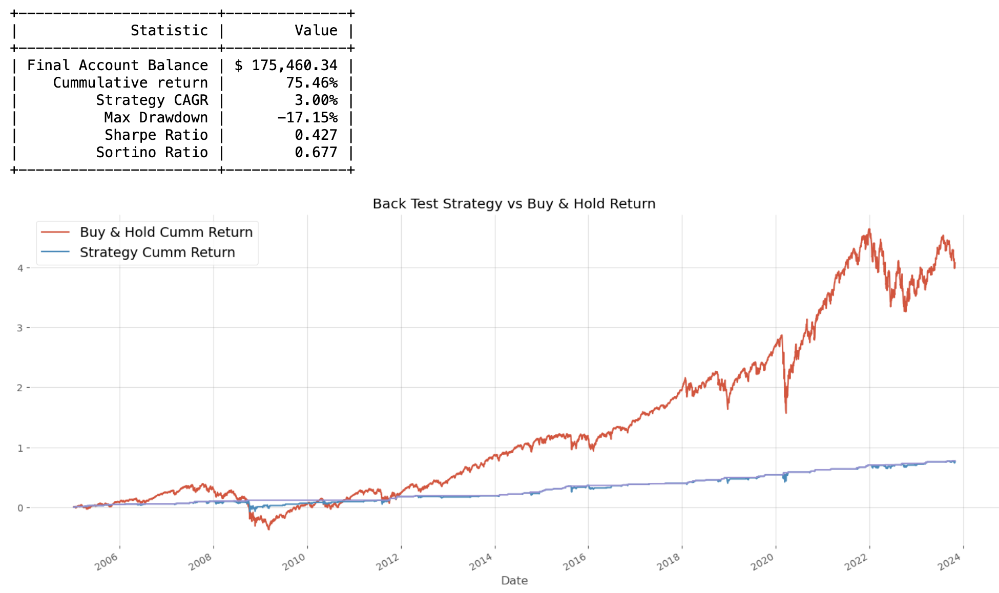

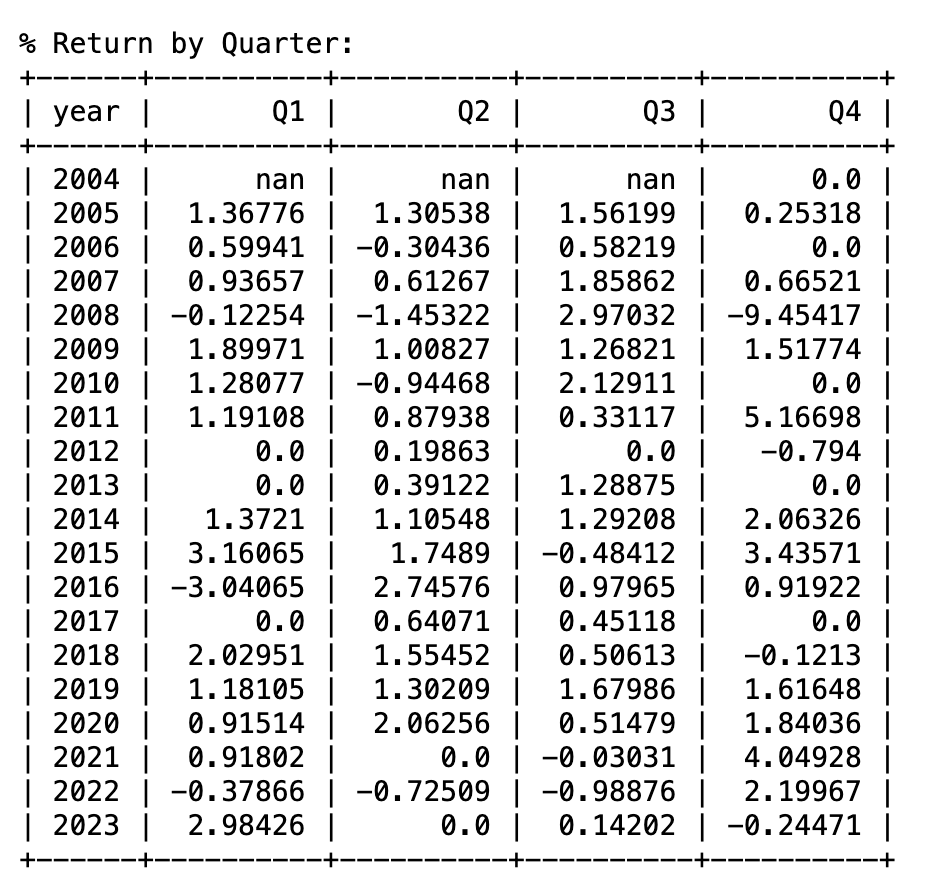

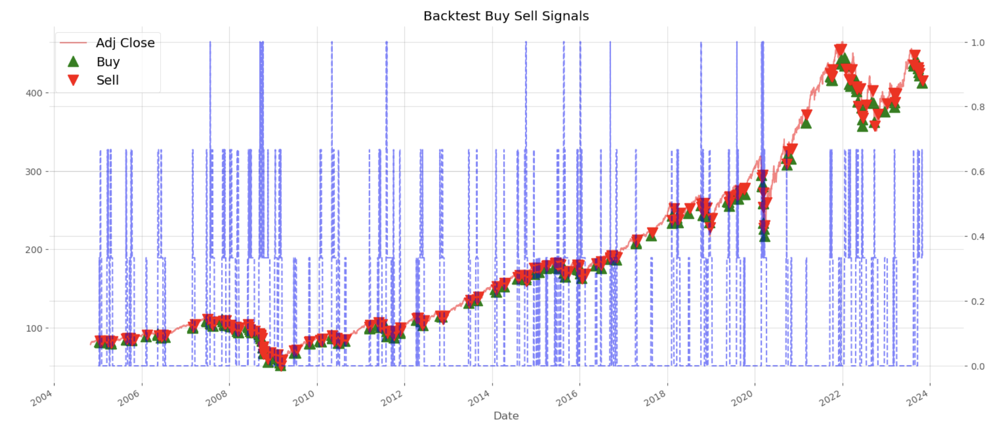

In [ ]:
#insert link to strategy 4a

## Strategy 4b: Multi-position mean reversion strategy using efficient capital allocation, based on the magnitude of the z-score


In [ ]:
#insert link to 4b

## Strategy 5a:

In [ ]:
#insert link to 5a

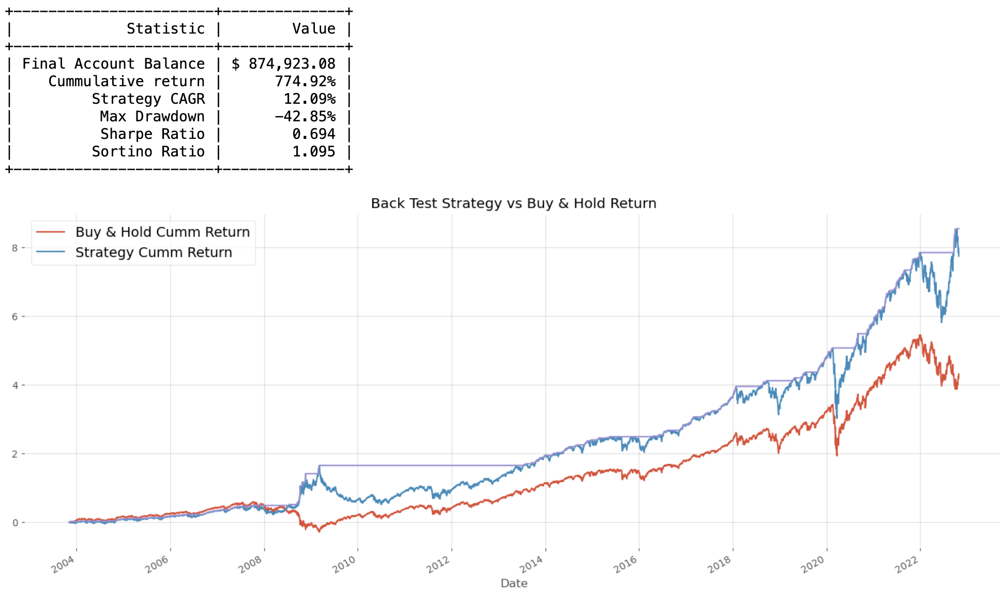

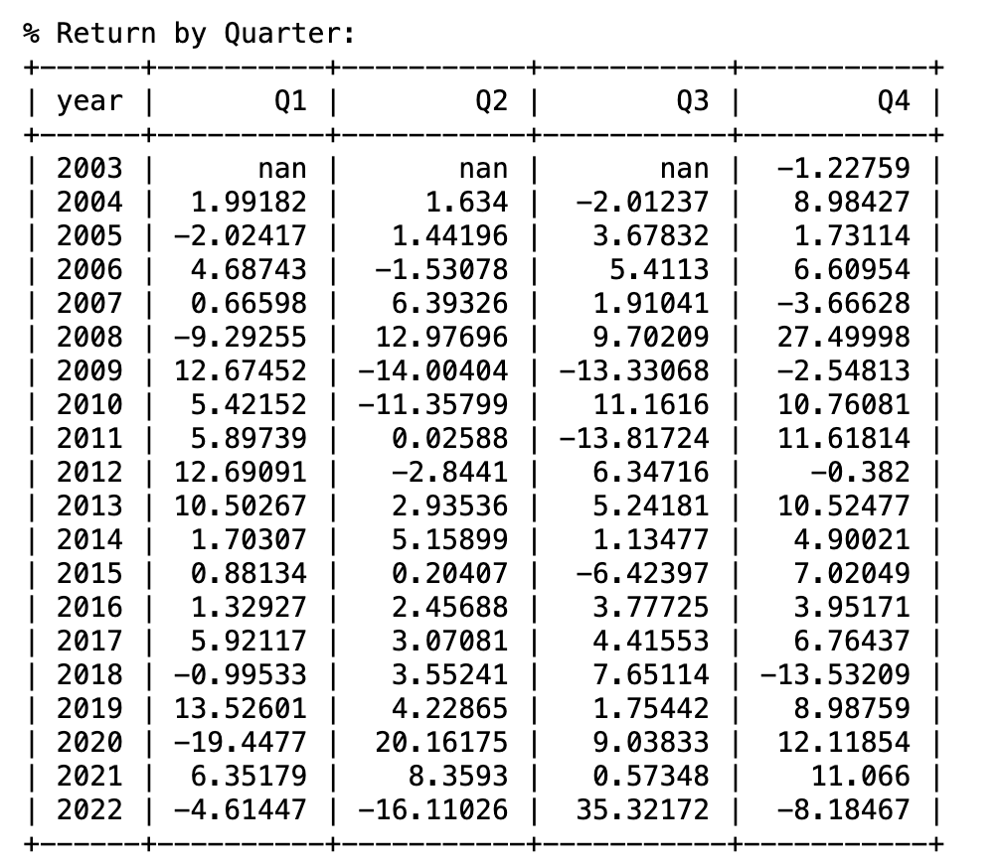

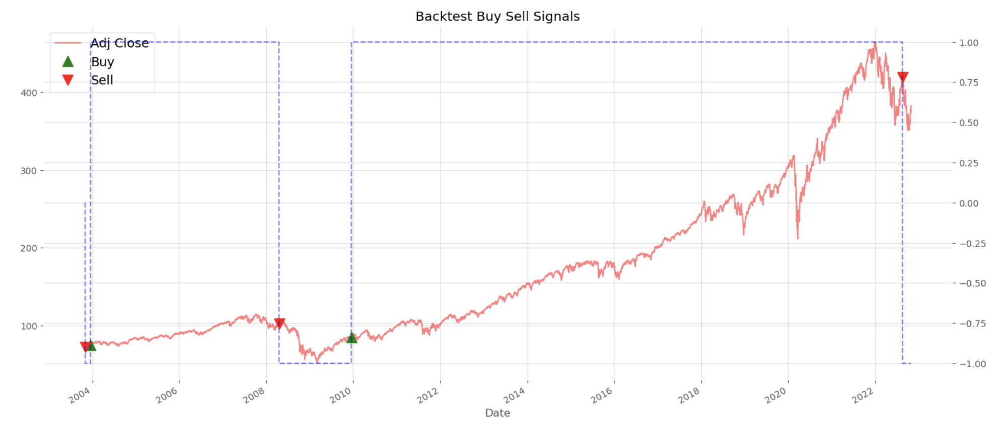

## Strategy 5b:

In [ ]:
#insert link to 5b

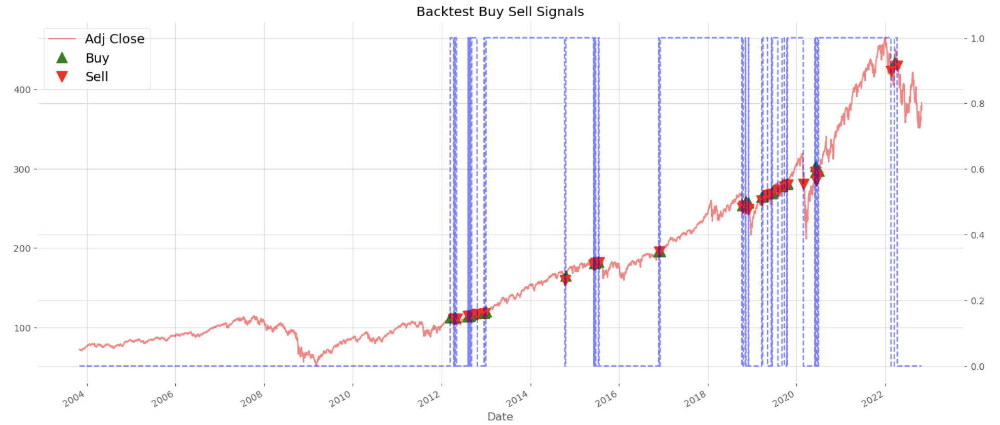

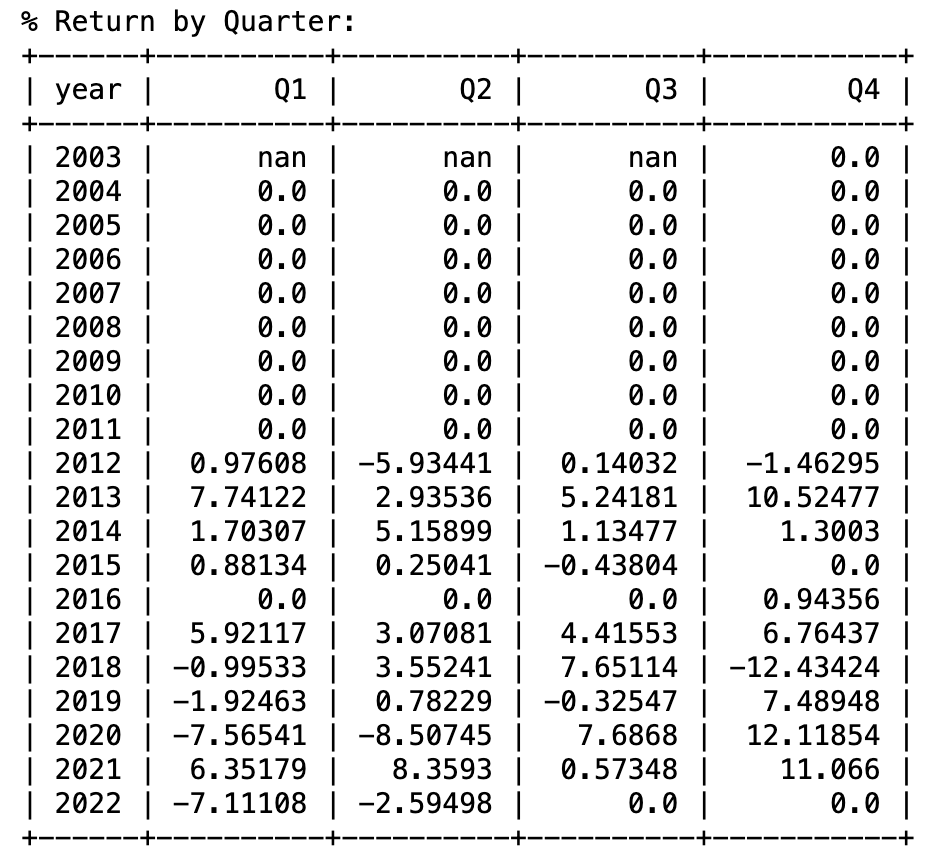

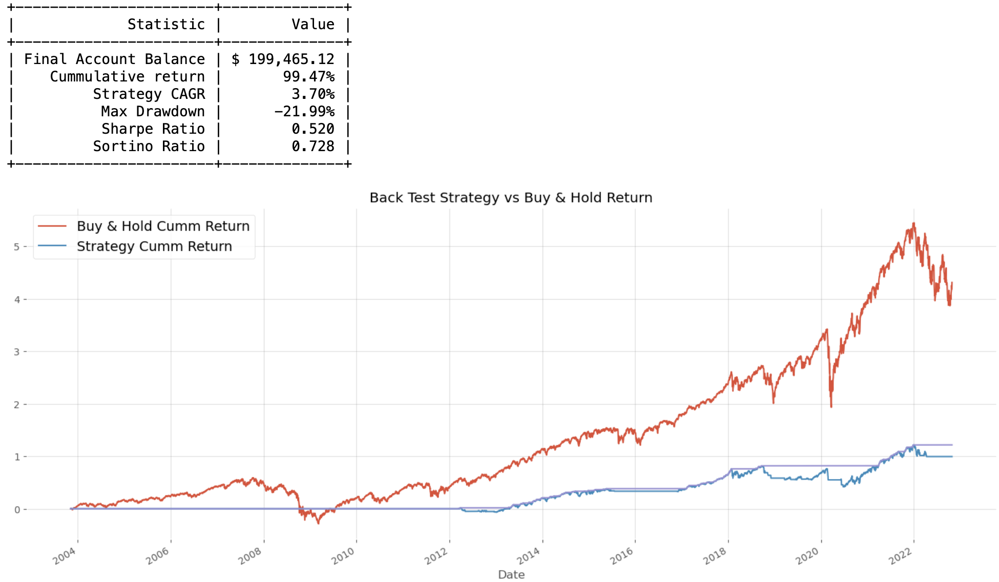

## Strategy 5c:

In [ ]:
#insert link to 5c

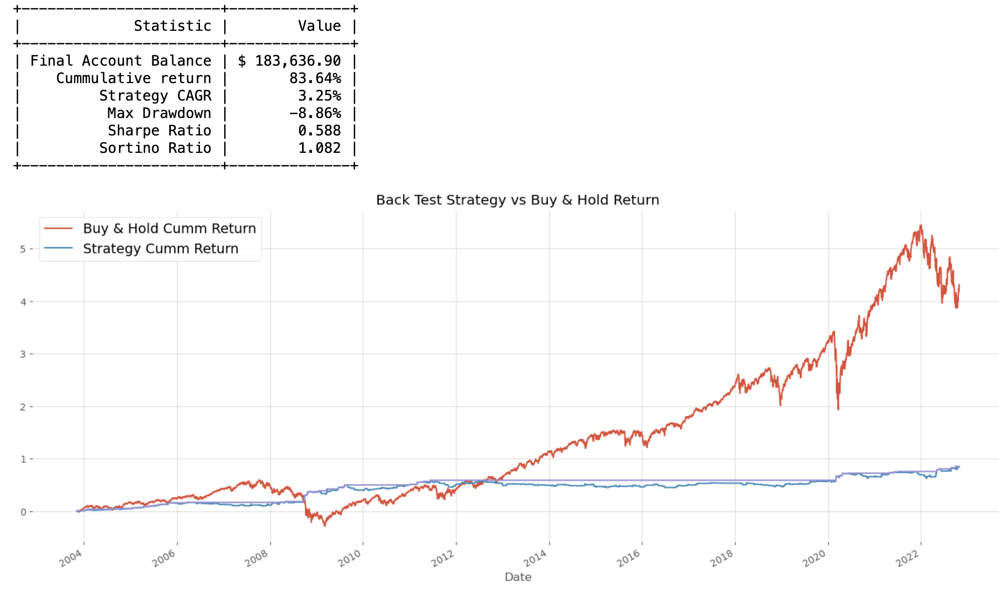

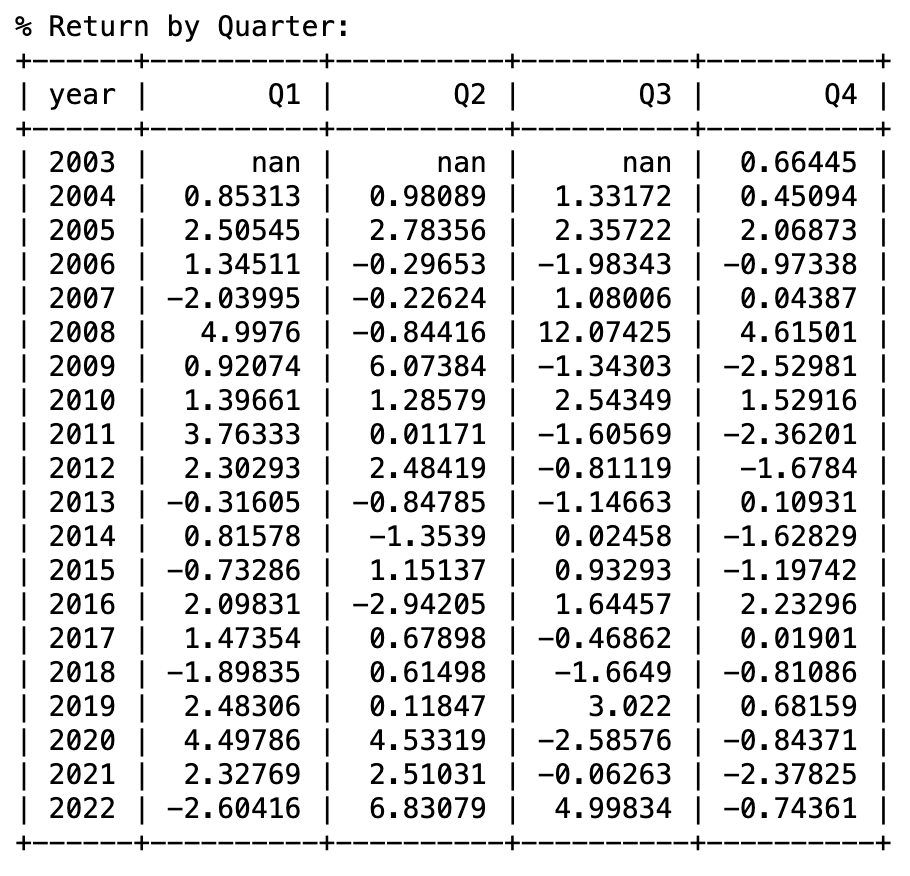

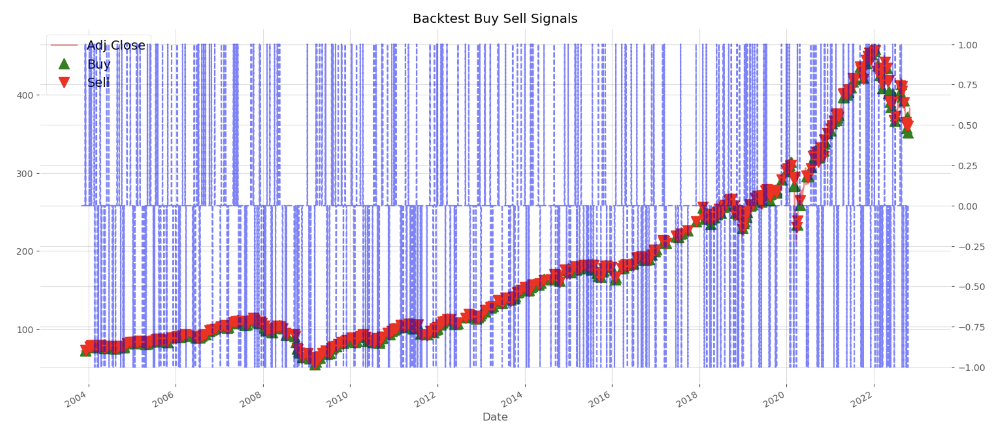

# Part 3

### Abstract

Among all strategies and within the premise of this assignment, our team decided that the results produced by Strategy 1 was the best in terms of cumulative return. By this merit of highest accumulated returns, the team was confident that it will be an outperformer. It also has the lowest drawdown (of 0)  among all strategies. Because there is no drawdown, there is no downside risk and this attribute will attract risk-averse investors. 

However, beyond the requirements of this assignment, our team believes that out-of-sample results mattered more than in-sample results. Therefore, in that vein, it is perhaps more appropriate and realistic to go with strategy 2 that has decent out-of-sample results. 

If we perform a 80:20 data split, the team observed the strategy's CAGR of 25.33% that would be far superior than a S&P long run return of approximately 8-9%pa. The maximum drawdown could go as high as 20% but it is understandable because there was a market regime shift induced by Covid19. Furthermore, sharpe ratio that is greater than 1 informs that the annualised return(numerator) outweighs the annualised volatility (denominator) of strategy.

Strategy 1:

Among all strategies, Decision tree (CART) has the most overfitted results that gave the highest final account balance at 1.35e^21, cumulative return, CAGR, Sharpe Ratio, zero drawdown and Sortino Ratio. Due to the requirement of this assignment, overfitted results are expected when backtesting is done with in-sample data.
In addition to the evaluation metrics requested, our team sought to emulate performance reporting on a “% Return by Quarter” basis. 

Because the decision tree is able to overfit perfectly with zero mean squared error, there are trading signals every time SPY’s returns cross 0%. This explains the abundance of the blue vertical lines.

Sharpe ratio is the excess expected return of strategy per unit of risk and a higher sharpe ratio is indication that strategy can perform well, after factoring strategy volatility. Overfitted CART had an annualised sharpe ratio of 1296\% and it was the highest sharpe ratio among all strategies. Because there was no drawdown, sortino ratio was not a valid evaluation metric.

Lastly, the Compound Annual Growth Rate (CAGR) is 608.99\% which is again a highly impractical number. However, in this assignment, the strategy will outperform a “buy-and-hold” strategy which only has a CAGR of 9.21\%, by approximately 66 times.

In [ ]:
#insert link to strategy 1

Strategy 2:

The team paid attention on the choice of features.Using various indices globally along with Crude oil futures and Bond Futures, the team tried multiple Machine Learning Model to predict SPY movements and select ETR (Extra Tree regression) which is a tree based ensemble model as our model of choice as we are looking for in-sample backtesting. 

Choosing ETR as our model of choice, below is the Backtesting result when using full 20 years as In-Sample data. This Strategy has a Final Remaining Balance of 19.14 billion dollars. The high number in-sample is driven by over-fitting.

Over-fitting was again expected since In-sample data was used for backtesting. To further gauge the effectiveness of the model, the team performed out of sample backtest as well which gave convincingly good results. This strengthens the robustness of the model. We used 80% training set and 20% validation set here. The Out Sample Period was from Jan-2020 till October-2023. We achieved a CAGR of 25.33% in the out of sample period beating S&P by about 16% CAGR every year. 


In [ ]:
#link link to strategy 2

Strategy 3: 

The third strategy employs linear regression which is basically ordinary least square regression and its outputs are fed into logistic regression. Thereafter, strategy was optimized using elastic net regularization on the hyper-parameter, L1ratio which controls the balance between Lasso and Ridge regularization. The team has also expanded hyperparameters optimization by considering the degree of polynomial in features, hyperparameter k, which is the number of variables with highest f-regression output in feature engineering. 

In this optimization exercise, the objective function is to maximise the end-day account balance. The table below shows the optimized hyperparameters and the ideal parameters are degree = 2, k = 10 and 0 <= penalty_ <= 0.2.

Final account balance was 2.36e^9. This strategy produced the third highest account balance. CAGR was decently high at 69.87% and the maximum drawdown was 12.82%. Sharpe ratio is 2.847. These statistics are ranked third among all strategies,  consider risk and returns.

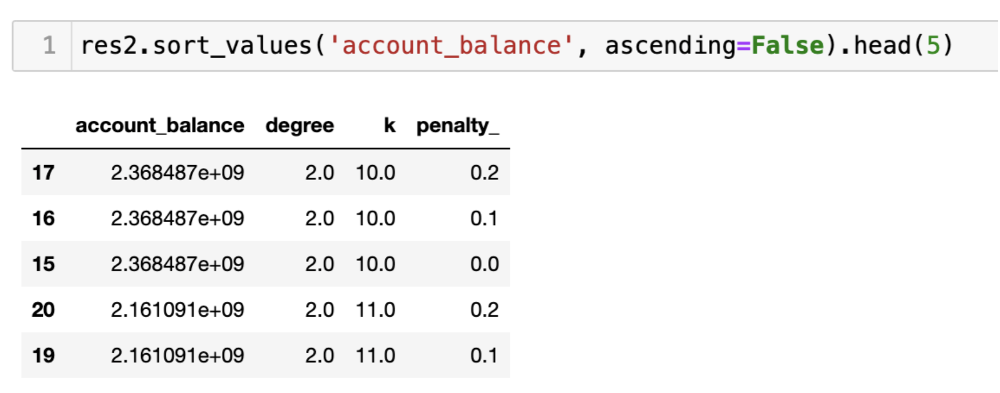

In [ ]:
#insert link to strategy 3

Strategy 5a:

Parameters of MACD Strategy : Short window = 115 days, Long window = 120 days, Signal window = 195 days

It can be seen below that the blue (strategy) line generally follows the red (passive) line. However, due to good timing of entrance and exit and the compounding effect. The strategy return outperforms the passive baseline.
 
A Sharpe Ratio greater than 1.0 is generally considered good, indicating that returns are high relative to the risk taken. A ratio between 1.0 and 2.0 is considered very good, and a ratio of 2.0 or higher is excellent.

The Sharpe ratio of Strategy 5A of 0.694  that the investment's return is less than one standard deviation away from the risk-free rate. While this is below 1, which is not exceptionally good, it's still a positive number, indicating that the investment is generating excess returns over the risk-free rate.

In comparison, Sharpe ratio of strategy 1 is 12.964, which is much higher than 0.694. This is partly due to the assumption of $0 transaction cost. Strategy 1 has a lot more buying and selling done throughout the data period, a lot of which may not have happened if we incorporate transaction cost. 

A CAGR of 12.09\% is quite good and would generally be considered a strong performance, especially if this return is consistent over a long period. It's above the historical average annual return of the stock market, which, is around 7% to 9% when adjusted for inflation

A Max Drawdown of -42.85\% is relatively high, which indicates that at some point, the investment lost nearly half of its value before recovering. This could be a concern for risk-averse investors, as it suggests significant volatility and potential for large losses. A Max Drawdown at this level would typically require a higher risk tolerance.

In comparison, max drawdown of strategy 1 is 0\%, which suggests overfitting.

In [ ]:
#insert link to strategy 5a

Strategy 5b:

Parameters of MACD Strategy : Short window = 115 days, Long window = 120 days, Signal window = 195 days
Parameters of TRIX: Period = 1831
The blue (strategy) line significantly underperforms the red (passive) line. This suggests that simply combining multiple indicators with the optimised parameters does not give rise to better performance. 


In [ ]:
#insert link to strategy 5b

Strategy 5c:
    
Threshold strategy : window = 5, threshold = 0.2
ADX : period = 10

Once again, the blue (strategy) line significantly underperformed the red (passive) line. This suggests that sometimes, having a complicated strategy does not always beat a simpler strategy, hence we should analyse the pros and cons before embarking on the formulation of a complicated strategy, and ask ourselves “Is there added value that justify the added effort?”


In [ ]:
#insert link to strategy 5c

# Part 4

## Critique on strategy level

### Supervised Learing (CART & Logistic Regression)

After examining various models, the team decided to explore CART and linear/logistic regressions as the 2 models have the lowest in-sample errors.

Categorical & Regression Tree (CART) is a highly overfitting supervised learning method where strategy will take a long or short position with 100% of active account balance. 

While linear and logistic regressions generally do not overfit as much and retents some generability in model, the team saw overfitting results due to in-sample backtesting.

There was no drawdown at any point throughout the backtest horizon. This implies that supervised learning under in-sample backtest conditions was the supreme strategy that produced the highest account balance at the end of trading period with a grand total of $1.35e+21 dollars. This was because there were 100\% of accurate predictions within the in-sample-backtesting space with no mean-squared error.

On hindsight, the team noted that the backtesting with in-sample was incredibly unrealistic because when the strategy was backtested with out-of-sample results, more erroneous predictions are expected on both long and short positions. 

### Mean Reversion Strategy

Within the mean-reversion strategy, the team attempted to find out the optimal mean reversion period which maximises the remaining capital by setting up a loop. Our findings revealed that a 9-day mean-reversion window gave the highest remaining capital. It produced a Sharpe Ratio of 0.521, a CAGR of 6.31% and a max drawdown of 28.1%.

Despite strategy’s CAGR remained lower than a simple ‘buy and hold’ strategy, possibly due to the significant trend component of the time series, the team noted modest performance of the strategy. 

High drawdown of 28.1% is one of the team’s strategies that have larger drawdowns. This may not sit well with risk-averse investors.

A 3-position mean-reversion strategy at a mean-reversion period of 34 days, yields the highest capital remaining and therefore a CAGR at 3.00% and a Sharpe Ratio at 0.427, but effectively reduces the maximum drawdown to 17.15%. The lower return is mostly due to the idling of a noticeable proportion of the total capitals during the trading period.

On top of the two mean reversion strategies, our group also attempted introducing alternative trading signals such as Relative Strength Index (RSI) indicator. This involves setting aside a proportion of the capitals to specifically trade on the RSI signals.

However, by investigating the optimal proportion of the capital for trading the RSI signals, we found out that the result suggested that the RSI trading is dominated by the mean reversion trading in terms of returns, unfortunately. This may also highly due to the trended nature of the historical time series, which hampered the effectiveness of referring to RSI indicators.


 <a id='Part_4_Analysis_Survivorship_Bias'></a>

### Part 4: Analysis on conceptual level 
#### Survivorship Bias S&P: 

Survivorship bias was the most common bias which impacted each and every strategy we created.

A simple way to understand Survivorship Bias is through an example from World War II (shown in the picture below), when the U.S. military examined the damage sustained by aircraft returning from missions and initially concluded that armour should be added to the areas that were most hit (figure on the left). Statisticians later stepped in to point out the inherent Survivorship Bias that the aircrafts that had been shot down were excluded from assessment. Therefore, the bullet holes in the returning aircraft likely represented areas where aircrafts could take damage and still manage to return to home base and the conclusion was changed to add armour in the least hit areas (figure on right).

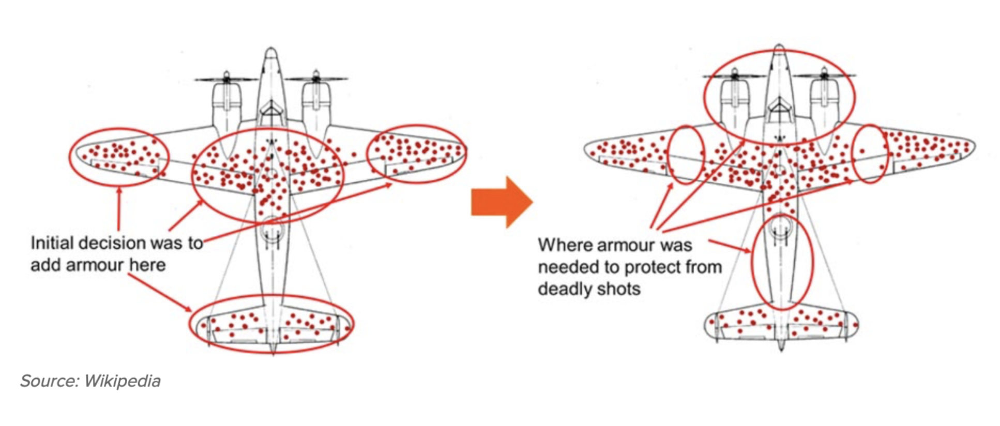

Similarly, Survivorship bias can be significant when dealing with financial data because total number of companies are rarely constant, with old companies either dropped from an Index or shutting down and new ones being added or launched. Survivorship bias is present in this project by the nature of how SP500 index is defined. SPY constituents change in a way that mirrors the Index and as backtesting uses historical data, the assumption that SPY constituents are static is far from reality.
An analysis has been shown in our submitted Python notebook as well to present an impact of Survivorship bias on S&P 500 for the time period between Nov-2004 to Oct-2023. We found that ~300 companies were dropped and replaced in the S&P 500 Index during the 20 year time period we are looking at. Below is a plot of how many companies survived in the S&P500 Index over this time period.

An analysis has been shown in our submitted Python notebook as well to present an impact of Survivorship bias on S&P 500 for the time period between Nov-2004 to Oct-2023. We found that ~300 companies were dropped and replaced in the S&P 500 Index during the 20 year time period we are looking at. Below is a plot of how many companies survived in the S&P500 Index over this time period.


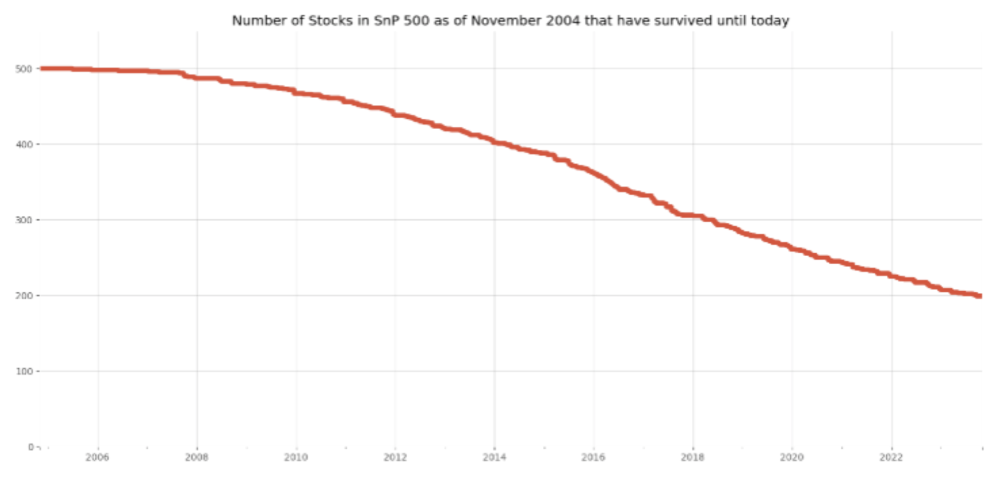

We further compare the total return of a static portfolio of just the final 199 companies (Blue line in the plot below) which survived over this time period and compare it against the S&P 500 Index (Red Line) which had companies being added and removed over time. Below is a plot of both these returns.

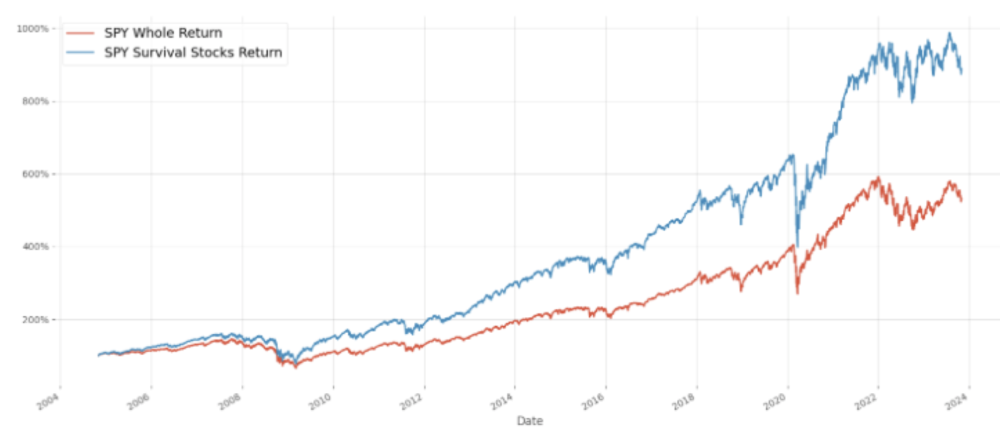

We can clearly see that the returns from the Portfolio with Survivorship bias i.e. static portfolio ignoring all stocks which were removed or newly added in S&P 500 is significantly higher than the actual S&P 500 return. We can also define the gap between the 2 returns above as the Survivorship bias. This exactly impacts the backtesting of our trading strategies as well.
It is apparent that this assumption is over-simplifying the chaotic nature of the future market. New constituents that are not trained in the machine learning models could induce unexpected variance. The repercussion is that strategy returns could manifest differently in actual deployment. Therefore, this manner of backtesting loses credibility because of survivorship bias. 
This also brings back the point that the strategies should not overfit in-sample data and retain some level of parsimony and generality. 
A possible way to circumvent survivorship bias is to include delisted stocks in the analysis so as to get a more accurate backtesting performance which is more likely to hold in the future.


### This subsection is dedicated to the codes, analysing survivorship bias. 

### More analysis below! 

In [ ]:
snp_log = pd.read_html("https://en.wikipedia.org/wiki/List_of_S%26P_500_companies")[1]
snp_log.columns=['Date', 'Added-Ticker','Added-Security','Removed-Ticker','Removed-Security','Reason']
snp_log.set_index('Date', inplace=True)
snp_log.index = pd.to_datetime(snp_log.index)

In [ ]:
#Companies added between 2004 and 2023
Companies_Added=snp_log[(snp_log.index >'2004-11-1') & (snp_log.index <'2023-10-1')][['Added-Ticker','Added-Security','Reason']]
#Companies_Added[Companies_Added.isnull().any(axis=1)]
Companies_Added=Companies_Added.dropna()
Companies_Added=Companies_Added.sort_values(by='Date')
Companies_Added

In [ ]:
#Companies Removed between 2004 and 2023
Companies_Removed=snp_log[(snp_log.index >'2004-11-1') & (snp_log.index <'2023-10-1')][['Removed-Ticker','Removed-Security','Reason']]
#Companies_Removed[Companies_Removed.isnull().any(axis=1)]
Companies_Removed=Companies_Removed.dropna()
Companies_Removed=Companies_Removed.sort_values(by='Date')
Companies_Removed

In [ ]:
Companies_Removed['count']=1
Companies_Removed['count'].groupby(by='Date').sum().cumsum()
date_range = pd.date_range(start='2004-11-01', end='2023-10-31', freq='D')
survivor_companies=pd.DataFrame(index=date_range)
survivor_companies=pd.concat([survivor_companies,Companies_Removed['count'].groupby(by='Date').sum().cumsum()],axis=1)
survivor_companies=survivor_companies.ffill()
survivor_companies=survivor_companies.fillna(0)
survivor_companies['count']=500-survivor_companies['count']
survivor_companies

In [ ]:
ax=\
(
    survivor_companies['count']
    .plot(figsize=[18,8]
         ,lw=5.0)
)

ax.set_title('Number of Stocks in SnP 500 as of November 2004 that have survived until today')
ax.set_ylim(0,550)
plt.show()

In [ ]:
snp_constituent= pd.read_html("https://en.wikipedia.org/wiki/List_of_S%26P_500_companies")[0]
snp_constituent.set_index('Date added', inplace=True)
snp_constituent=snp_constituent.sort_values(by='Date added')
snp_constituent_survived=snp_constituent[snp_constituent.index<'2004-11-01']
snp_constituent_survived

In [ ]:
tickers_survived=snp_constituent_survived['Symbol'].to_list()

In [ ]:
start="2004-11-1"
end="2023-11-1"
tickers_survived_data=pdr.get_data_yahoo(tickers_survived,start,end)

In [ ]:
tickers_survived_data =tickers_survived_data.loc[:,('Adj Close',)]

In [ ]:
tickers_survived_data

In [ ]:
missing_values =\
(
    tickers_survived_data
    .isnull() # True (1) vs. False (0)
    .mean()
    .sort_values(ascending = False)
)

missing_values.head(10)

In [ ]:
drop_list =\
(
    sorted(list(missing_values[missing_values > 0.01]
                .index)
          )
)

drop_list

In [ ]:
tickers_survived_data =\
(
    tickers_survived_data
    .drop(labels = drop_list,
          axis = 1)
)

tickers_survived_data

In [ ]:
tickers_survived_return=tickers_survived_data.pct_change()
tickers_survived_return

In [ ]:
tickers_survived_return['Portfolio Return'] = tickers_survived_return.mean(axis=1)
tickers_survived_return

In [ ]:
start="2004-11-1"
end="2023-11-1"
spy_data=pdr.get_data_yahoo('SPY',start,end)
spy_data['Return']=spy_data['Adj Close'].pct_change()
spy_data

In [ ]:
ax=\
(
    spy_data['Return']
    .add(1)
    .cumprod()
    .multiply(100)
    .plot(figsize=[18,8]
         ,label='SPY Whole Return')
)

ax=\
(
    tickers_survived_return['Portfolio Return']
    .add(1)
    .cumprod()
    .multiply(100)
    .plot(figsize=[18,8]
         ,label='SPY Survival Stocks Return')
)

ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.0f}%'))
plt.legend()
plt.show()

### ~ Part 4 Analysis - Survivorship bias ends

<a id='Part_4_Analysis_MarketRegime'></a>

# Part 4 Analysis on conceptual level 
#### Lookahead Bias

Look-ahead bias in backtests are the result of using information that would not normally be available for the execution of a signal when it occurs. It is one of the worst forms of bias as it can completely invalidate the results.

The orientation of this assignment is unlike any other. The team is tasked to backtest with in-sample data, which means we have information from the future when signals in backtesting are generated. This is data leakage. In this setting, we are able to hypertune our strategies to overfit and beat the market. These are several observations and criticisms of our alphas specially for the ones using Machine Learning.

Since we are training and backtesting our Machine Learning model using the same set of data, we have perfect knowledge of the incoming stream of data and how the next market price will move. This means, strictly in this assignment, alpha strategy could unveil in such a way that strategy did not need to wait for the signal from preceding day in order to decide on a buy or sell decision. 

Look-ahead bias can easily slip into our non-Machine Learning based trading strategies as well. For example, since we already know S&P 500 has been trending in the last 20 years, we would focus more on trend following strategies to get a better back testing result which may or may not hold in the future. 

In this exercise, the team has tried their best not to be influenced by any unnecessary look ahead biases. Hence, there were efforts to extensively reviewed the codes to ensure that the back testing signals do not refer to any information from the future.

### Part 4 Analysis on conceptual level 
#### Market Regime Shift

Market regime shift is a source of risk in quantitative trading strategies because back-tested strategies are done on historically "similar" data. In a regime-shift, there is no historical data to perform backtesting on and the employed strategy is unlikely to perform as well with in-sample data.

To address this concern, our team has employed Kmeans algorithm to perform clustering on the two time series of SPY and CBOE’s VIX index. In this exercise, the team consumed the knowledge from QF627 semester that prices are lagging indicators. VIX is chosen because, under efficient market hypothesis, implied volatility could contain some information about traders expectation of future volatility. 

The choice of distance measure was Dynamic Time Warping which, according to our research, could be suitable for time series with temporal price dislocations(example, onset of Covid19), as compared to Euclidean or Manhattan distance. 

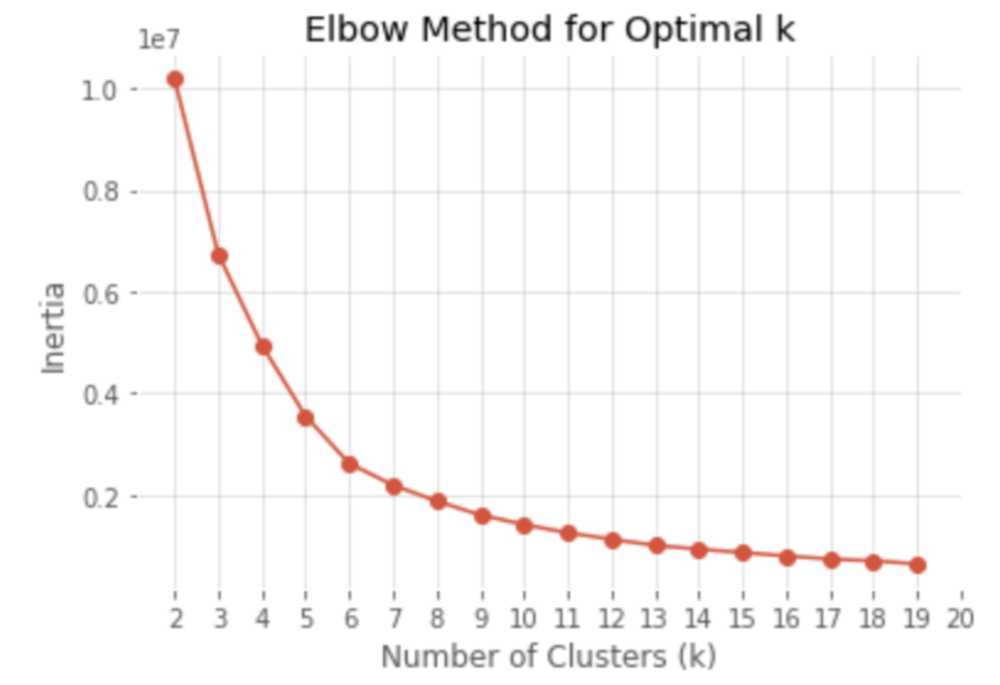

Using the “elbow method” and searching for the highest second order derivative of the inertia in the range of 2<=k<=20, optimised analysis revealed that there were 3 distinctive clusters in total. Because the number of clusters was found to be greater than 1, this is an indication of the presence of market regime shifts. In this exercise, it is useful to perform clustering so that the strategy could adapt and perform even under different market regimes. Unfortunately, due to time constraint, the team has not been successful at implementing a new strategy that leverages on this information.

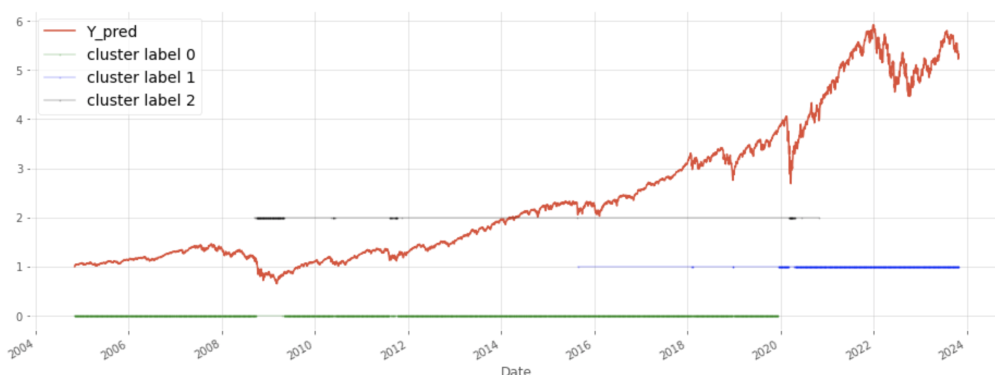

By analysing the start date of cluster label 2 (in black), the data showed that a market regime shift happened on 17th Sep 2008 and the start date of cluster label 1(in blue) showed a second regime shift happened on 13th Dec 2019. The results could be attributed to the Global Financial Crisis in 2008 and Covid19 2020. Another ex-post observation was that cluster label 2 was pointing out the trough (lowest point) of SPY. This part of analysis required domain knowledge and some kind of inference. Nonetheless, the approach had been data-driven and the conclusion made economical sense.

This points out a critical point about backtesting. Price information in the future is unknown and the only way, to have a sense (but not firm grasp) of the strategy performance in the real world, is to perform backtesting with out-of-sample data. It will be the closest simulation that reflects the real world.  

Additionally, underplaying the effects of market regime shift in model training could have an underwhelming performance in an out-of-sample or real world deployment. 

### This section below is dedicated to code, analysing Market Regime Shift

### There are more analysis after this section of code! please scroll down. 

In [ ]:
#Dependencies

#time series standardardisation
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

# KMeans
from sklearn.cluster import KMeans
from tslearn.metrics import dtw
from sklearn.metrics import pairwise_distances

In [ ]:
start_date = dt.datetime(2004,11,1)
end_date = dt.datetime(2023,11,1)

spy = pdr.get_data_yahoo("SPY", start = start_date, end = end_date)["Adj Close"]
spy.name = "SPY"

vix_ticker = "^VIX"
vix = pdr.get_data_yahoo(vix_ticker, start=start_date, end=end_date)["Adj Close"]
vix.name = "VIX"

spy_vix = pd.concat([spy, vix], axis = 1)

Y = np.log(spy).diff(1)
Y.name = "Y_pred"

spy_vix

In [ ]:
#pd.read_excel("regime_dict_19_nov.xlsx")

#run the file if you don't want to run the DTW and clustering algorithms.

In [ ]:
regime_dict1 = {}

inertia_list1 = []

#clustering to detect regime change 
max_clusters = len(pd.unique(spy_vix.index.year)) 

X_scaled = StandardScaler().fit_transform(spy_vix)
X_scaled = X_scaled.reshape(X_scaled.shape[0], -1)

# Compute DTW distances
dtw_distances = pairwise_distances(X_scaled, metric=dtw)

In [ ]:
for num_cluster in range(2, max_clusters):
    kmeans_model = KMeans(n_clusters=num_cluster, random_state=627)
    kmeans_model.fit(dtw_distances)
    inertia_list1.append(kmeans_model.inertia_)
    spy_vix['cluster_label'] =\
    (kmeans_model
             .fit_predict(dtw_distances)
    )
    
    regime_dict1[num_cluster] = spy_vix['cluster_label']
    print(" ")
    print("iteration number {} done!".format(num_cluster))
    


In [ ]:
# Plot the elbow curve
plt.plot(range(2,len(inertia_list1)+2), inertia_list1, marker='o')
plt.xticks(np.arange(2,21))
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.show()

def find_optimal_clusters(inertia_values):
    # Calculate the second derivative of the inertia values
    second_derivative = np.gradient(np.gradient(inertia_values))
    
    # Find the index of the maximum value in the second derivative
    optimal_index = np.argmax(second_derivative)
    
    # The optimal number of clusters is the index + 2 (since indexing starts from 0 and we start from k=2)
    optimal_clusters = optimal_index + 2
    
    return optimal_clusters

# Use the function to find the optimal number of clusters
optimal_clusters1 = find_optimal_clusters(inertia_list1)

print(f"The optimal number of clusters based on the elbow method is: {optimal_clusters1}")

regime_dict_df1 = pd.DataFrame(regime_dict1, columns = regime_dict1.keys())
regime_dict_df1[optimal_clusters1].value_counts()

In [ ]:
Y.cumsum().apply(np.exp).plot(figsize = [16, 6])

regime_dict_df1[optimal_clusters1][regime_dict_df1[optimal_clusters1] == 0].plot(figsize = [16, 6],
          marker = "^", 
          color = "green",
          markersize = 1,
          alpha = 0.2,
          label= "cluster label 0"                                                           
         )

regime_dict_df1[optimal_clusters1][regime_dict_df1[optimal_clusters1] == 1].plot(figsize = [16, 6],
          marker = "^", 
          color = "blue",
          markersize = 1,
          alpha = 0.2,
          label= "cluster label 1" 
         )

regime_dict_df1[optimal_clusters1][regime_dict_df1[optimal_clusters1] == 2].plot(figsize = [16, 6],
          marker = "^", 
          color = "black",
          markersize = 1,
          alpha = 0.2,
          label= "cluster label 2" 
         )

plt.legend()

plt.show()

In [ ]:
regime = regime_dict_df1[optimal_clusters1].drop_duplicates(keep="first")
regime.name = "regime label"
regime.to_frame()

In [ ]:
regime2 = regime_dict_df1[optimal_clusters1].drop_duplicates(keep="last")
regime2.name = "regime label"
regime2.to_frame()

In [ ]:
#Market regime shift happened on 17th Sep 2008 (first periodic end of cluster label 0)
#Second market regime shift happened on 13th Dec 2019  (start of cluster label 1) 

#### ~ Part 4 Analysis - Market regime change ends

#### Stop Loss: 

Not setting a stop loss in any trading strategy can be deemed as a flaw. Here, we were specifically asked to not put stop loss. But, by setting one, it could limit the drawdowns and avoid a scenario where strategy loses a significant portion of capital on any day in the Market. Stop Loss should be adjusted regularly and should go hand in hand with our risk appetite.

#### Static parameters:

When implementing the mean reversion strategy, we commonly select a time-horizon as the mean-reversion period parameter. We aimed to optimise the performance of the  strategy by looking for the optimal mean reversion period, specifically on the given set of data. 

However, the mean reversion period used in the strategy remained static, which means the same period was used across the long-term times series. 

A variable mean-reversion period obtained from analysing the near-term performance of the market could potentially further optimise the results, as it is dynamically adjusted based on real-time market situations. 


# Contribution Statements

Gourav  - Implementation and Adaptation of Backtesting Class and framework around it. Exploration of various signals in the Market which could have a relation with SPY index using multiple Multivariate regression models. Also, implemented Supervised Machine Learning with ETR and Lasso (Strategy 2), with addition of feature engineering and regularization with PCA and out-of-sample testing. Also, Studied survivorship bias  in SP500 as part of understanding shortcomings of the trading strategies (Project Part 4) and explored a method to measure the impact of Survivorship bias.

Ong Kuei Hsien - Implementation of Strategy 1 and 3 using supervised machine learning of Linear Regression, Logistic Regression with regularization and CART. Feature engineering with polynomial features and regularization with PCA and selectKbest(). Optimization of several hyperparameters. In Part 4, implemented unsupervised learning of Kmeans to detect market regime shifts and analysis of the risk complications due to unexpected shifts.

Chen Long Hui - Strategy 5, Momentum. Optimization of hyperparameters to find superior momentum strategy.

Wu Lufei - Strategy 4, Mean Reversion. Optimization of hyperparameters of rolling windows and combination of simple mean reversion with RSI signals. 


## End